# Import

In [1]:
import os
import sys

import pickle
import math
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import copy
import random
import pandas as pd
import seaborn as sns
from sklearn.metrics import mean_squared_error
from matplotlib.patches import Ellipse
import matplotlib.transforms as transforms

import datetime
import time
from IPython.display import clear_output

import pytransform3d.rotations as pr
from pytransform3d.plot_utils import make_3d_axis
from utils import *

from grace.utils import *

# Initialization

In [2]:
calib_params = load_json('config/calib/calib_params.json')

pan_direction: {
    0: 'left_left',
    1: 'left_right',
    2: 'right_left',
    3: 'right_right',
}
    
tilt_direction: {
    0: 'down_down',
    1: 'down_up',
    2: 'up_down',
    3: 'up_up',
}
    
chessboard_size = (9,6)
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', 
          '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
          '#7fff00', '#d2b48c', '#000080']

def read_pickle_file(file_path):
    with open(file_path, 'rb') as file:
        data = pickle.load(file)
    return data

def get_phi_direction(theta, theta_tminus1, data, i):
    phi_direction = None
    try:
        if data[theta][i-1]<data[theta_tminus1][i-1] and data[theta][i]<data[theta_tminus1][i]:
            phi_direction = 0
        elif data[theta][i-1]<data[theta_tminus1][i-1] and data[theta][i]>=data[theta_tminus1][i]:
            phi_direction = 1
        elif data[theta][i-1]>=data[theta_tminus1][i-1] and data[theta][i]<data[theta_tminus1][i]:
            phi_direction = 2
        elif data[theta][i-1]>=data[theta_tminus1][i-1] and data[theta][i]>=data[theta_tminus1][i]:
            phi_direction = 3
    except:
        phi_direction = 0
    return phi_direction

def get_chess_corners(img, camera_mtx, dist_coef):
    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chessboard_size, None)
    
    # Subcorner Pixel Accuracy
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
    corners = cv2.cornerSubPix(gray, corners, (9,9), (-1,-1), criteria)
    corners = corners.squeeze()
    
    return corners

def get_chess_obj_pts(img, depth_img, camera_mtx, dist_coef):
    corners = get_chess_corners(img, camera_mtx, dist_coef)
    int_corners = np.round(corners).astype(int)
    
    depth_list = []
    for corner in int_corners:
        depth_list.append(depth_img[corner[1], corner[0]])
    depth_list = np.array(depth_list)
    depth_mean = np.mean(depth_list[np.nonzero(depth_list)])/1000.0
    
    fx = camera_mtx[0][0]
    cx = camera_mtx[0][2]
    fy = camera_mtx[1][1]
    cy = camera_mtx[1][2]

    obj_pts = []
    for i,(u,v) in enumerate(corners):
        z = depth_list[i]/1000.0
        if z==0:
            z = depth_mean
        x = ((u-cx)/fx)*z
        y = ((v-cy)/fy)*z
        obj_pts.append([x, y, z])
        
    return np.array(obj_pts)

def get_camera_pose(img, obj_pts, camera_mtx, dist_coef):
    # Get corners
    corners = get_chess_corners(img, camera_mtx, dist_coef)
    
    # Estimate the extrinsic matrix
    # retval, rvec, tvec = cv2.solvePnP(obj_pts, corners, camera_mtx, dist_coef)
    retval, rvec, tvec = cv2.solvePnP(obj_pts, corners, camera_mtx, dist_coef, flags=cv2.SOLVEPNP_SQPNP )
    # retval, rvec, tvec = cv2.solvePnP(obj_pts, corners, camera_mtx, dist_coef, rvec, tvec=np.array([0,0,0.25]), useExtrinsicGuess = True)
    
    # Convert the rotation vector to a rotation matrix
    rotation_matrix, _ = cv2.Rodrigues(rvec)
    
    # Homogeneous Coordinates
    H = np.eye(4)
    H[:3,:3] = rotation_matrix
    H[:3,-1] = tvec.T
    
    # Camera Pose
    T = np.linalg.inv(H)
    return T
    
def depth_to_pointcloud(px, depth_img, camera_mtx, z_replace):  
    fx = camera_mtx[0][0]
    cx = camera_mtx[0][2]
    fy = camera_mtx[1][1]
    cy = camera_mtx[1][2]
    u = round(px[0])
    v = round(px[1])
    z = depth_img[v,u]/1000.0
    if z==0:
        z = z_replace
    x = ((u-cx)/fx)*z
    y = ((v-cy)/fy)*z
    return x,y,z

def transform_points(pts, T_mtx):
    new_obj_pts = []
    for pt in pts:
        temp_pt = np.append(pt, 1).reshape(-1,1)
        temp_pt2 = (T_mtx @ temp_pt).squeeze()
        new_obj_pts.append(temp_pt2[:3])
    new_obj_pts = np.array(new_obj_pts)
    return new_obj_pts

# Loading of Data

## Pickle Data

In [3]:
filename = 'pantilt_baseline_sweep_pickle_20240319_025603_187093.pickle'

In [4]:
fn_path = os.path.join(os.getcwd(), 'results', 'pantilt_baseline_sweep',filename)
data = read_pickle_file(fn_path)
data = data['data']

In [5]:
pickle_df = pd.DataFrame(data)

## Preprocessing



<div class="alert alert-block alert-danger">
<b>Current Issue:</b> Unsynchronized appending for the motor commands. 'theta_left_pan_cmd' is actually 'theta_left_pan_cmd_tminus1'
</div>

In [6]:
# Temporary Solution

In [7]:
filename = "pantilt_baseline_sweep_csv_20240319_025603_187093.csv"
fn_path = os.path.join(os.getcwd(), 'results', 'pantilt_baseline_sweep',filename)
df = pd.read_csv(fn_path)
df['theta_left_pan_cmd']

0      -18
1        0
2      -18
3        1
4      -18
        ..
1817    11
1818   -18
1819    12
1820   -18
1821     0
Name: theta_left_pan_cmd, Length: 1822, dtype: int64

In [8]:
pickle_df['theta_left_pan_cmd'] = df['theta_left_pan_cmd'].values
pickle_df['theta_left_pan_cmd']

0      -18
1        0
2      -18
3        1
4      -18
        ..
1817    11
1818   -18
1819    12
1820   -18
1821     0
Name: theta_left_pan_cmd, Length: 1822, dtype: int64

In [9]:
pickle_df['theta_right_pan_cmd'] = df['theta_right_pan_cmd'].values
pickle_df['theta_right_pan_cmd']

0       18
1      -12
2       18
3      -11
4       18
        ..
1817    -1
1818    18
1819     0
1820    18
1821   -12
Name: theta_right_pan_cmd, Length: 1822, dtype: int64

In [10]:
pickle_df['theta_tilt_cmd'] = df['theta_tilt_cmd'].values
pickle_df['theta_tilt_cmd']

0        0
1        0
2        0
3        0
4        0
        ..
1817   -30
1818   -30
1819   -30
1820     0
1821     0
Name: theta_tilt_cmd, Length: 1822, dtype: int64

-----------------------------------------------------

In [11]:
# Assigning next step data for tminus1

pickle_df['theta_left_pan_cmd_tminus2'] = [0,0] + pickle_df['theta_left_pan_cmd'][:-2].tolist() 
pickle_df['theta_right_pan_cmd_tminus2'] = [0,0] + pickle_df['theta_right_pan_cmd'][:-2].tolist() 
pickle_df['theta_tilt_cmd_tminus2'] = [0,0] + pickle_df['theta_tilt_cmd'][:-2].tolist()
pickle_df['theta_left_pan_cmd_tminus1'] = [0] + pickle_df['theta_left_pan_cmd'][:-1].tolist() 
pickle_df['theta_right_pan_cmd_tminus1'] = [0] + pickle_df['theta_right_pan_cmd'][:-1].tolist() 
pickle_df['theta_tilt_cmd_tminus1'] = [0] + pickle_df['theta_tilt_cmd'][:-1].tolist()
pickle_df['chess_idx_tminus1'] = [0] + pickle_df['chess_idx'][:-1].tolist() 
pickle_df['theta_left_pan_tminus1'] = [0] + pickle_df['theta_left_pan'][:-1].tolist() 
pickle_df['theta_right_pan_tminus1'] = [0] + pickle_df['theta_right_pan'][:-1].tolist() 
pickle_df['theta_tilt_tminus1'] = [0] + pickle_df['theta_tilt'][:-1].tolist()
pickle_df['plan_phi_left_pan_tminus2'] = [0,0] + pickle_df['plan_phi_left_pan'][:-2].tolist()
pickle_df['plan_phi_right_pan_tminus2'] = [0,0] + pickle_df['plan_phi_right_pan'][:-2].tolist()
pickle_df['plan_phi_tilt_tminus2'] = [0,0] + pickle_df['plan_phi_tilt'][:-2].tolist()
pickle_df['plan_phi_left_pan_tminus1'] = [0] + pickle_df['plan_phi_left_pan'][:-1].tolist()
pickle_df['plan_phi_right_pan_tminus1'] = [0] + pickle_df['plan_phi_right_pan'][:-1].tolist()
pickle_df['plan_phi_tilt_tminus1'] = [0] + pickle_df['plan_phi_tilt'][:-1].tolist()

In [12]:
# Phi Direction

phi_direction_left_pan_list = [0] + [get_phi_direction(theta='plan_phi_left_pan_tminus1',
                                                       theta_tminus1='plan_phi_left_pan_tminus2',
                                                       data=pickle_df, i=i) 
                                     for i in range(1, len(pickle_df))]
phi_direction_right_pan_list = [0] + [get_phi_direction(theta='plan_phi_right_pan_tminus1',
                                                        theta_tminus1='plan_phi_right_pan_tminus2',
                                                        data=pickle_df, i=i) 
                                     for i in range(1, len(pickle_df))]
phi_direction_tilt_list = [0] + [get_phi_direction(theta='plan_phi_tilt_tminus1',
                                                   theta_tminus1='plan_phi_tilt_tminus2',
                                                   data=pickle_df, i=i) 
                                     for i in range(1, len(pickle_df))]

pickle_df['phi_direction_left_pan'] = phi_direction_left_pan_list
pickle_df['phi_direction_right_pan'] = phi_direction_right_pan_list
pickle_df['phi_direction_tilt'] = phi_direction_tilt_list

In [13]:
pickle_df.columns

Index(['chess_idx', 'theta_left_pan', 'theta_right_pan', 'theta_tilt',
       'chest_cam_px_x_tminus1', 'chest_cam_px_y_tminus1',
       'left_eye_px_x_tminus1', 'left_eye_px_y_tminus1',
       'right_eye_px_x_tminus1', 'right_eye_px_y_tminus1', 'chest_cam_px_x',
       'chest_cam_px_y', 'left_eye_px_x', 'left_eye_px_y', 'right_eye_px_x',
       'right_eye_px_y', 'dx_l', 'dy_l', 'dx_r', 'dy_r', '3d_point',
       'chest_pan_angle', 'chest_tilt_angle', 'plan_phi_left_pan',
       'plan_phi_right_pan', 'plan_phi_tilt', 'chest_img', 'left_eye_img',
       'right_eye_img', 'depth_img', 'chest_img_stamp', 'left_eye_img_stamp',
       'right_eye_img_stamp', 'depth_img_stamp', 'theta_left_pan_cmd',
       'theta_right_pan_cmd', 'theta_tilt_cmd', 'theta_left_pan_cmd_tminus2',
       'theta_right_pan_cmd_tminus2', 'theta_tilt_cmd_tminus2',
       'theta_left_pan_cmd_tminus1', 'theta_right_pan_cmd_tminus1',
       'theta_tilt_cmd_tminus1', 'chess_idx_tminus1', 'theta_left_pan_tminus1',
       't

In [14]:
# Dropping the first row
pickle_df = pickle_df.drop(np.arange(0,2)).reset_index(drop=True)
pickle_df.head()

,chess_idx,theta_left_pan,theta_right_pan,theta_tilt,chest_cam_px_x_tminus1,chest_cam_px_y_tminus1,left_eye_px_x_tminus1,left_eye_px_y_tminus1,right_eye_px_x_tminus1,right_eye_px_y_tminus1,...,theta_tilt_tminus1,plan_phi_left_pan_tminus2,plan_phi_right_pan_tminus2,plan_phi_tilt_tminus2,plan_phi_left_pan_tminus1,plan_phi_right_pan_tminus1,plan_phi_tilt_tminus1,phi_direction_left_pan,phi_direction_right_pan,phi_direction_tilt
0,4,-0.439453,-11.689453,0.263672,374.414001,82.588356,345.086884,210.130737,342.594421,221.538406,...,0.263672,-0.191229,-0.258835,-0.045053,-0.077717,-0.138835,-0.008162,1,1,1
1,6,-16.875000,16.962891,0.263672,439.533752,81.984497,-360.600000,-224.700000,-222.300000,-235.900000,...,0.263672,-0.077717,-0.138835,-0.008162,0.041399,-0.020434,-0.006353,3,3,3
2,8,0.527344,-10.634766,0.263672,504.468689,80.883873,457.309296,211.922394,452.888855,225.842072,...,0.263672,0.041399,-0.020434,-0.006353,0.155831,0.094958,-0.004544,3,3,3
3,6,-16.787109,16.962891,0.263672,569.306274,80.087906,-360.600000,-224.700000,-222.300000,-235.900000,...,0.263672,0.155831,0.094958,-0.004544,0.272865,0.206433,-0.036638,3,3,2
4,4,1.494141,-9.667969,0.263672,504.454498,80.909485,439.733765,211.911316,432.642273,225.656754,...,0.263672,0.272865,0.206433,-0.036638,0.155831,0.094958,-0.004544,2,2,1


In [15]:
pickle_df['theta_left_pan_cmd'][:30]

0    -18
1      1
2    -18
3      2
4    -18
5      3
6    -18
7      4
8    -18
9      5
10   -18
11     6
12   -18
13     7
14   -18
15     8
16   -18
17     9
18   -18
19    10
20   -18
21    11
22   -18
23    12
24   -18
25     0
26   -18
27     1
28   -18
29     2
Name: theta_left_pan_cmd, dtype: int64

In [16]:
pickle_df['theta_left_pan_cmd_tminus1'][:30]

0      0
1    -18
2      1
3    -18
4      2
5    -18
6      3
7    -18
8      4
9    -18
10     5
11   -18
12     6
13   -18
14     7
15   -18
16     8
17   -18
18     9
19   -18
20    10
21   -18
22    11
23   -18
24    12
25   -18
26     0
27   -18
28     1
29   -18
Name: theta_left_pan_cmd_tminus1, dtype: int64

In [17]:
pickle_df['theta_left_pan'][:30]

0     -0.439453
1    -16.875000
2      0.527344
3    -16.787109
4      1.494141
5    -16.875000
6      2.548828
7    -16.787109
8      3.427734
9    -16.787109
10     4.570312
11   -16.875000
12     5.537109
13   -16.875000
14     6.503906
15   -16.875000
16     7.470703
17   -16.787109
18     8.437500
19   -16.875000
20     9.316406
21   -16.875000
22    10.546875
23   -16.875000
24    11.337891
25   -16.875000
26    -0.439453
27   -16.875000
28     0.527344
29   -16.787109
Name: theta_left_pan, dtype: float64

/tmp/ipykernel_15506/3724987271.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


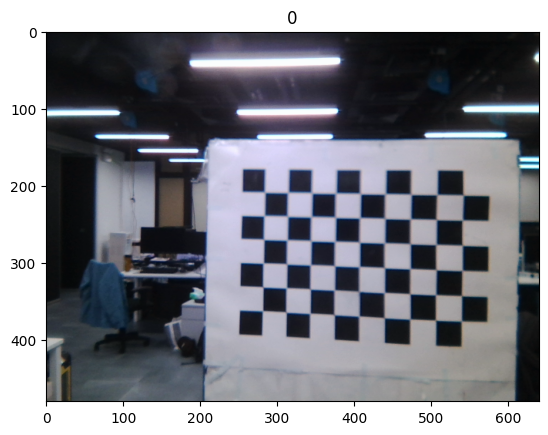

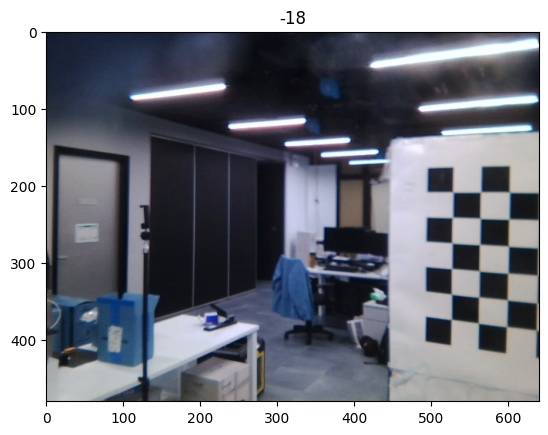

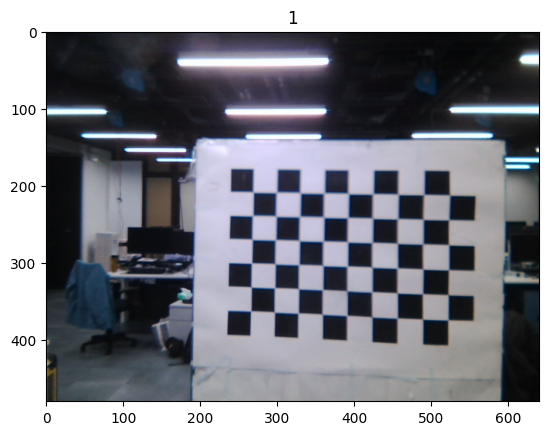

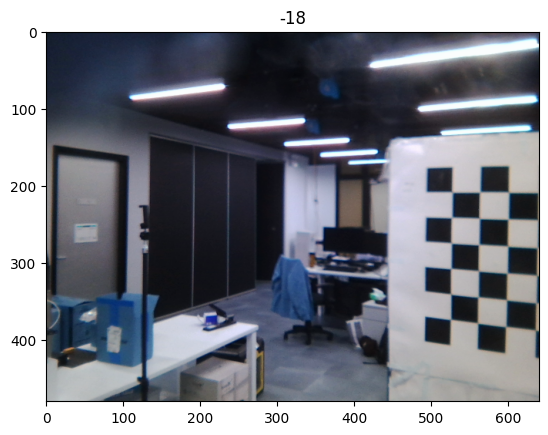

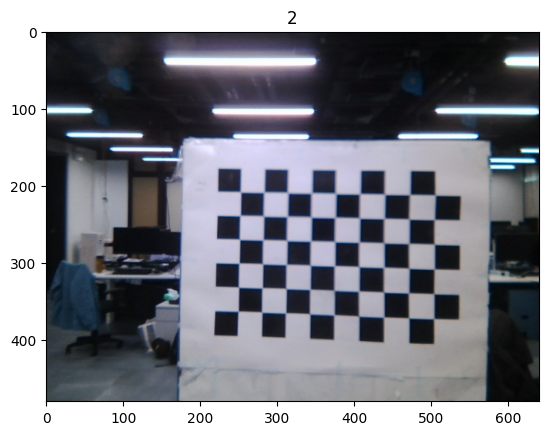

...

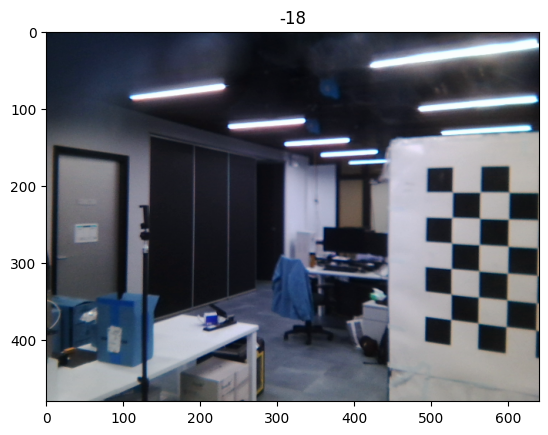

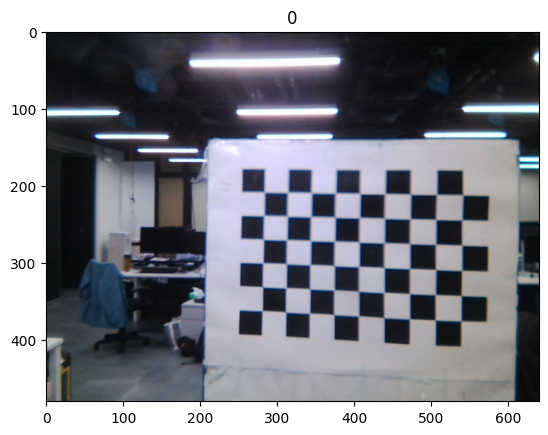

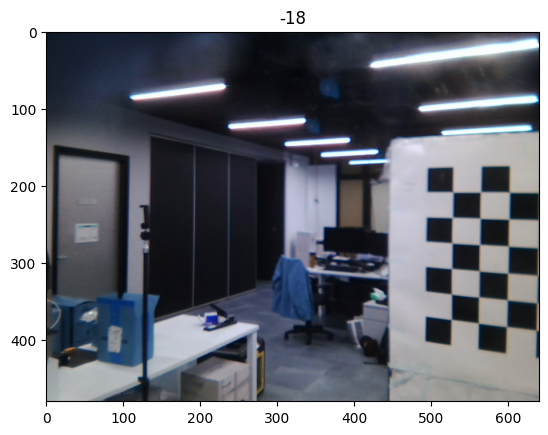

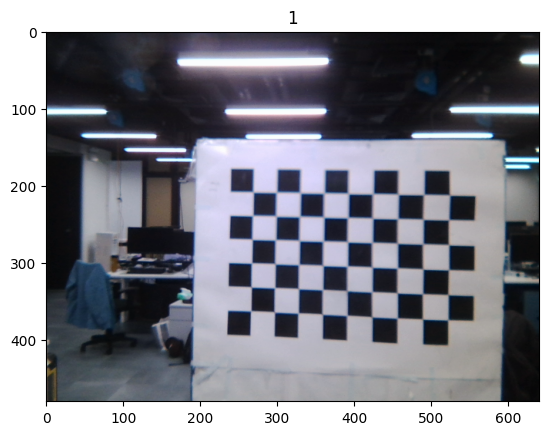

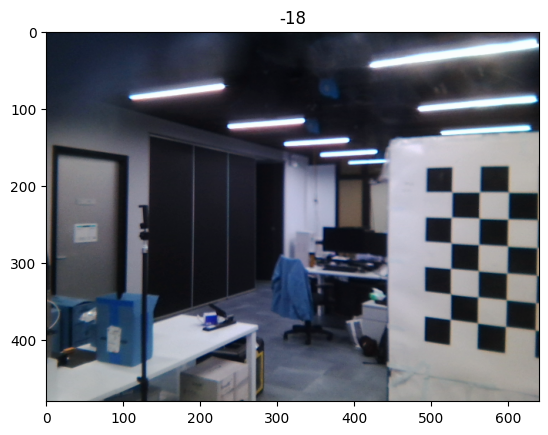

In [18]:
img_list = pickle_df['left_eye_img'].tolist()
for i in range(30):
    plt.figure()
    plt.imshow(img_list[i])
    plt.title(str(pickle_df['theta_left_pan_cmd_tminus1'][i]))

# Filtering

In [19]:
filt_df = pickle_df[(pickle_df['theta_left_pan_cmd_tminus1']>-13) & (pickle_df['theta_left_pan_cmd_tminus1']<13) ].reset_index(drop=True)
filt_df.head()

,chess_idx,theta_left_pan,theta_right_pan,theta_tilt,chest_cam_px_x_tminus1,chest_cam_px_y_tminus1,left_eye_px_x_tminus1,left_eye_px_y_tminus1,right_eye_px_x_tminus1,right_eye_px_y_tminus1,...,theta_tilt_tminus1,plan_phi_left_pan_tminus2,plan_phi_right_pan_tminus2,plan_phi_tilt_tminus2,plan_phi_left_pan_tminus1,plan_phi_right_pan_tminus1,plan_phi_tilt_tminus1,phi_direction_left_pan,phi_direction_right_pan,phi_direction_tilt
0,4,-0.439453,-11.689453,0.263672,374.414001,82.588356,345.086884,210.130737,342.594421,221.538406,...,0.263672,-0.191229,-0.258835,-0.045053,-0.077717,-0.138835,-0.008162,1,1,1
1,8,0.527344,-10.634766,0.263672,504.468689,80.883873,457.309296,211.922394,452.888855,225.842072,...,0.263672,0.041399,-0.020434,-0.006353,0.155831,0.094958,-0.004544,3,3,3
2,4,1.494141,-9.667969,0.263672,504.454498,80.909485,439.733765,211.911316,432.642273,225.656754,...,0.263672,0.272865,0.206433,-0.036638,0.155831,0.094958,-0.004544,2,2,1
3,0,2.548828,-8.701172,0.263672,374.422882,82.572838,297.115875,209.764938,288.430573,220.642685,...,0.263672,0.041399,-0.020434,-0.006353,-0.077717,-0.138835,-0.008162,0,0,0
4,4,3.427734,-7.734375,0.263672,374.414337,82.587730,282.446960,209.609833,270.950470,220.320724,...,0.263672,-0.191072,-0.259080,-0.046732,-0.077717,-0.138835,-0.008162,1,1,1


In [20]:
print(filt_df['theta_left_pan_cmd_tminus1'].unique())
print(filt_df['theta_right_pan_cmd_tminus1'].unique())
print(filt_df['theta_tilt_cmd_tminus1'].unique())

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]
[-12 -11 -10  -9  -8  -7  -6  -5  -4  -3  -2  -1   0]
[  0  -5 -10 -15 -20 -25 -30]


# Extrinsic Matrix

## Initialization

In [21]:
calib_params = load_json('config/calib/calib_params.json')
camera_mtx = load_json("config/camera/camera_mtx.json")

In [22]:
left_eye_camera_mtx = np.array(camera_mtx['left_eye']['camera_matrix'])
left_eye_dist_coef = np.array(camera_mtx['left_eye']['distortion_coefficients']).squeeze()
right_eye_camera_mtx = np.array(camera_mtx['right_eye']['camera_matrix'])
right_eye_dist_coef = np.array(camera_mtx['right_eye']['distortion_coefficients']).squeeze()
chest_cam_camera_mtx = np.array(camera_mtx['chest_cam']['camera_matrix'])
chest_cam_dist_coef = np.array(camera_mtx['chest_cam']['distortion_coefficients']).squeeze()

In [23]:
# Example

chest_img = filt_df['chest_img'][0]
depth_img = filt_df['depth_img'][0]

In [24]:
# Get Chess Corners

corners = get_chess_corners(chest_img, chest_cam_camera_mtx, chest_cam_dist_coef)

In [25]:
# Define the 3D coordinates of the chessboard corners in the world coordinate system
chessboard_size = (9, 6)
origin_point = [0,0]
square_size = 0.0467  # Assumiimgng each square size is 1 unit
obj_pts = np.zeros((chessboard_size[0] * chessboard_size[1], 3), np.float32)
obj_pts[:,:2] = (np.mgrid[0:chessboard_size[0], 0:chessboard_size[1]].T.reshape(-1, 2) -np.array(origin_point))* square_size

(300.0, 40.0)

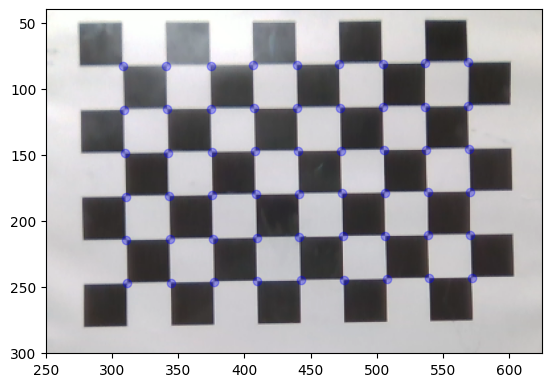

In [26]:
plt.figure()
plt.imshow(chest_img)
for u,v in corners:
    plt.scatter(u,v, color='blue',alpha=0.3)
plt.xlim([250, 625])
plt.ylim([300, 40])

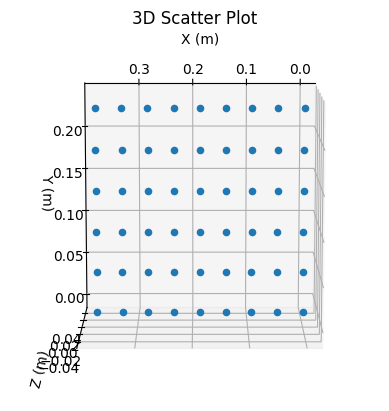

In [27]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create a figure and an axes object
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot the 3D points
for x,y,z in obj_pts:
    ax.scatter(x, y, z, color=colors[0])

# Set labels and title
ax.set_xlabel('X (m)')
ax.set_ylabel('Y (m)')
ax.set_zlabel('Z (m)')
ax.set_title('3D Scatter Plot')
#ax.set_zlim([-0.2,1.7])
ax.view_init(elev=-80, azim=90)

# Show the plot
plt.show()

# Extrinsic Transformation (Left)

In [28]:
# Chest Image

T_chest = get_camera_pose(chest_img, obj_pts, chest_cam_camera_mtx, chest_cam_dist_coef)

In [29]:
# Looping: Left Eye Image

img_list = filt_df['left_eye_img'].tolist()
T_left_list = []
for img in img_list:
    T_left_list.append(get_camera_pose(img, obj_pts, left_eye_camera_mtx, left_eye_dist_coef))

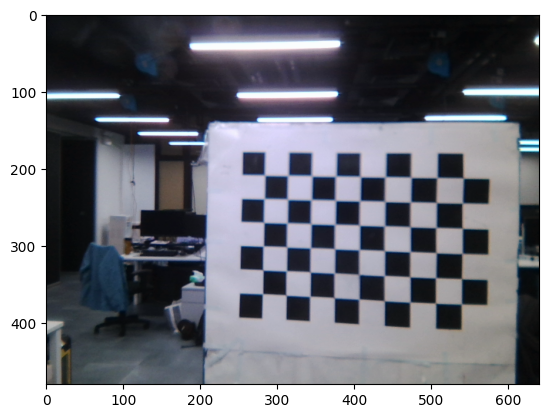

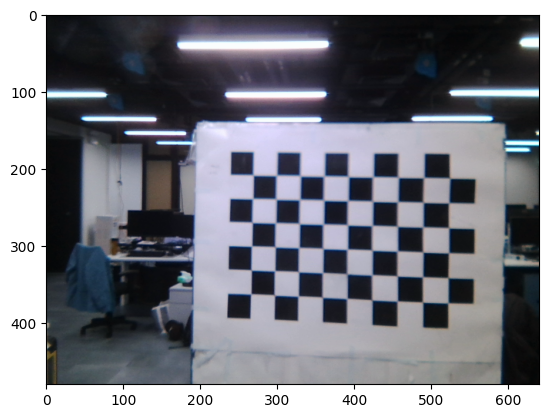

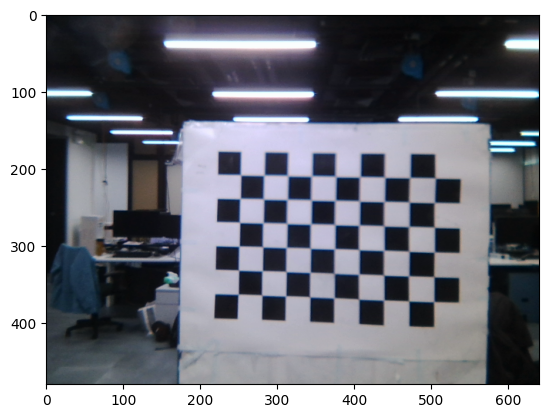

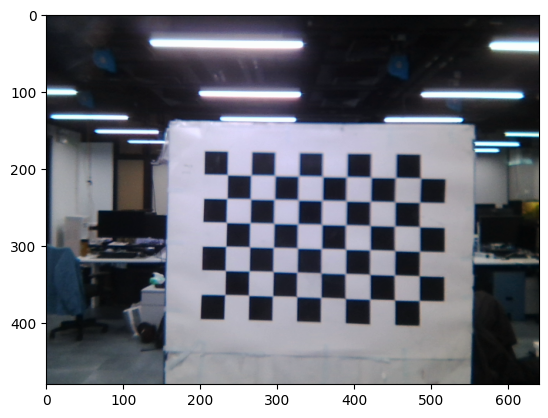

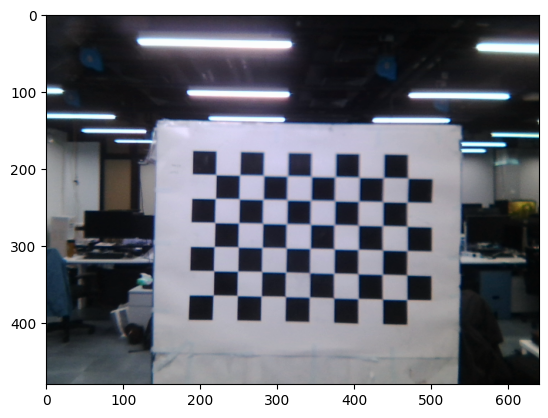

...

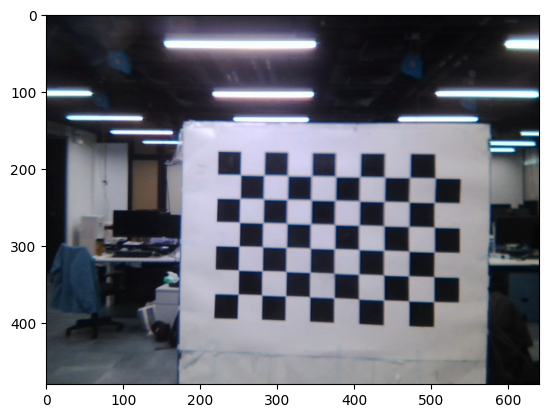

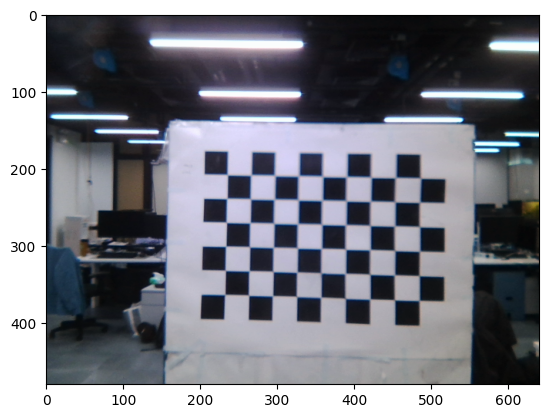

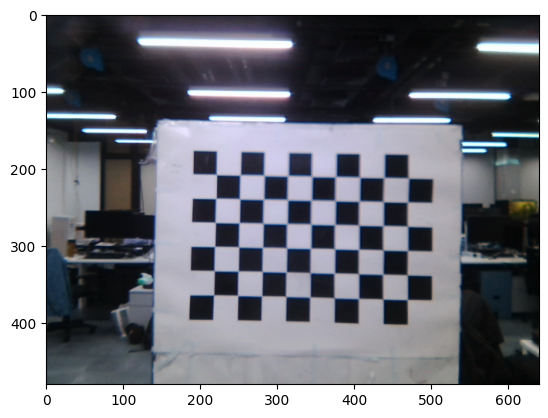

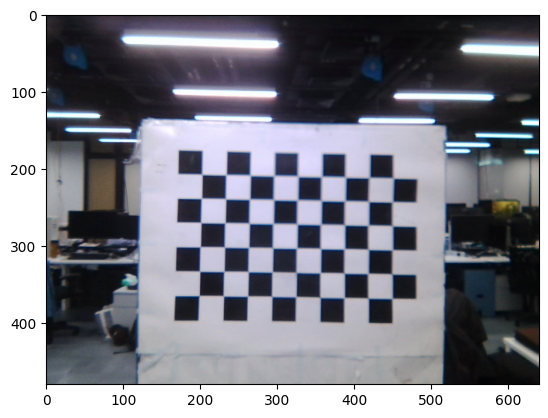

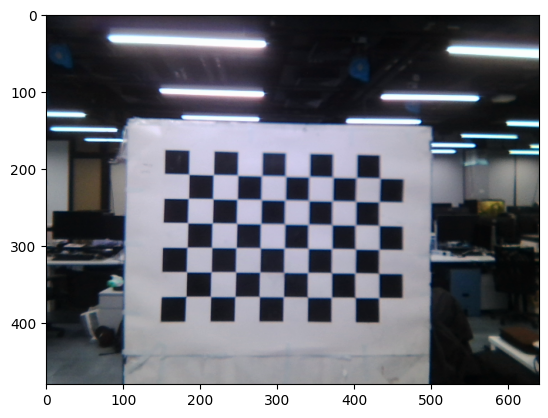

In [30]:
img_list = filt_df['left_eye_img'].tolist()
for i in range(20):
    plt.figure()
    plt.imshow(img_list[i])

In [31]:
%matplotlib widget

(-0.2, 2.0)

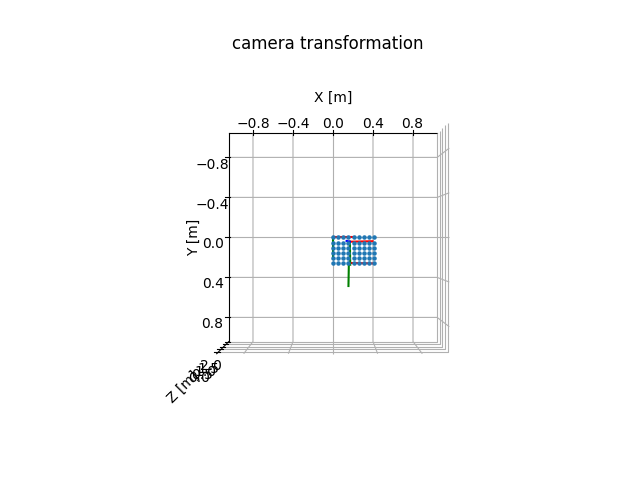

In [32]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest[:3,:3], T_chest[:3,-1], s=0.2)
    
# Plot Left Poses
for T in [T_left_list[0]]:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=0.2)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [33]:
T_left_list[0]

array([[ 0.99052375,  0.01559538, -0.13645321,  0.14641329],
       [-0.02029706,  0.99924483, -0.03313311,  0.03733153],
       [ 0.13583344,  0.03558873,  0.99009228, -0.85528347],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [34]:
T_chest

array([[ 0.99940299, -0.01758478,  0.02973951,  0.13768625],
       [ 0.01735353,  0.99981728,  0.00801629,  0.22184111],
       [-0.02987505, -0.00749542,  0.99952554, -0.86118787],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [35]:
# Compute inverse of P1
P1_inv = np.linalg.inv(T_chest)

# Compute the relative transformation between P1 and P2
P_rel = np.matmul(P1_inv, T_left_list[0])

print(P_rel)

[[ 0.98552215  0.03186328 -0.16652577  0.00534355]
 [-0.03872962  0.99852125 -0.03814871 -0.18467359]
 [ 0.16506398  0.04404588  0.98529886  0.00468206]
 [ 0.          0.          0.          1.        ]]


## Multiple Poses

(-0.2, 2.0)

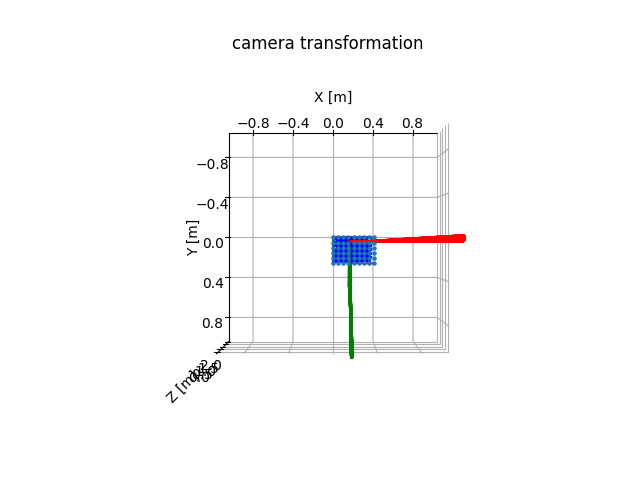

In [36]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest[:3,:3], T_chest[:3,-1], s=0.2)
    
# Plot Left Poses
for T in T_left_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

# Chess Point Location Transformation (Chess World -> Chest)

In [37]:
# Transformation for the shifting of the center

T_chest_cam_ctr = np.eye(4)
T_chest_cam_ctr[0, -1] = -0.0325  # chest rgb to module center, 32.5 mm
T_chest_cam_ctr

array([[ 1.    ,  0.    ,  0.    , -0.0325],
       [ 0.    ,  1.    ,  0.    ,  0.    ],
       [ 0.    ,  0.    ,  1.    ,  0.    ],
       [ 0.    ,  0.    ,  0.    ,  1.    ]])

In [38]:
orig_obj_pts = copy.deepcopy(obj_pts)
orig_obj_pts

array([[0.    , 0.    , 0.    ],
       [0.0467, 0.    , 0.    ],
       [0.0934, 0.    , 0.    ],
       [0.1401, 0.    , 0.    ],
       [0.1868, 0.    , 0.    ],
       [0.2335, 0.    , 0.    ],
       [0.2802, 0.    , 0.    ],
       [0.3269, 0.    , 0.    ],
       [0.3736, 0.    , 0.    ],
       [0.    , 0.0467, 0.    ],
       [0.0467, 0.0467, 0.    ],
       [0.0934, 0.0467, 0.    ],
       [0.1401, 0.0467, 0.    ],
       [0.1868, 0.0467, 0.    ],
       [0.2335, 0.0467, 0.    ],
       [0.2802, 0.0467, 0.    ],
       [0.3269, 0.0467, 0.    ],
       [0.3736, 0.0467, 0.    ],
       [0.    , 0.0934, 0.    ],
       [0.0467, 0.0934, 0.    ],
       [0.0934, 0.0934, 0.    ],
       [0.1401, 0.0934, 0.    ],
       [0.1868, 0.0934, 0.    ],
       [0.2335, 0.0934, 0.    ],
       [0.2802, 0.0934, 0.    ],
       [0.3269, 0.0934, 0.    ],
       [0.3736, 0.0934, 0.    ],
       [0.    , 0.1401, 0.    ],
       [0.0467, 0.1401, 0.    ],
       [0.0934, 0.1401, 0.    ],
       [0.

In [39]:
T_chest

array([[ 0.99940299, -0.01758478,  0.02973951,  0.13768625],
       [ 0.01735353,  0.99981728,  0.00801629,  0.22184111],
       [-0.02987505, -0.00749542,  0.99952554, -0.86118787],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [40]:
T_chest_inv = np.linalg.inv(T_chest)
T_chest_inv

array([[ 0.99940299,  0.01735353, -0.02987505, -0.1671818 ],
       [-0.01758478,  0.99981728, -0.00749542, -0.22583436],
       [ 0.02973951,  0.00801629,  0.99952554,  0.8549062 ],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [41]:
final_obj_pts = transform_points(orig_obj_pts, T_chest_inv)
final_obj_pts = transform_points(final_obj_pts, T_chest_cam_ctr)
final_obj_pts

array([[-0.1996818 , -0.22583436,  0.8549062 ],
       [-0.15300968, -0.22665557,  0.85629504],
       [-0.10633756, -0.22747678,  0.85768387],
       [-0.05966544, -0.22829799,  0.85907271],
       [-0.01299332, -0.2291192 ,  0.86046155],
       [ 0.0336788 , -0.22994041,  0.86185038],
       [ 0.08035092, -0.23076162,  0.86323922],
       [ 0.12702304, -0.23158282,  0.86462805],
       [ 0.17369516, -0.23240403,  0.86601689],
       [-0.19887139, -0.17914289,  0.85528056],
       [-0.15219927, -0.1799641 ,  0.8566694 ],
       [-0.10552715, -0.18078531,  0.85805824],
       [-0.05885503, -0.18160652,  0.85944707],
       [-0.01218291, -0.18242773,  0.86083591],
       [ 0.03448921, -0.18324894,  0.86222474],
       [ 0.08116133, -0.18407015,  0.86361358],
       [ 0.12783345, -0.18489136,  0.86500241],
       [ 0.17450557, -0.18571257,  0.86639125],
       [-0.19806098, -0.13245142,  0.85565493],
       [-0.15138886, -0.13327263,  0.85704376],
       [-0.10471674, -0.13409384,  0.858

(-0.2, 2.0)

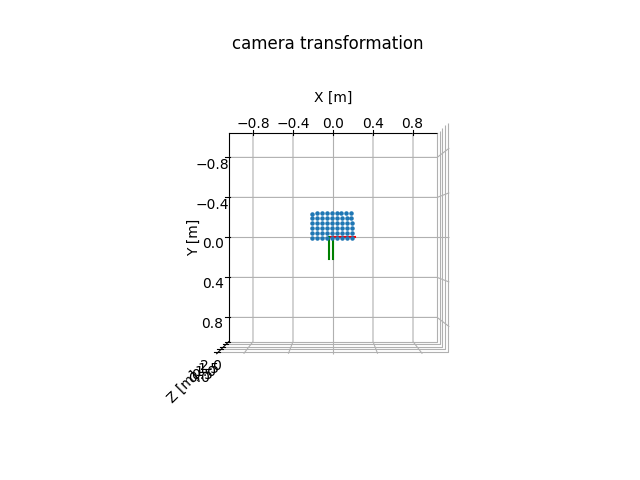

In [42]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [43]:
# Get Depth Object Points

depth_obj_pts = get_chess_obj_pts(chest_img, depth_img, chest_cam_camera_mtx, chest_cam_dist_coef)

(-0.2, 2.0)

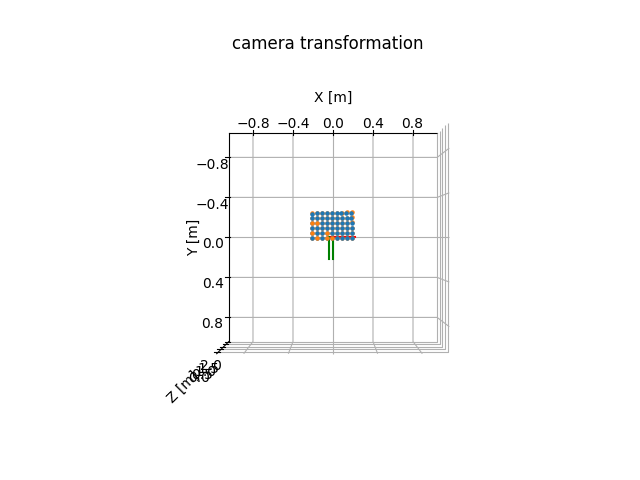

In [44]:
# Plotting the Depth Image Points

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot 3D Depth Chess Points
for x,y,z in depth_obj_pts:
    ax.scatter(x-0.0325, y, z-0.0042, color=colors[1], marker='.')  # The 3d depth camera is still chest rgb

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

Subtracted 32.5 mm in x for the color camera. Subtracted 11.5 mm in x, added 10 mm in y, and subtracted 4.2 mm in z for the depth camera. The y compensation accounts for the transformation from depth to eye camera

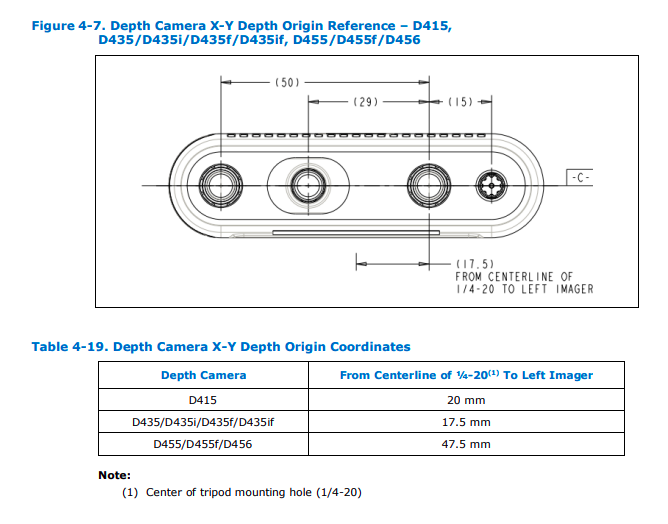

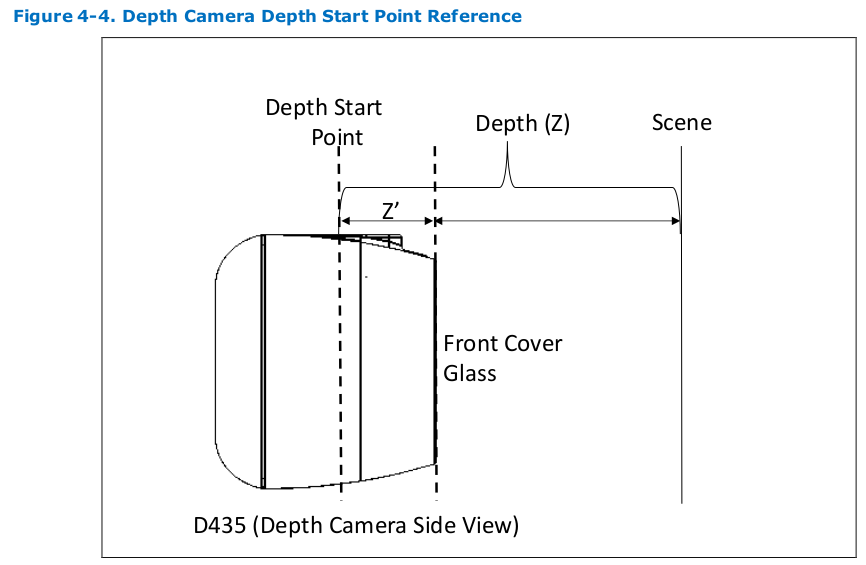
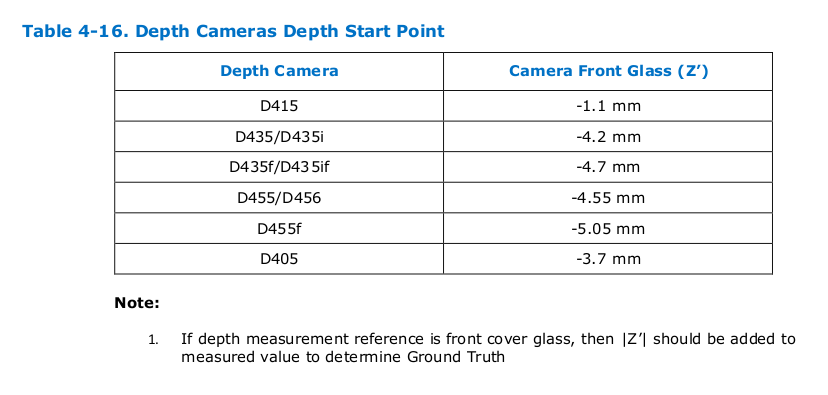

# Left Eye Transformation to Realsense Module Center

In [45]:
T_chest

array([[ 0.99940299, -0.01758478,  0.02973951,  0.13768625],
       [ 0.01735353,  0.99981728,  0.00801629,  0.22184111],
       [-0.02987505, -0.00749542,  0.99952554, -0.86118787],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [46]:
T_chest_cam_ctr

array([[ 1.    ,  0.    ,  0.    , -0.0325],
       [ 0.    ,  1.    ,  0.    ,  0.    ],
       [ 0.    ,  0.    ,  1.    ,  0.    ],
       [ 0.    ,  0.    ,  0.    ,  1.    ]])

In [47]:
# Compute the relative transformation 

P1_inv = np.linalg.inv(T_chest)
T_rel = np.matmul(P1_inv, T_left_list[0])
T_final = np.matmul(T_chest_cam_ctr, T_rel)

print(T_rel)
print(T_final)

[[ 0.98552215  0.03186328 -0.16652577  0.00534355]
 [-0.03872962  0.99852125 -0.03814871 -0.18467359]
 [ 0.16506398  0.04404588  0.98529886  0.00468206]
 [ 0.          0.          0.          1.        ]]
[[ 0.98552215  0.03186328 -0.16652577 -0.02715645]
 [-0.03872962  0.99852125 -0.03814871 -0.18467359]
 [ 0.16506398  0.04404588  0.98529886  0.00468206]
 [ 0.          0.          0.          1.        ]]


(-0.2, 2.0)

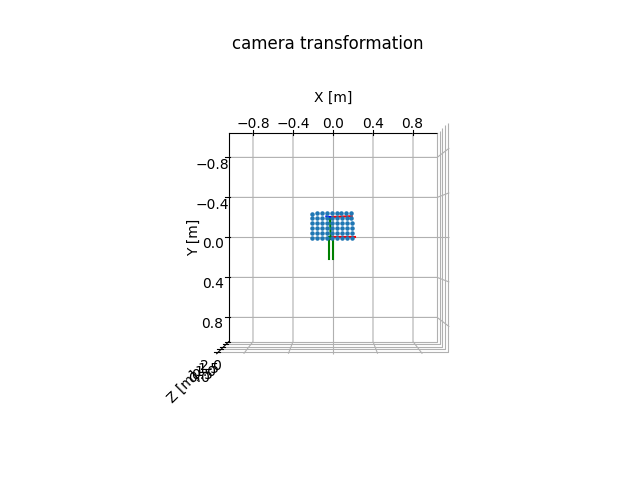

In [48]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)
  
# Plot Left Eye
ax = pr.plot_basis(ax, T_final[:3,:3], T_final[:3,-1], s=0.2)


ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [49]:
pickle_df[:18]['theta_left_pan_cmd_tminus1']

0      0
1    -18
2      1
3    -18
4      2
5    -18
6      3
7    -18
8      4
9    -18
10     5
11   -18
12     6
13   -18
14     7
15   -18
16     8
17   -18
Name: theta_left_pan_cmd_tminus1, dtype: int64

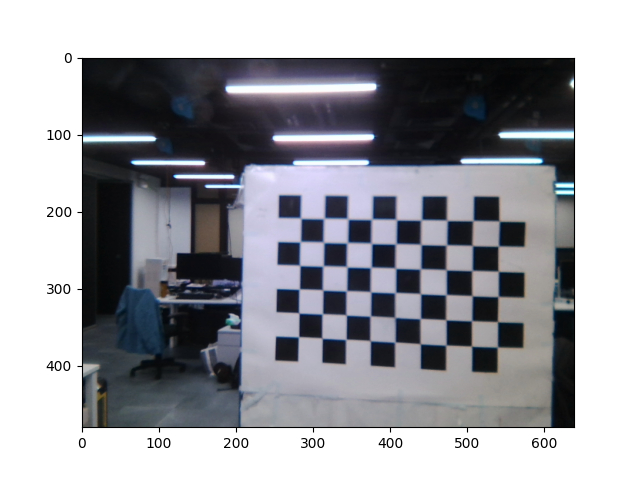

In [50]:
plt.figure()
plt.imshow(pickle_df['left_eye_img'][0])

In [51]:
filt_df[:18]['theta_left_pan_cmd_tminus1']

0      0
1      1
2      2
3      3
4      4
5      5
6      6
7      7
8      8
9      9
10    10
11    11
12    12
13     0
14     1
15     2
16     3
17     4
Name: theta_left_pan_cmd_tminus1, dtype: int64

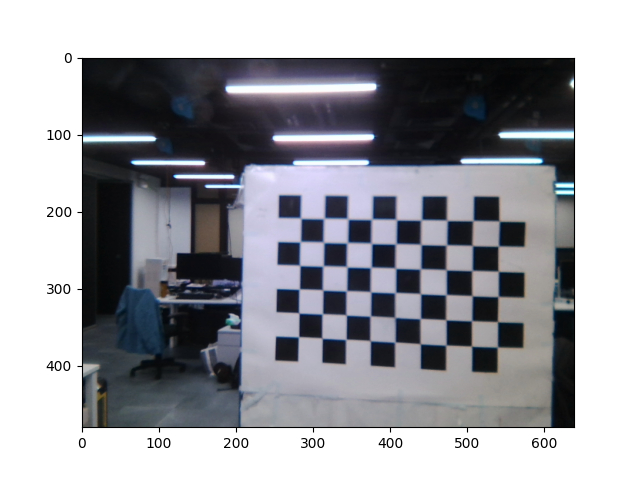

In [52]:
plt.figure()
plt.imshow(img_list[0])

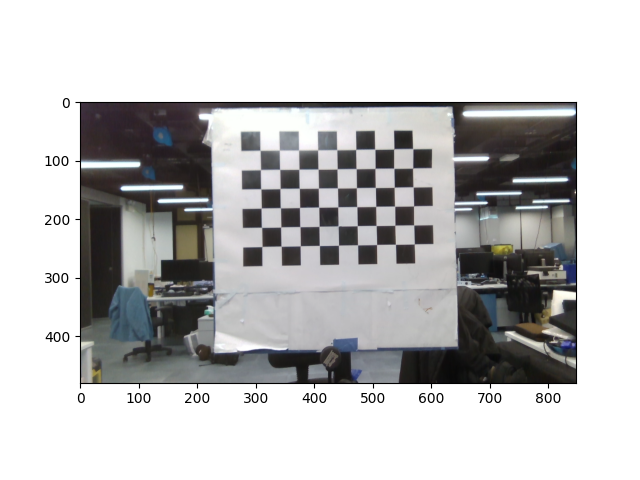

In [53]:
plt.figure()
plt.imshow(chest_img)

In [54]:
# Function Prototype:

def left_eye_to_origin(T_input):
    T_chest_inv = np.linalg.inv(T_chest)
    T_rel = np.matmul(T_chest_inv, T_input)
    T_final = np.matmul(T_chest_cam_ctr, T_rel)
    return T_final

In [55]:
# Final Left Eye List

T_left_final_list = []
for T_left in T_left_list:
    T_left_final_list.append(left_eye_to_origin(T_left))

(-0.2, 2.0)

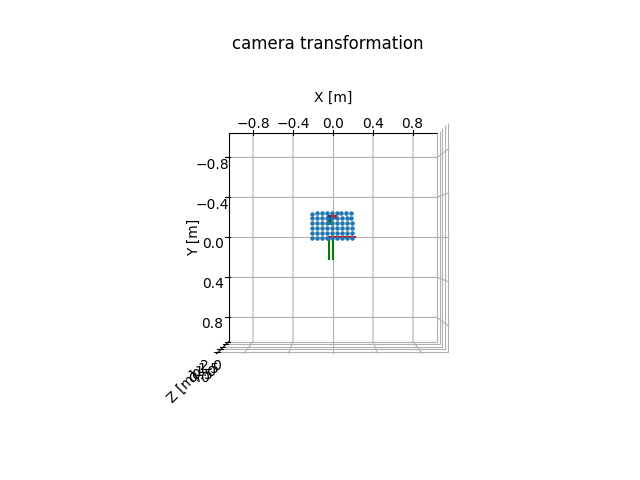

In [56]:
# Transformed Left Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Left Poses
for T in T_left_final_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=0.05)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

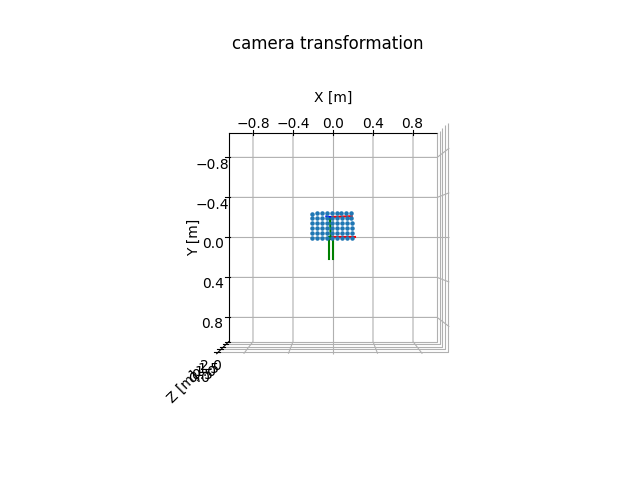

In [57]:
# Transformed Left Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Left Poses
for T in T_left_final_list[:1]:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=0.2)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

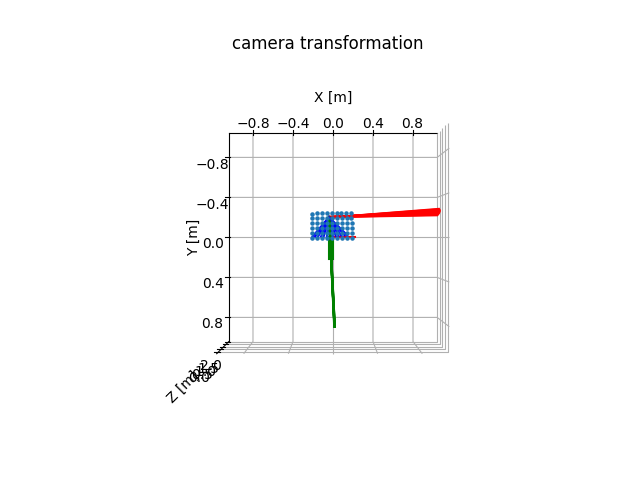

In [58]:
# Transformed Left Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Left Poses
for T in T_left_final_list[-13:]:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

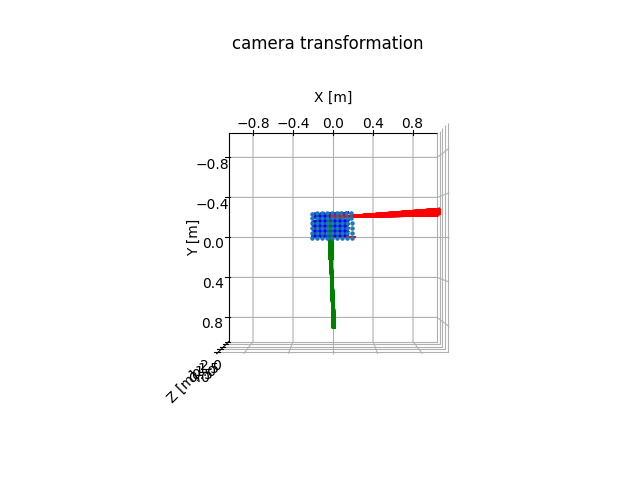

In [59]:
# Transformed Left Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Left Poses
for T in T_left_final_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

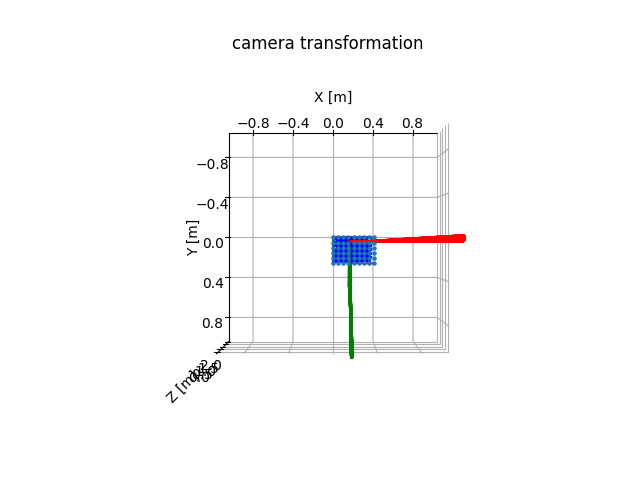

In [60]:
# Original Chessboard Origin Coordinate System

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest[:3,:3], T_chest[:3,-1], s=0.2)
    
# Plot Left Poses
for T in T_left_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [61]:
filt_df['T_left_eye'] = T_left_final_list

# Calculation of Roll, Pitch, Yaw

In [62]:
rmat = T_left_final_list[0][:3,:3]

In [63]:
angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
print(angles)

(2.5595928241681207, -9.500951216601392, -2.2504848896322303)


In [64]:
angle_list = []
for i in range(14):
    rmat = T_left_final_list[i][:3,:3]
    angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
    angle_list.append(angles)
angle_arr = np.array(angle_list)

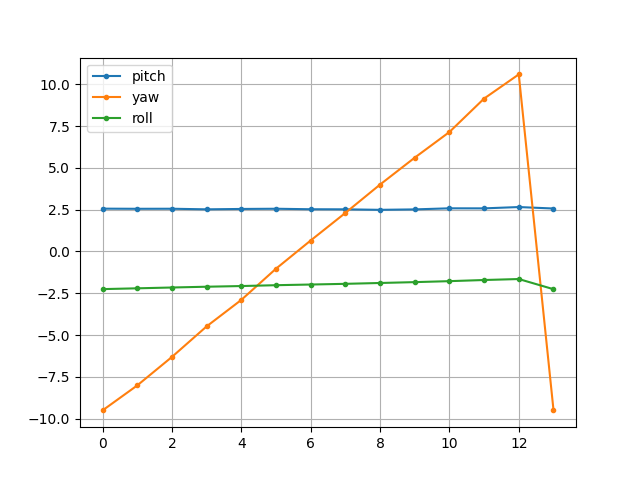

In [65]:
plt.figure()
plt.plot(angle_arr[:,0], marker='.')
plt.plot(angle_arr[:,1], marker='.')
plt.plot(angle_arr[:,2], marker='.')
plt.legend(['pitch', 'yaw', 'roll'])  # Rotation across x, y, z [but currently in opencv coordinates -> different]
plt.grid()

In [66]:
angle_list

[(2.5595928241681207, -9.500951216601392, -2.2504848896322303),
 (2.5513360701565406, -8.008747275512508, -2.2029807683191605),
 (2.5542074497696414, -6.306108626067818, -2.1540502423659444),
 (2.5190470347212037, -4.479758493690717, -2.107540590017579),
 (2.5414743647051314, -2.896415758917402, -2.0670397820896214),
 (2.5539591018200634, -1.0312093171857832, -2.0163932751976286),
 (2.5239895205185903, 0.6548620145115267, -1.9764344744233953),
 (2.519239465120592, 2.303525963937522, -1.9346017131184021),
 (2.4891509821292077, 3.9980486065988075, -1.8840713355518985),
 (2.515375177599263, 5.607519691665202, -1.8327976232353191),
 (2.579698226583375, 7.139985587164849, -1.7746940223758871),
 (2.576586061055867, 9.140306632473973, -1.7064536457288237),
 (2.6554334005782723, 10.58517612396226, -1.6478919980799218),
 (2.568094517407126, -9.456196388542153, -2.254602702588851)]

## Filter

In [67]:
angle_list = []
df = filt_df[filt_df['theta_left_pan_cmd_tminus1']==0.0].reset_index()
for i in range(len(df)):
    rmat = df['T_left_eye'][i][:3,:3]
    angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
    angle_list.append(angles)
angle_arr = np.array(angle_list)

In [68]:
angle_arr

array([[  2.55959282,  -9.50095122,  -2.25048489],
       [  2.56809452,  -9.45619639,  -2.2546027 ],
       [  2.53807048,  -9.43696064,  -2.25394451],
       [  2.51230812,  -9.45040659,  -2.25607959],
       [  2.50289796,  -9.3886633 ,  -2.25426222],
       [  2.54908513,  -9.43371117,  -2.27054495],
       [  2.56618344,  -9.445051  ,  -2.273319  ],
       [  2.56074963,  -9.34925697,  -2.27023592],
       [  2.54406478,  -9.48866717,  -2.27026578],
       [  2.55920726,  -9.35942649,  -2.27414831],
       [  0.2923784 ,  -9.34263346,  -2.04952625],
       [  0.34027273,  -9.29937743,  -2.06683844],
       [  0.30334825,  -9.34305502,  -2.05747184],
       [  0.30284462,  -9.28844422,  -2.0614236 ],
       [  0.31386901,  -9.3382334 ,  -2.06123176],
       [  0.31761399,  -9.31122829,  -2.06622887],
       [  0.29664121,  -9.29775152,  -2.06608153],
       [  0.28701597,  -9.31956548,  -2.06593036],
       [  0.30359111,  -9.34285218,  -2.06433525],
       [  0.26679297,  -9.34943

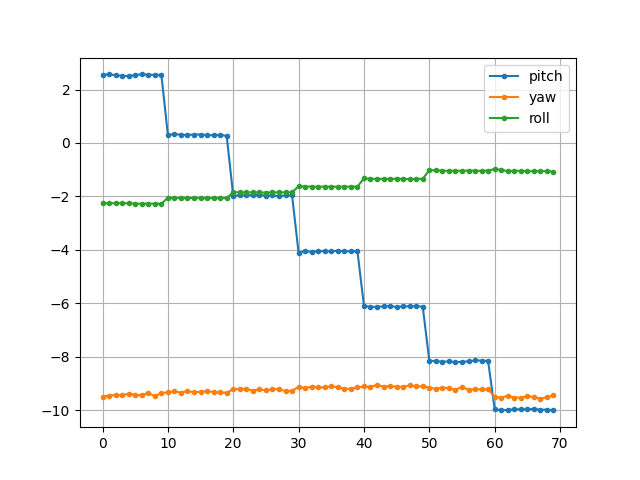

In [69]:
plt.figure()
plt.plot(angle_arr[:,0], marker='.')  # Left hand coordinate, clockwise is positive
plt.plot(angle_arr[:,1], marker='.')
plt.plot(angle_arr[:,2], marker='.')
plt.legend(['pitch', 'yaw', 'roll'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.grid()

## Scatter Plot All

In [70]:
pitch_list = []
yaw_list = []
roll_list = []
for i in range(len(filt_df)):
    rmat = filt_df['T_left_eye'][i][:3,:3]
    angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
    pitch_list.append(angles[0])
    yaw_list.append(angles[1])
    roll_list.append(angles[2])
filt_df['pitch'] = pitch_list
filt_df['yaw'] = yaw_list
filt_df['roll'] = roll_list

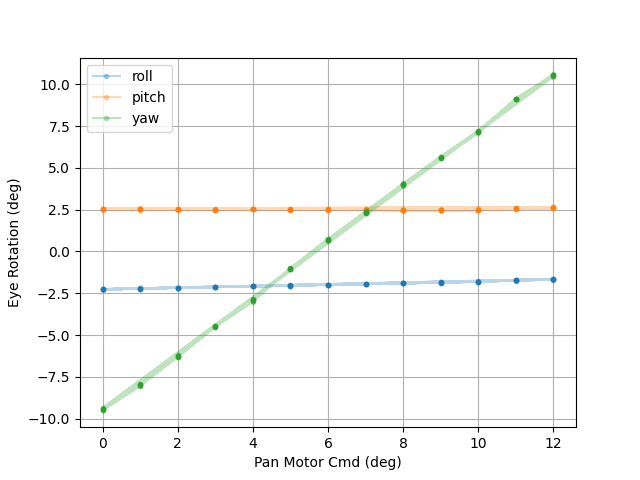

In [71]:
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==0.0].reset_index()
plt.figure()
plt.plot(df['theta_left_pan_cmd_tminus1'], df['roll'], alpha=0.3, marker='.')
plt.plot(df['theta_left_pan_cmd_tminus1'], df['pitch'], alpha=0.3, marker='.')
plt.plot(df['theta_left_pan_cmd_tminus1'], df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Pan Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

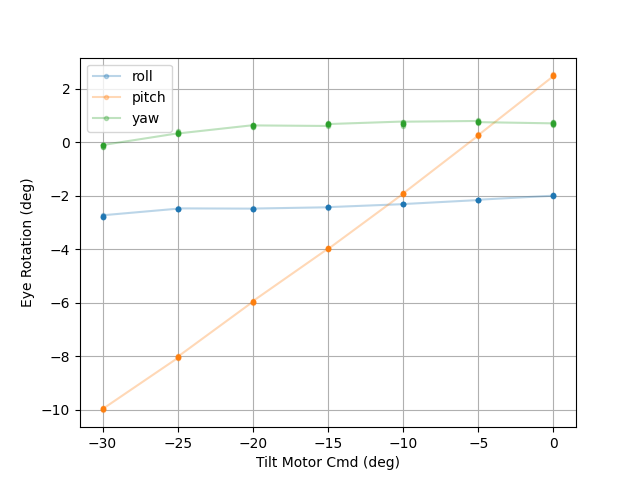

In [72]:
df = filt_df[filt_df['theta_left_pan_cmd_tminus1']==6].reset_index()
plt.figure()
plt.plot(df['theta_tilt_cmd_tminus1'], df['roll'], alpha=0.3, marker='.')
plt.plot(df['theta_tilt_cmd_tminus1'], df['pitch'], alpha=0.3, marker='.')
plt.plot(df['theta_tilt_cmd_tminus1'], df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

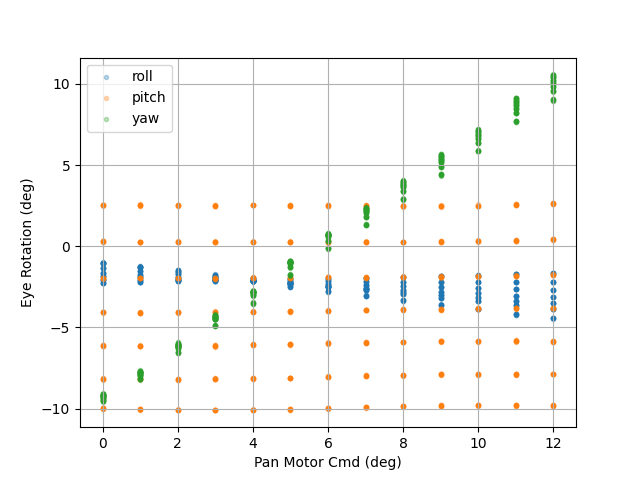

In [73]:
plt.figure()
plt.scatter(filt_df['theta_left_pan_cmd_tminus1'], filt_df['roll'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_left_pan_cmd_tminus1'], filt_df['pitch'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_left_pan_cmd_tminus1'], filt_df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Pan Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

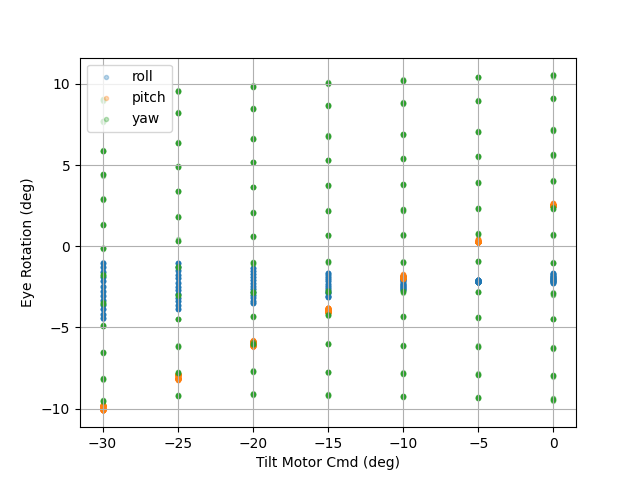

In [74]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['roll'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['pitch'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

# Pan Slope Plot

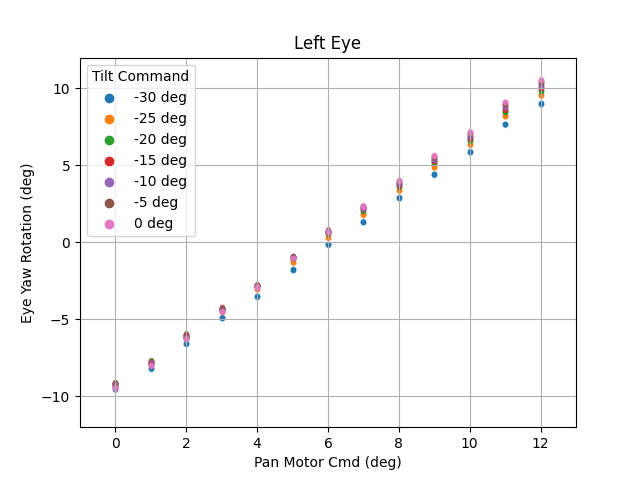

In [75]:
# Pan Slope

plt.figure()

tilt_cmd_list = list(range(-30, 1, 5))
for i in range(len(tilt_cmd_list)):
    plt.scatter(-100,-100, color=colors[i])

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    plt.scatter(df['theta_left_pan_cmd_tminus1'], df['yaw'], alpha=0.3, marker='.', color=colors[i])

# plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Pan Motor Cmd (deg)')
plt.ylabel('Eye Yaw Rotation (deg)')
plt.xlim([-1, 13])
plt.ylim([-12, 12])
plt.grid()
plt.title('Left Eye')
plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command')

## Slope Calculation

In [76]:
from sklearn.linear_model import LinearRegression

In [77]:
# Example
X = np.array([[1, 1], [1, 2], [2, 2], [2, 3]])
y = np.dot(X, np.array([1, 2])) + 3
reg = LinearRegression().fit(X, y)
print(reg.score(X, y))
print(reg.coef_)
print(reg.intercept_)
print(reg.predict(np.array([[3, 5]])))

1.0
[1. 2.]
3.0000000000000018
[16.]


In [78]:
score_list = []
coef_list = []
intercept_list = []
for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    X = df['theta_left_pan_cmd_tminus1'].values.reshape(-1,1)
    y = df['yaw'].values.reshape(-1,1)
    reg = LinearRegression().fit(X, y)
    score_list.append(reg.score(X, y))
    coef_list.append(reg.coef_.squeeze())
    intercept_list.append(reg.intercept_)    

In [79]:
coef_list

[array(1.56031243),
 array(1.57516709),
 array(1.59228026),
 array(1.6113025),
 array(1.63562463),
 array(1.65999871),
 array(1.68359396)]

In [80]:
intercept_list

[array([-9.61085059]),
 array([-9.24052801]),
 array([-9.13030117]),
 array([-9.16310488]),
 array([-9.28882541]),
 array([-9.38044941]),
 array([-9.53093864])]

In [81]:
tilt_cmd_list

[-30, -25, -20, -15, -10, -5, 0]

/tmp/ipykernel_15506/3290491564.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


Text(0, 0.5, 'm_lpan (yaw/cmd)')

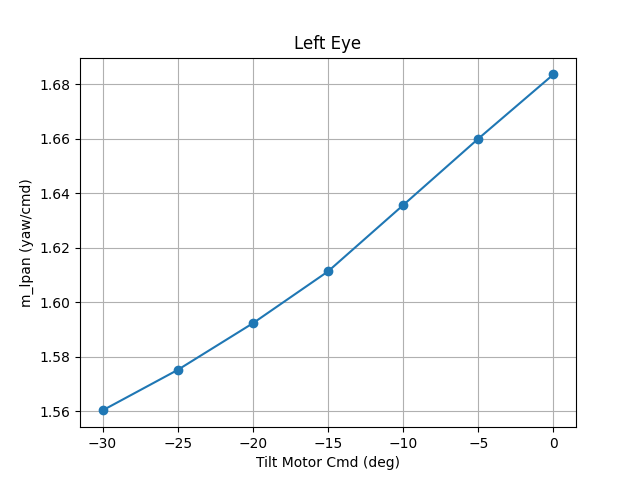

In [82]:
plt.figure()
plt.plot(tilt_cmd_list, coef_list, marker='o')
plt.title('Left Eye')
plt.grid()
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('m_lpan (yaw/cmd)')

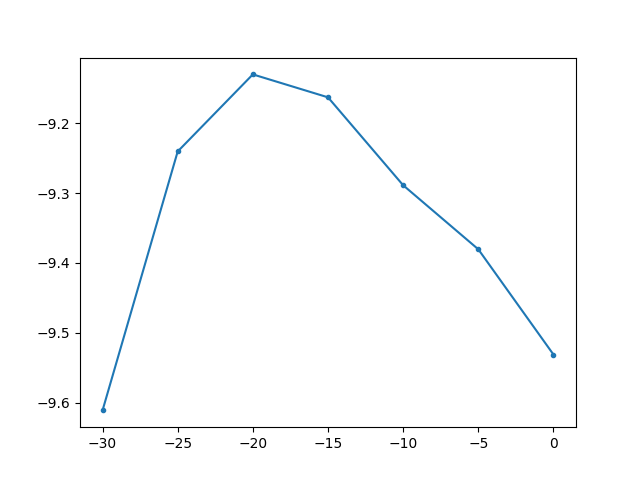

In [83]:
plt.figure()
plt.plot(tilt_cmd_list, intercept_list, marker='.')

# Tilt Slope Plot

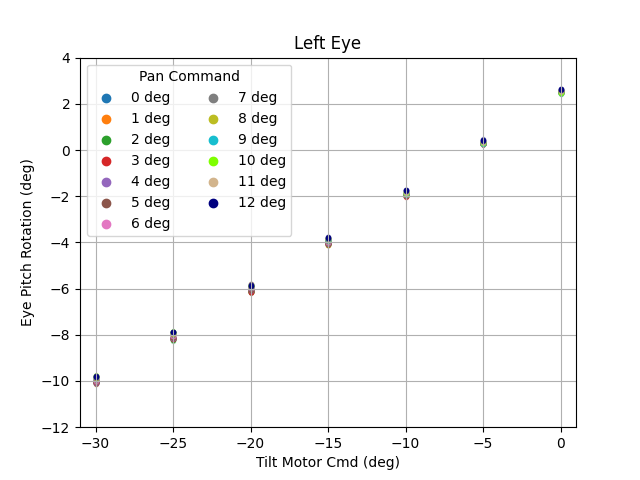

In [84]:
# Tilt Slope

plt.figure()

left_pan_cmd_list = list(range(0, 13))
for i in range(len(left_pan_cmd_list)):
    plt.scatter(-100,-100, color=colors[i])

for i in range(len(left_pan_cmd_list)):
    df = filt_df[filt_df['theta_left_pan_cmd_tminus1']==left_pan_cmd_list[i]].reset_index()
    plt.scatter(df['theta_tilt_cmd_tminus1'], df['pitch'], alpha=0.3, marker='.', color=colors[i])
    
# plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('Eye Pitch Rotation (deg)')
plt.xlim([-31, 1])
plt.ylim([-12, 4])
plt.title('Left Eye')
plt.legend(['0 deg', '1 deg', '2 deg', '3 deg', '4 deg', '5 deg', '6 deg',
           '7 deg', '8 deg', '9 deg', '10 deg', '11 deg', '12 deg'], title='Pan Command', ncol=2)
plt.grid()

## Slope Calculation

In [85]:
score_list = []
coef_list = []
intercept_list = []
for i in range(len(left_pan_cmd_list)):
    df = filt_df[filt_df['theta_left_pan_cmd_tminus1']==left_pan_cmd_list[i]].reset_index()
    X = df['theta_tilt_cmd_tminus1'].values.reshape(-1,1)
    y = df['pitch'].values.reshape(-1,1)
    reg = LinearRegression().fit(X, y)
    score_list.append(reg.score(X, y))
    coef_list.append(reg.coef_.squeeze())
    intercept_list.append(reg.intercept_)    

In [86]:
coef_list

[array(0.41921602),
 array(0.41996078),
 array(0.42092892),
 array(0.41968599),
 array(0.4200275),
 array(0.41820854),
 array(0.41500937),
 array(0.41212023),
 array(0.40996016),
 array(0.40835912),
 array(0.4090691),
 array(0.4113362),
 array(0.41441629)]

In [87]:
intercept_list

[array([2.36674039]),
 array([2.35675469]),
 array([2.36426708]),
 array([2.34725073]),
 array([2.38246082]),
 array([2.36317132]),
 array([2.35289562]),
 array([2.33725053]),
 array([2.33296633]),
 array([2.32894155]),
 array([2.3674858]),
 array([2.42429064]),
 array([2.49643849])]

In [88]:
left_pan_cmd_list

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

(0.0, 1.0)

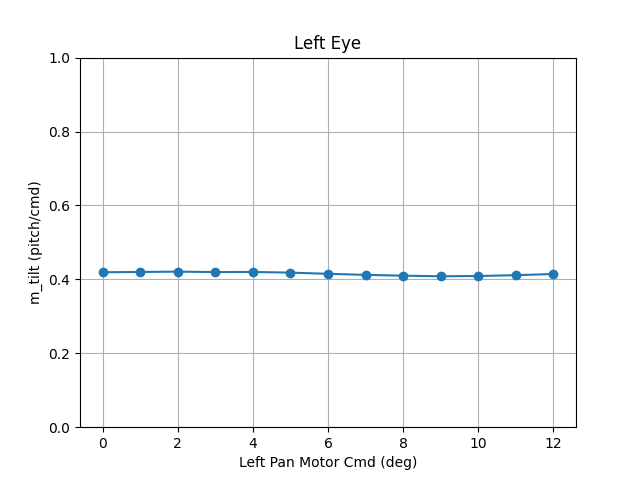

In [89]:
plt.figure()
plt.plot(left_pan_cmd_list, coef_list, marker='o')
plt.title('Left Eye')
plt.grid()
plt.xlabel('Left Pan Motor Cmd (deg)')
plt.ylabel('m_tilt (pitch/cmd)')
plt.ylim([0,1])

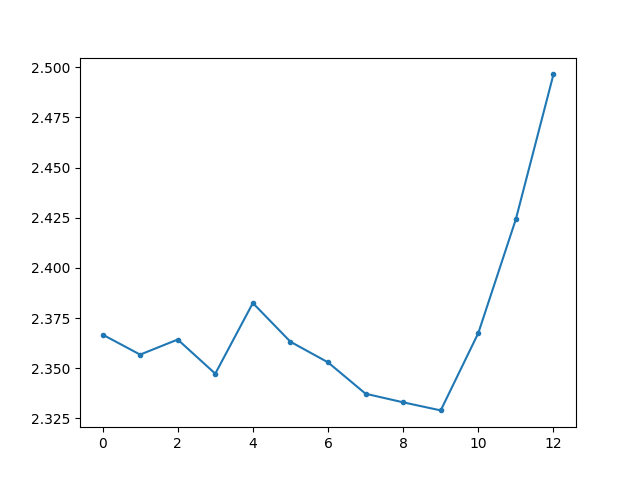

In [90]:
plt.figure()
plt.plot(left_pan_cmd_list, intercept_list, marker='.')

In [91]:
np.mean(coef_list)

0.4152537078639283

# Translation

In [92]:
t_x_list = []
t_y_list = []
t_z_list = []
for i in range(len(filt_df)):
    tvec = filt_df['T_left_eye'][i][:3,-1]
    t_x_list.append(tvec[0])
    t_y_list.append(tvec[1])
    t_z_list.append(tvec[2])
filt_df['t_x_list'] = t_x_list
filt_df['t_y_list'] = t_y_list
filt_df['t_z_list'] = t_z_list

Text(0.5, 1.0, 'Left Eye Pan')

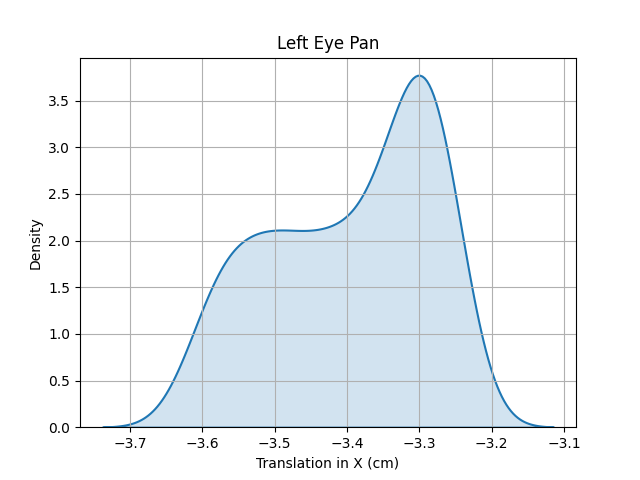

In [93]:
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==-20].reset_index()
# Showing the whole plot
plt.figure()
sns.kdeplot(100*df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in X (cm)')
plt.title('Left Eye Pan')

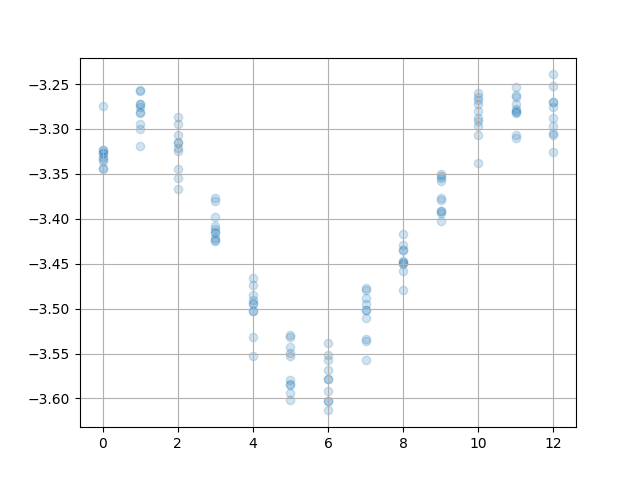

In [94]:
plt.figure()
plt.scatter(df['theta_left_pan_cmd_tminus1'], 100*df['t_x_list'], alpha=0.2)
plt.grid()

(-0.1, 0.1)

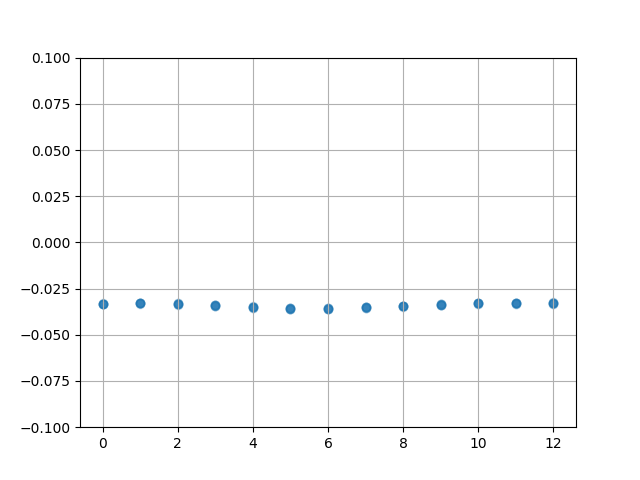

In [95]:
plt.figure()
plt.scatter(df['theta_left_pan_cmd_tminus1'], df['t_x_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1,0.1])

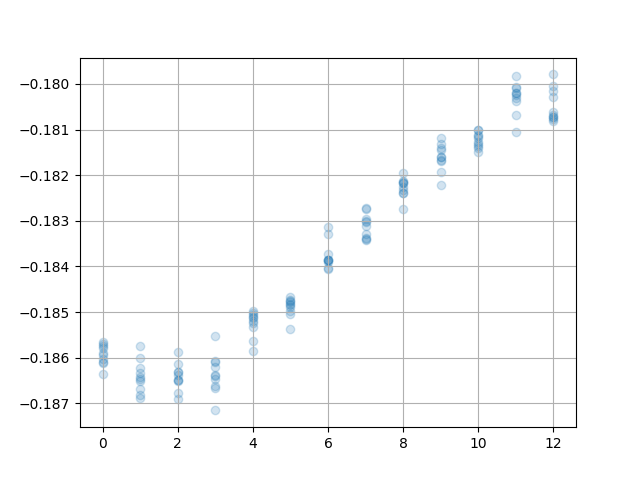

In [96]:
plt.figure()
plt.scatter(df['theta_left_pan_cmd_tminus1'], df['t_y_list'], alpha=0.2)
plt.grid()

(-0.3, -0.1)

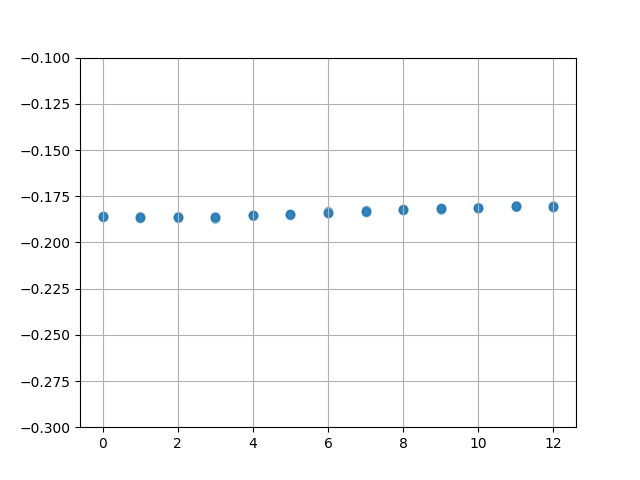

In [97]:
plt.figure()
plt.scatter(df['theta_left_pan_cmd_tminus1'], df['t_y_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.3,-0.1])

(-0.1, 0.1)

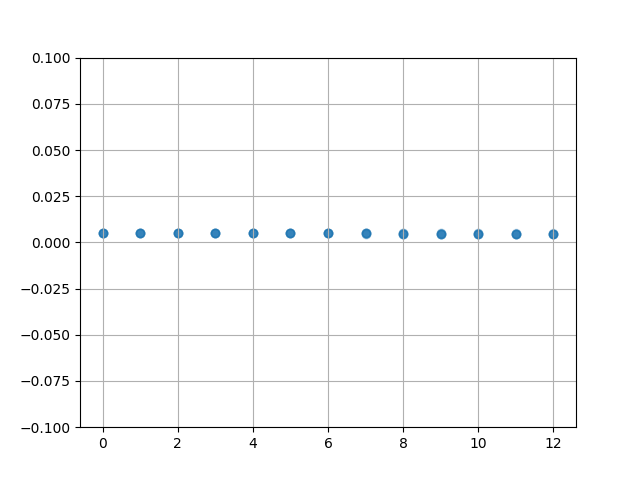

In [98]:
plt.figure()
plt.scatter(df['theta_left_pan_cmd_tminus1'], df['t_z_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1, 0.1])

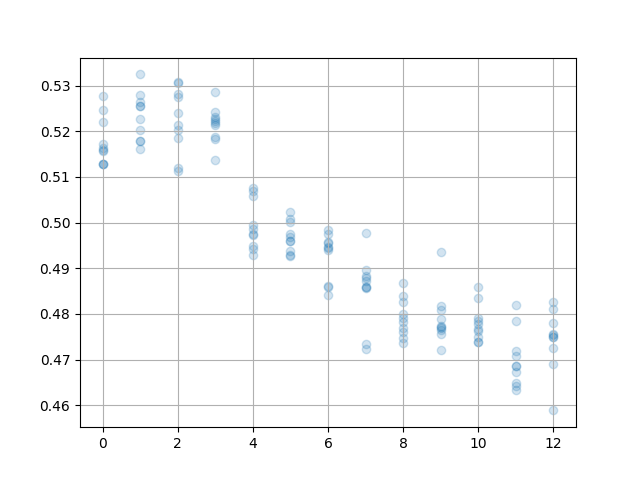

In [99]:
plt.figure()
plt.scatter(df['theta_left_pan_cmd_tminus1'], 100*df['t_z_list'], alpha=0.2)
plt.grid()

## Pan Translation

(-0.1, 0.1)

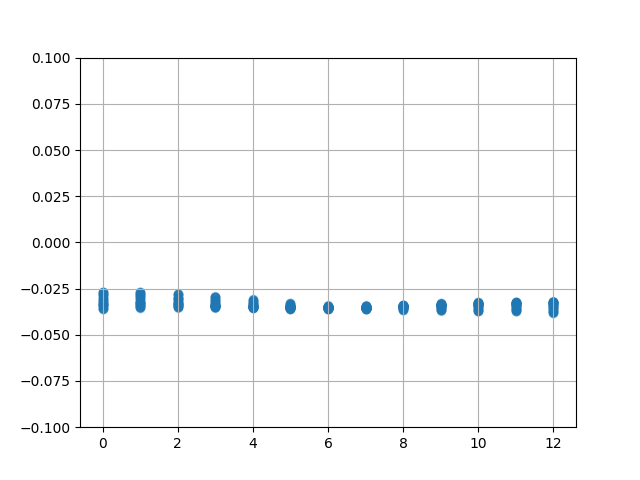

In [100]:
plt.figure()
plt.scatter(filt_df['theta_left_pan_cmd_tminus1'], filt_df['t_x_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1,0.1])

(-0.25, -0.15)

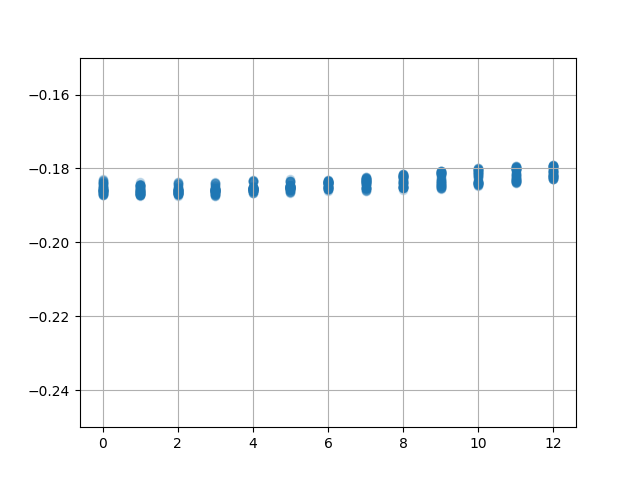

In [101]:
plt.figure()
plt.scatter(filt_df['theta_left_pan_cmd_tminus1'], filt_df['t_y_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.25,-0.15])

(-0.1, 0.1)

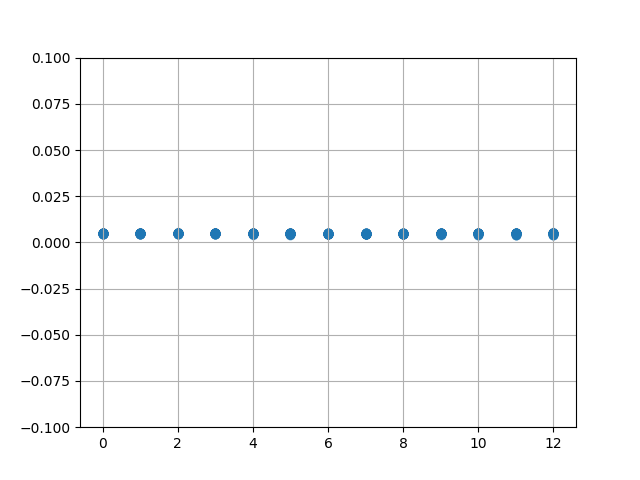

In [102]:
plt.figure()
plt.scatter(filt_df['theta_left_pan_cmd_tminus1'], filt_df['t_z_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1, 0.1])

Text(0.5, 1.0, 'Left Eye')

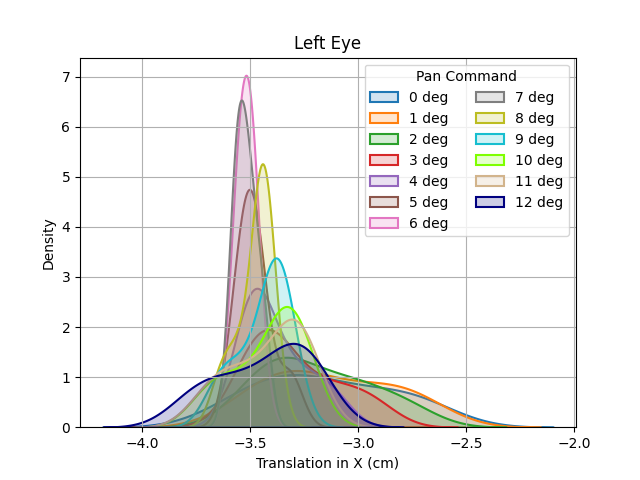

In [103]:
# Showing the whole plot
plt.figure()

for i in range(len(left_pan_cmd_list)):
    df = filt_df[filt_df['theta_left_pan_cmd_tminus1']==left_pan_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.5, color=colors[i])

plt.legend(['0 deg', '1 deg', '2 deg', '3 deg', '4 deg', '5 deg', '6 deg',
           '7 deg', '8 deg', '9 deg', '10 deg', '11 deg', '12 deg'], title='Pan Command', ncol=2)
plt.grid()
plt.xlabel('Translation in X (cm)')
plt.title('Left Eye')

Text(0.5, 1.0, 'Left Eye')

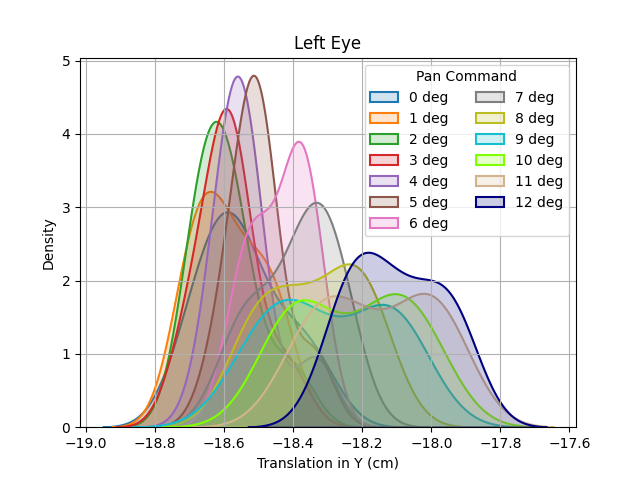

In [104]:
# Showing the whole plot
plt.figure()

for i in range(len(left_pan_cmd_list)):
    df = filt_df[filt_df['theta_left_pan_cmd_tminus1']==left_pan_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_y_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.5, color=colors[i])

plt.legend(['0 deg', '1 deg', '2 deg', '3 deg', '4 deg', '5 deg', '6 deg',
           '7 deg', '8 deg', '9 deg', '10 deg', '11 deg', '12 deg'], title='Pan Command', ncol=2)
plt.grid()
plt.xlabel('Translation in Y (cm)')
plt.title('Left Eye')

Text(0.5, 1.0, 'Left Eye Pan')

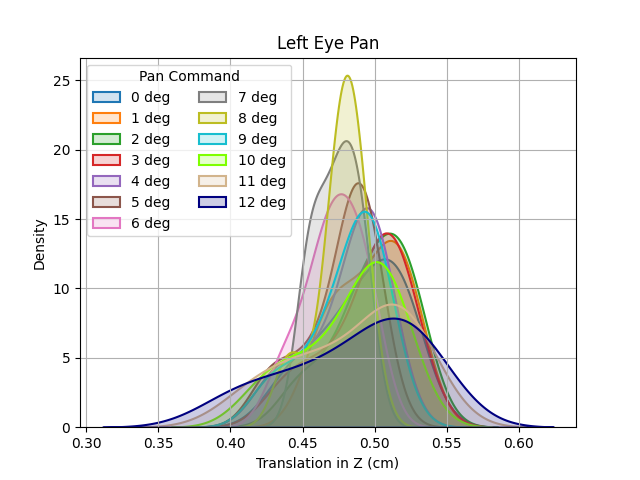

In [105]:
# Showing the whole plot
plt.figure()

for i in range(len(left_pan_cmd_list)):
    df = filt_df[filt_df['theta_left_pan_cmd_tminus1']==left_pan_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_z_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.5, color=colors[i])

plt.legend(['0 deg', '1 deg', '2 deg', '3 deg', '4 deg', '5 deg', '6 deg',
           '7 deg', '8 deg', '9 deg', '10 deg', '11 deg', '12 deg'], title='Pan Command', ncol=2, loc='upper left')
plt.grid()
plt.xlabel('Translation in Z (cm)')
plt.title('Left Eye Pan')

Text(0.5, 1.0, 'Left Eye')

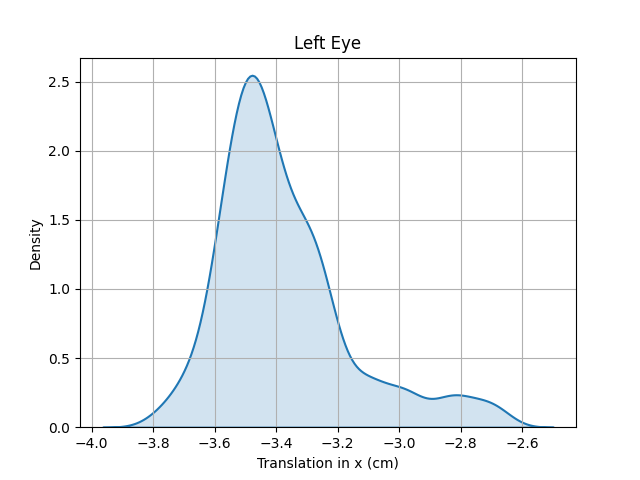

In [106]:
# Showing the whole plot
plt.figure()
sns.kdeplot(100*filt_df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in x (cm)')
plt.title('Left Eye')

Text(0.5, 1.0, 'Left Eye')

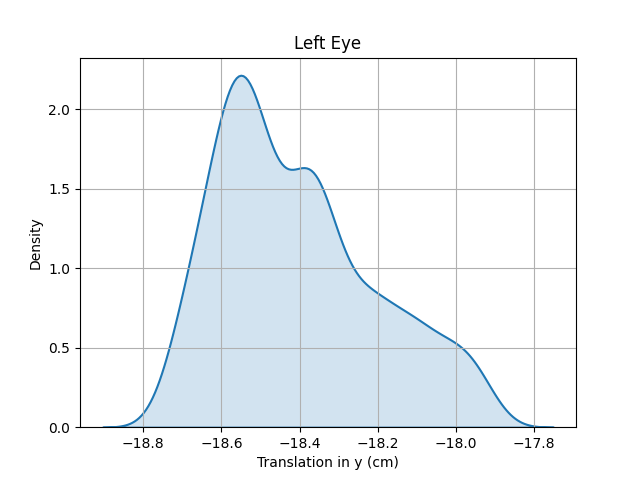

In [107]:
# Showing the whole plot
plt.figure()
sns.kdeplot(100*filt_df['t_y_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in y (cm)')
plt.title('Left Eye')

Text(0.5, 1.0, 'Left Eye')

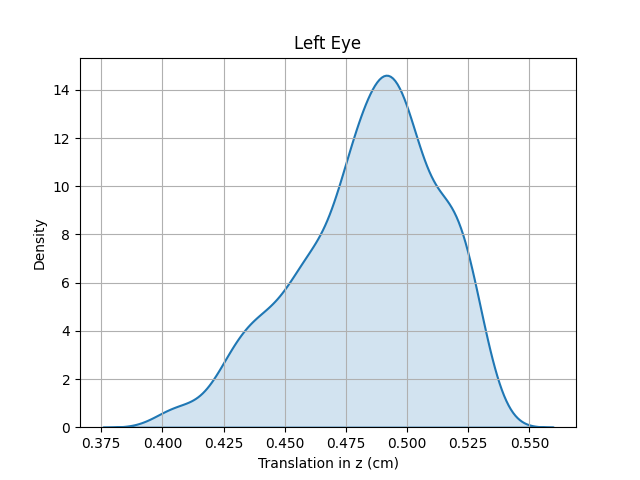

In [108]:
# Showing the whole plot
plt.figure()
sns.kdeplot(100*filt_df['t_z_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in z (cm)')
plt.title('Left Eye')

## Tilt Translation

In [109]:
tilt_cmd_list

[-30, -25, -20, -15, -10, -5, 0]

Text(0.5, 1.0, 'Left Eye')

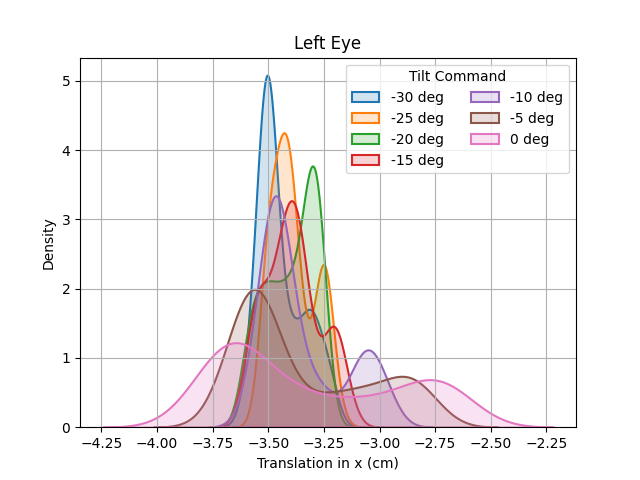

In [110]:
# Showing the whole plot
plt.figure()

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.0, color=colors[i])

plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command', ncol=2)
plt.grid()
plt.xlabel('Translation in x (cm)')
plt.title('Left Eye')

Text(0.5, 1.0, 'Left Eye')

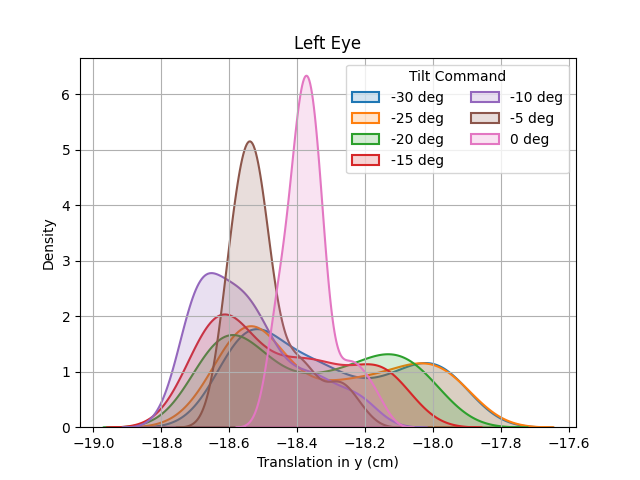

In [111]:
# Showing the whole plot
plt.figure()

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_y_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.0, color=colors[i])

plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command', ncol=2)
plt.grid()
plt.xlabel('Translation in y (cm)')
plt.title('Left Eye')

Text(0.5, 1.0, 'Left Eye')

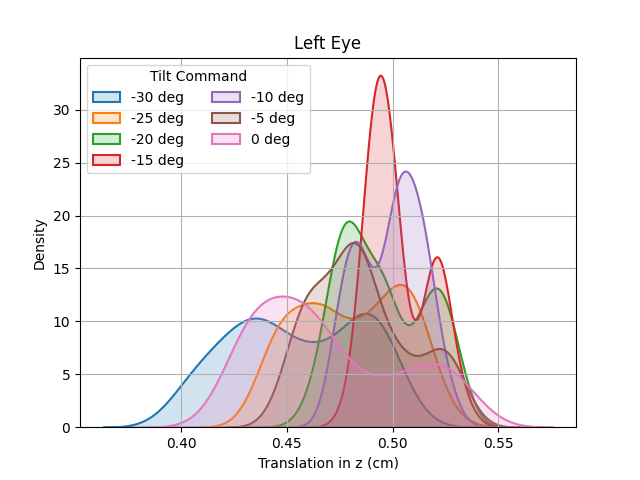

In [112]:
# Showing the whole plot
plt.figure()

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_z_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.0, color=colors[i])

plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command', ncol=2, loc="upper left")
plt.grid()
plt.xlabel('Translation in z (cm)')
plt.title('Left Eye')

(-0.1, 0.1)

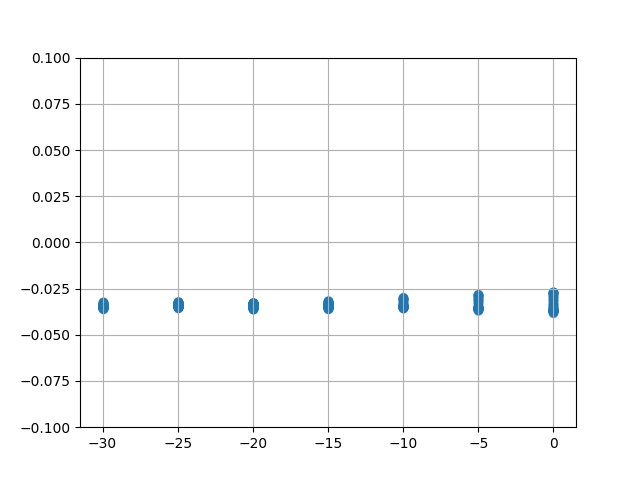

In [113]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['t_x_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1,0.1])

(-0.3, -0.1)

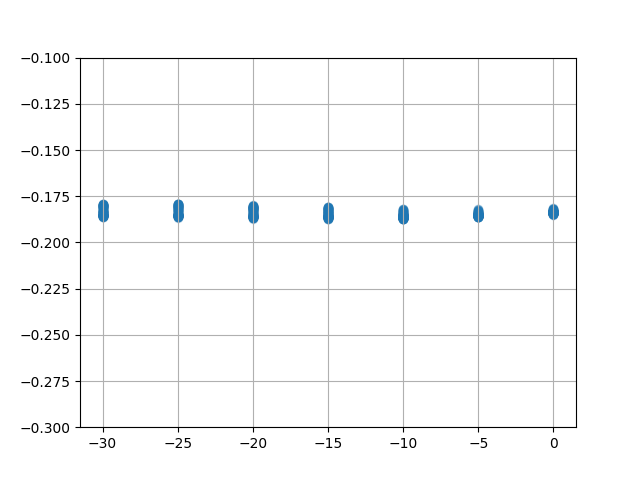

In [114]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['t_y_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.3,-0.1])

(-0.1, 0.1)

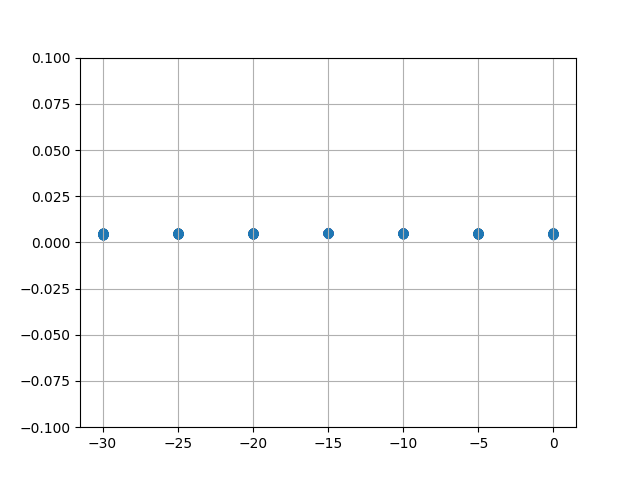

In [115]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['t_z_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1, 0.1])

### Comparison

Text(0.5, 1.0, 'Left Eye')

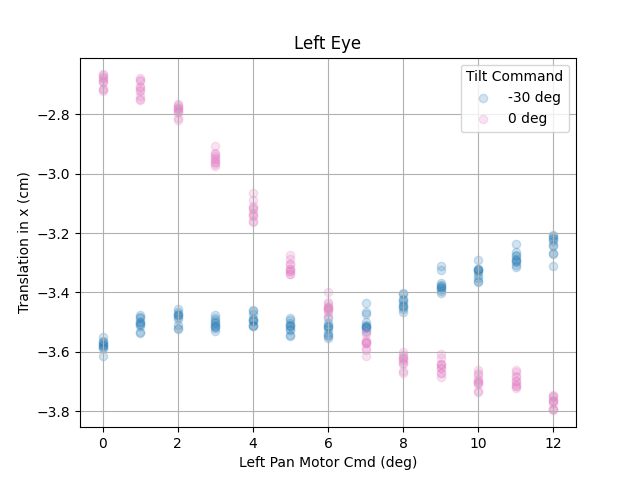

In [116]:
plt.figure()
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[0]].reset_index()
plt.scatter(df['theta_left_pan_cmd_tminus1'], 100*df['t_x_list'], alpha=0.2, color=colors[0])
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[-1]].reset_index()
plt.scatter(df['theta_left_pan_cmd_tminus1'], 100*df['t_x_list'], alpha=0.2, color=colors[6])
plt.grid()
plt.legend(['-30 deg', '0 deg'], title='Tilt Command', loc="upper right")
plt.xlabel('Left Pan Motor Cmd (deg)')
plt.ylabel('Translation in x (cm)')
plt.title('Left Eye')

# Final Left Pose

In [117]:
left_df = filt_df[(filt_df['theta_tilt_cmd_tminus1']==0) 
                  & (filt_df['theta_left_pan_cmd_tminus1']==0)].reset_index()
left_zero_T = np.mean(left_df['T_left_eye'])
left_zero_T

array([[ 0.98571428,  0.03217062, -0.16532297, -0.02690024],
       [-0.03894919,  0.99852119, -0.0379241 , -0.18436625],
       [ 0.16385845,  0.04382147,  0.98550964,  0.00465464],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [118]:
np.mean(left_df['roll'])

-2.2627887879082342

In [119]:
np.mean(left_df['pitch'])

2.5460254148247543

In [120]:
np.mean(left_df['yaw'])

-9.430929093728867

# Gaze Center Calculation

In [121]:
calib_params

{'left_eye': {'slope': 1.6278,
  'backlash': 3.3891,
  'x_center': 360.6,
  'y_center': 224.7},
 'right_eye': {'slope': 1.6657,
  'backlash': 2.162,
  'x_center': 222.3,
  'y_center': 235.9},
 'tilt_eyes': {'slope': 0.387, 'backlash': 0}}

In [122]:
# Left Eye

gx_left = calib_params['left_eye']['x_center']
gy_left = calib_params['left_eye']['y_center']

fx_left = left_eye_camera_mtx[0][0]
cx_left = left_eye_camera_mtx[0][2]
fy_left = left_eye_camera_mtx[1][1]
cy_left = left_eye_camera_mtx[1][2]

In [123]:
print('gx_left:', gx_left)
print('cx_left:',cx_left)
print('gy_left:',gy_left)
print('cy_left',cy_left)

gx_left: 360.6
cx_left: 302.45664072
gy_left: 224.7
cy_left 215.54188413


In [124]:
# Calculation of the angles

yaw_left = math.degrees(math.atan((gx_left-cx_left)/fx_left))
pitch_left = math.degrees(math.atan((cy_left-gy_left)/fy_left))

print('yaw_left (deg):', yaw_left)
print('pitch_left (deg):', pitch_left)

yaw_left (deg): 5.868985228595727
pitch_left (deg): -0.929092772858488


In [125]:
# Right Eye

gx_right = calib_params['right_eye']['x_center']
gy_right = calib_params['right_eye']['y_center']

fx_right = right_eye_camera_mtx[0][0]
cx_right = right_eye_camera_mtx[0][2]
fy_right = right_eye_camera_mtx[1][1]
cy_right = right_eye_camera_mtx[1][2]

In [126]:
print('gx_right:', gx_right)
print('cx_right:',cx_right)
print('gy_right:',gy_right)
print('cy_right',cy_right)

gx_right: 222.3
cx_right: 301.5981296
gy_right: 235.9
cy_right 214.24971323


In [127]:
# Calculation of the angles

yaw_right = math.degrees(math.atan((gx_right-cx_right)/fx_right))
pitch_right = math.degrees(math.atan((cy_right-gy_right)/fy_right))

print('yaw_right (deg):', yaw_right)
print('pitch_right (deg):', pitch_right)

yaw_right (deg): -7.9146930152243264
pitch_right (deg): -2.175626509301668


In [128]:
# Scipy Plotting

from scipy.spatial.transform import Rotation as R


def plot_rotated_axes(ax, r, name=None, offset=(0, 0, 0), scale=1):
    colors = ("#FF6666", "#005533", "#1199EE")  # Colorblind-safe RGB
    loc = np.array([offset, offset])
    for i, (axis, c) in enumerate(zip((ax.xaxis, ax.yaxis, ax.zaxis),
                                      colors)):
        axlabel = axis.axis_name
        axis.set_label_text(axlabel)
        axis.label.set_color(c)
        axis.line.set_color(c)
        axis.set_tick_params(colors=c)
        line = np.zeros((2, 3))
        line[1, i] = scale
        line_rot = r.apply(line)
        line_plot = line_rot + loc
        ax.plot(line_plot[:, 0], line_plot[:, 1], line_plot[:, 2], c)
        text_loc = line[1]*1.2
        text_loc_rot = r.apply(text_loc)
        text_plot = text_loc_rot + loc[0]
        ax.text(*text_plot, axlabel.upper(), color=c,
                va="center", ha="center")
    ax.text(*offset, name, color="k", va="center", ha="center",
            bbox={"fc": "w", "alpha": 0.8, "boxstyle": "circle"})

In [129]:
r0 = R.identity()
r1 = R.from_euler("ZYX", [90, -30, 0], degrees=True)  # intrinsic
r2 = R.from_euler("zyx", [90, -30, 0], degrees=True)  # extrinsic

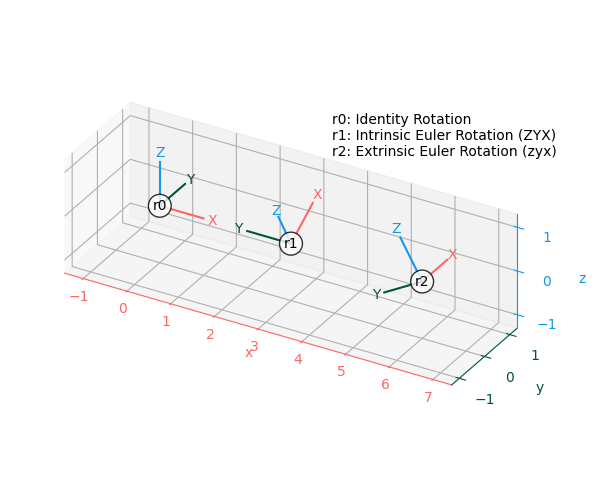

In [130]:
ax = plt.figure().add_subplot(projection="3d", proj_type="ortho")
plot_rotated_axes(ax, r0, name="r0", offset=(0, 0, 0))
plot_rotated_axes(ax, r1, name="r1", offset=(3, 0, 0))
plot_rotated_axes(ax, r2, name="r2", offset=(6, 0, 0))
_ = ax.annotate(
    "r0: Identity Rotation\n"
    "r1: Intrinsic Euler Rotation (ZYX)\n"
    "r2: Extrinsic Euler Rotation (zyx)",
    xy=(0.6, 0.7), xycoords="axes fraction", ha="left"
)
ax.set(xlim=(-1.25, 7.25), ylim=(-1.25, 1.25), zlim=(-1.25, 1.25))
ax.set(xticks=range(-1, 8), yticks=[-1, 0, 1], zticks=[-1, 0, 1])
ax.set_aspect("equal", adjustable="box")
ax.figure.set_size_inches(6, 5)
plt.tight_layout()

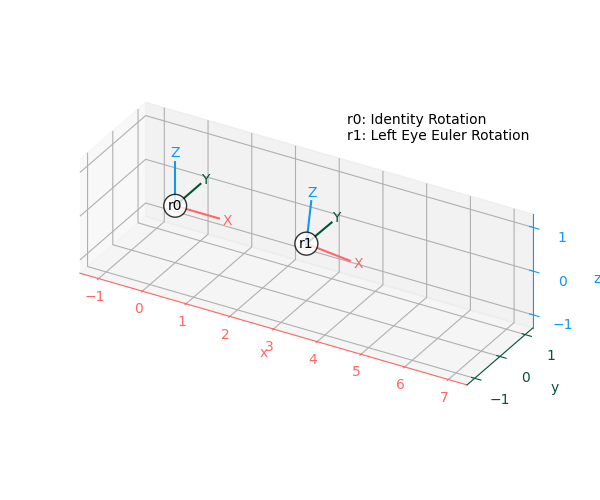

In [131]:
# Plotting for the Left rotation

r0 = R.identity()
r1 = R.from_euler("zyx", [0, yaw_left, pitch_left], degrees=True)  # extrinsic

ax = plt.figure().add_subplot(projection="3d", proj_type="ortho")
plot_rotated_axes(ax, r0, name="r0", offset=(0, 0, 0))
plot_rotated_axes(ax, r1, name="r1", offset=(3, 0, 0))
_ = ax.annotate(
    "r0: Identity Rotation\n"
    "r1: Left Eye Euler Rotation\n",
    xy=(0.6, 0.7), xycoords="axes fraction", ha="left"
)
ax.set(xlim=(-1.25, 7.25), ylim=(-1.25, 1.25), zlim=(-1.25, 1.25))
ax.set(xticks=range(-1, 8), yticks=[-1, 0, 1], zticks=[-1, 0, 1])
ax.set_aspect("equal", adjustable="box")
ax.figure.set_size_inches(6, 5)
plt.tight_layout()

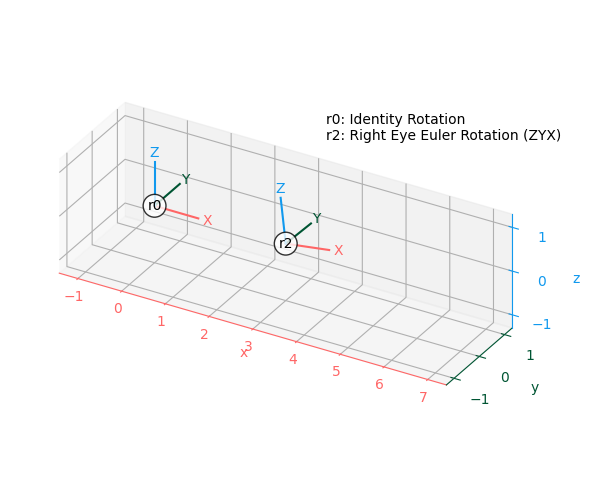

In [132]:
# Plotting for the Left rotation

r0 = R.identity()
r2 = R.from_euler("zyx", [0, yaw_right, pitch_right], degrees=True)  # extrinsic

ax = plt.figure().add_subplot(projection="3d", proj_type="ortho")
plot_rotated_axes(ax, r0, name="r0", offset=(0, 0, 0))
plot_rotated_axes(ax, r2, name="r2", offset=(3, 0, 0))
_ = ax.annotate(
    "r0: Identity Rotation\n"
    "r2: Right Eye Euler Rotation (ZYX)\n",
    xy=(0.6, 0.7), xycoords="axes fraction", ha="left"
)
ax.set(xlim=(-1.25, 7.25), ylim=(-1.25, 1.25), zlim=(-1.25, 1.25))
ax.set(xticks=range(-1, 8), yticks=[-1, 0, 1], zticks=[-1, 0, 1])
ax.set_aspect("equal", adjustable="box")
ax.figure.set_size_inches(6, 5)
plt.tight_layout()

In [133]:
# Example

r3 = R.from_euler("zyx", [90, -30, 0], degrees=True)  # extrinsic
print(r3.as_matrix())
print(r3.as_euler('zyx', degrees=True))

[[ 1.11022302e-16 -8.66025404e-01 -5.00000000e-01]
 [ 1.00000000e+00  1.11022302e-16  0.00000000e+00]
 [ 1.11022302e-16 -5.00000000e-01  8.66025404e-01]]
[ 90. -30.   0.]


In [134]:
# Gaze Center Left

T_gaze_ctr_left = r1.as_matrix()
print(T_gaze_ctr_left)
print(r1.as_euler('zyx', degrees=True))

[[ 9.94758314e-01  1.08420217e-19  1.02254079e-01]
 [-1.65805166e-03  9.99868528e-01  1.61300233e-02]
 [-1.02240636e-01 -1.62150173e-02  9.94627531e-01]]
[ 0.          5.86898523 -0.92909277]


In [135]:
# Gaze Center Right

T_gaze_ctr_right = r2.as_matrix()
print(T_gaze_ctr_right)
print(r2.as_euler('zyx', degrees=True))

[[ 9.90474184e-01 -4.33680869e-19 -1.37698549e-01]
 [ 5.22741168e-03  9.99279156e-01  3.76010956e-02]
 [ 1.37599290e-01 -3.79627215e-02  9.89760207e-01]]
[ 0.         -7.91469302 -2.17562651]


# -------------------------------------------------------------------------------------

# Extrinsic Transformation (Right)

In [136]:
# Chest Image

T_chest = get_camera_pose(chest_img, obj_pts, chest_cam_camera_mtx, chest_cam_dist_coef)

In [137]:
# Looping: Right Eye Image

img_list = filt_df['right_eye_img'].tolist()
T_right_list = []
for img in img_list:
    T_right_list.append(get_camera_pose(img, obj_pts, right_eye_camera_mtx, right_eye_dist_coef))

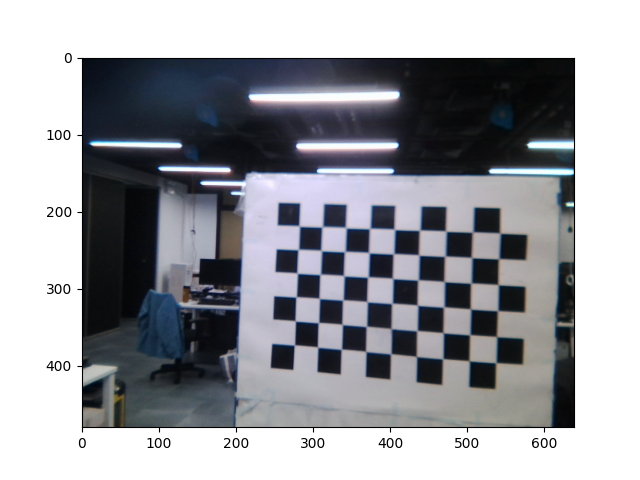

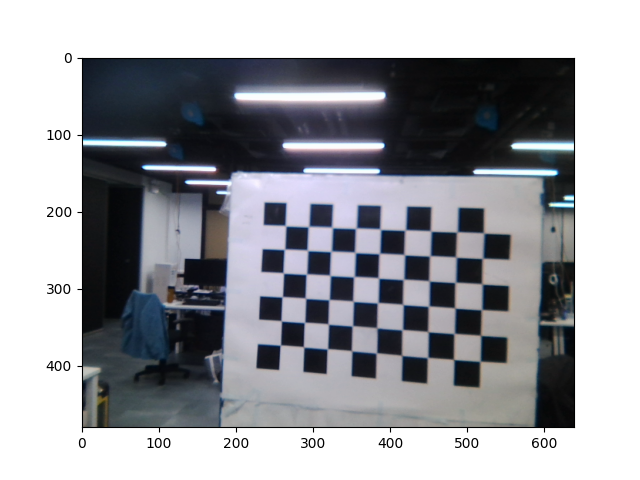

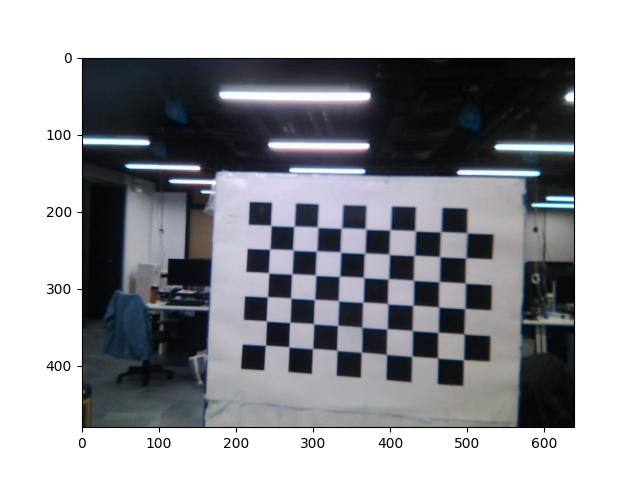

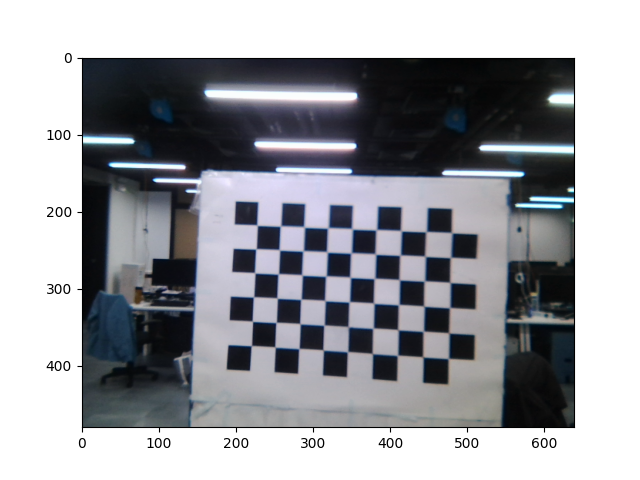

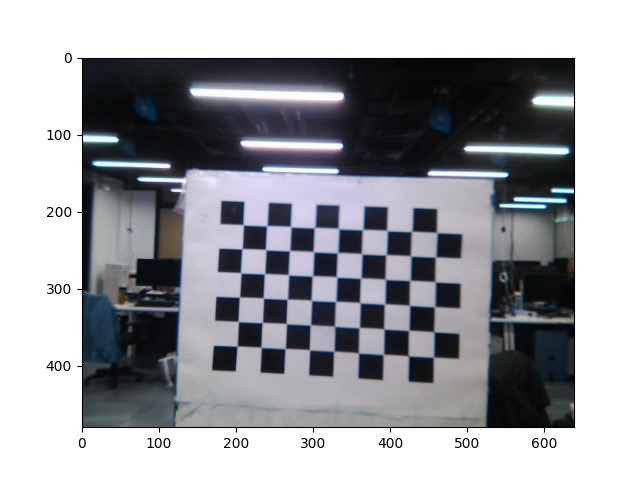

...

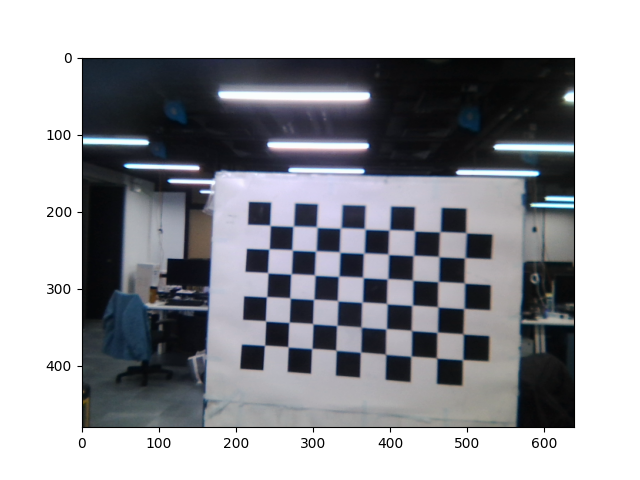

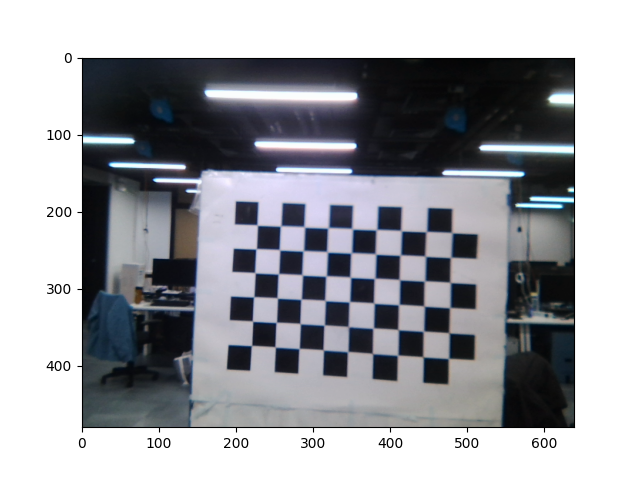

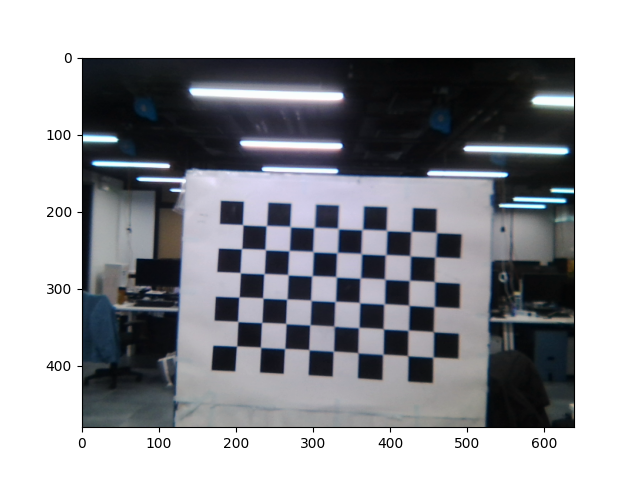

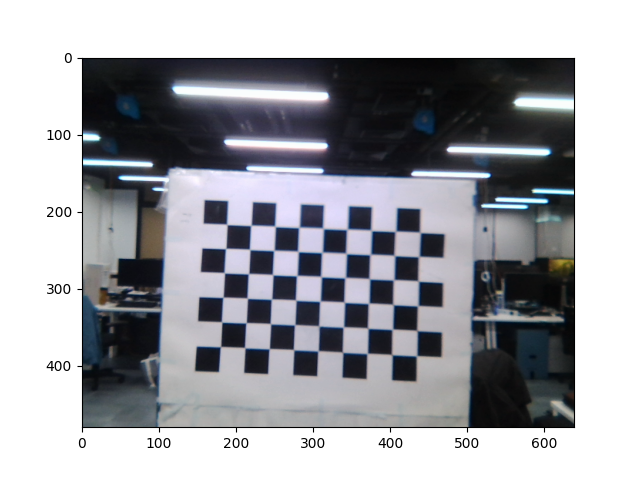

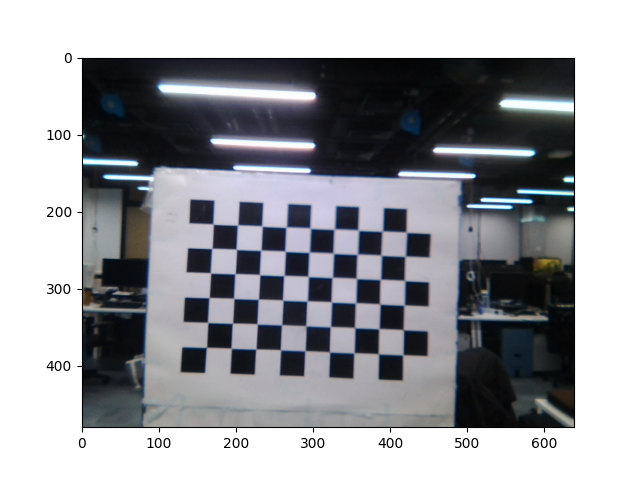

In [138]:
img_list = filt_df['right_eye_img'].tolist()
for i in range(20):
    plt.figure()
    plt.imshow(img_list[i])

In [139]:
%matplotlib widget

(-0.2, 2.0)

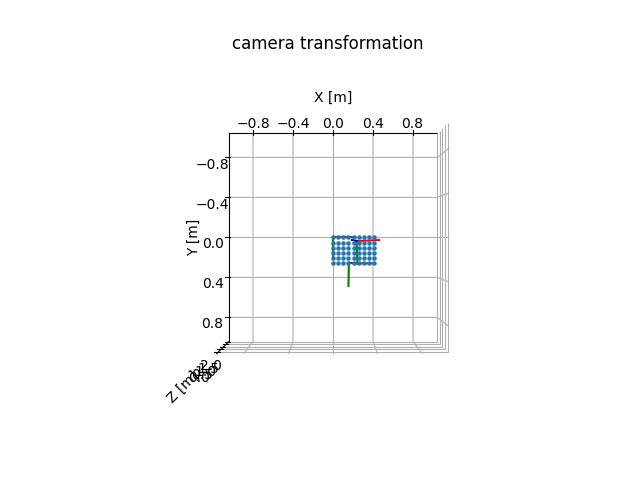

In [140]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest[:3,:3], T_chest[:3,-1], s=0.2)
    
# Plot Right Poses
for T in [T_right_list[0]]:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=0.2)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [141]:
T_right_list[0]

array([[ 0.97907997,  0.03157741, -0.20101066,  0.20546808],
       [-0.04180821,  0.99802636, -0.04685568,  0.03134285],
       [ 0.19913435,  0.05427936,  0.97846781, -0.85397517],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [142]:
T_chest

array([[ 0.99940299, -0.01758478,  0.02973951,  0.13768625],
       [ 0.01735353,  0.99981728,  0.00801629,  0.22184111],
       [-0.02987505, -0.00749542,  0.99952554, -0.86118787],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [143]:
# Compute inverse of P1
P1_inv = np.linalg.inv(T_chest)

# Compute the relative transformation between P1 and P2
P_rel = np.matmul(P1_inv, T_right_list[0])

print(P_rel)

[[ 0.97182078  0.04725624 -0.23093553  0.06422006]
 [-0.06051008  0.99688187 -0.05064642 -0.19170944]
 [ 0.22782209  0.06319317  0.97165     0.00769799]
 [ 0.          0.          0.          1.        ]]


## Multiple Poses

(-0.2, 2.0)

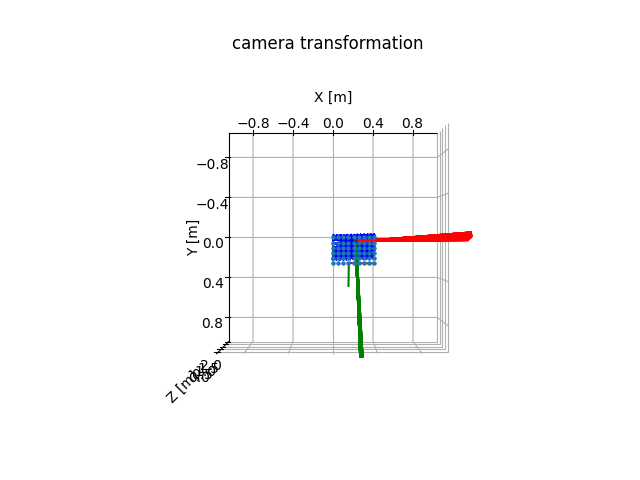

In [144]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest[:3,:3], T_chest[:3,-1], s=0.2)
    
# Plot Right Poses
for T in T_right_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

# Chess Point Location Transformation (Chess World -> Chest)

In [145]:
# Transformation for the shifting of the center

T_chest_cam_ctr = np.eye(4)
T_chest_cam_ctr[0, -1] = -0.0325  # chest rgb to module center, 32.5 mm
T_chest_cam_ctr

array([[ 1.    ,  0.    ,  0.    , -0.0325],
       [ 0.    ,  1.    ,  0.    ,  0.    ],
       [ 0.    ,  0.    ,  1.    ,  0.    ],
       [ 0.    ,  0.    ,  0.    ,  1.    ]])

In [146]:
orig_obj_pts = copy.deepcopy(obj_pts)
orig_obj_pts

array([[0.    , 0.    , 0.    ],
       [0.0467, 0.    , 0.    ],
       [0.0934, 0.    , 0.    ],
       [0.1401, 0.    , 0.    ],
       [0.1868, 0.    , 0.    ],
       [0.2335, 0.    , 0.    ],
       [0.2802, 0.    , 0.    ],
       [0.3269, 0.    , 0.    ],
       [0.3736, 0.    , 0.    ],
       [0.    , 0.0467, 0.    ],
       [0.0467, 0.0467, 0.    ],
       [0.0934, 0.0467, 0.    ],
       [0.1401, 0.0467, 0.    ],
       [0.1868, 0.0467, 0.    ],
       [0.2335, 0.0467, 0.    ],
       [0.2802, 0.0467, 0.    ],
       [0.3269, 0.0467, 0.    ],
       [0.3736, 0.0467, 0.    ],
       [0.    , 0.0934, 0.    ],
       [0.0467, 0.0934, 0.    ],
       [0.0934, 0.0934, 0.    ],
       [0.1401, 0.0934, 0.    ],
       [0.1868, 0.0934, 0.    ],
       [0.2335, 0.0934, 0.    ],
       [0.2802, 0.0934, 0.    ],
       [0.3269, 0.0934, 0.    ],
       [0.3736, 0.0934, 0.    ],
       [0.    , 0.1401, 0.    ],
       [0.0467, 0.1401, 0.    ],
       [0.0934, 0.1401, 0.    ],
       [0.

In [147]:
T_chest

array([[ 0.99940299, -0.01758478,  0.02973951,  0.13768625],
       [ 0.01735353,  0.99981728,  0.00801629,  0.22184111],
       [-0.02987505, -0.00749542,  0.99952554, -0.86118787],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [148]:
T_chest_inv = np.linalg.inv(T_chest)
T_chest_inv

array([[ 0.99940299,  0.01735353, -0.02987505, -0.1671818 ],
       [-0.01758478,  0.99981728, -0.00749542, -0.22583436],
       [ 0.02973951,  0.00801629,  0.99952554,  0.8549062 ],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [149]:
final_obj_pts = transform_points(orig_obj_pts, T_chest_inv)
final_obj_pts = transform_points(final_obj_pts, T_chest_cam_ctr)
final_obj_pts

array([[-0.1996818 , -0.22583436,  0.8549062 ],
       [-0.15300968, -0.22665557,  0.85629504],
       [-0.10633756, -0.22747678,  0.85768387],
       [-0.05966544, -0.22829799,  0.85907271],
       [-0.01299332, -0.2291192 ,  0.86046155],
       [ 0.0336788 , -0.22994041,  0.86185038],
       [ 0.08035092, -0.23076162,  0.86323922],
       [ 0.12702304, -0.23158282,  0.86462805],
       [ 0.17369516, -0.23240403,  0.86601689],
       [-0.19887139, -0.17914289,  0.85528056],
       [-0.15219927, -0.1799641 ,  0.8566694 ],
       [-0.10552715, -0.18078531,  0.85805824],
       [-0.05885503, -0.18160652,  0.85944707],
       [-0.01218291, -0.18242773,  0.86083591],
       [ 0.03448921, -0.18324894,  0.86222474],
       [ 0.08116133, -0.18407015,  0.86361358],
       [ 0.12783345, -0.18489136,  0.86500241],
       [ 0.17450557, -0.18571257,  0.86639125],
       [-0.19806098, -0.13245142,  0.85565493],
       [-0.15138886, -0.13327263,  0.85704376],
       [-0.10471674, -0.13409384,  0.858

(-0.2, 2.0)

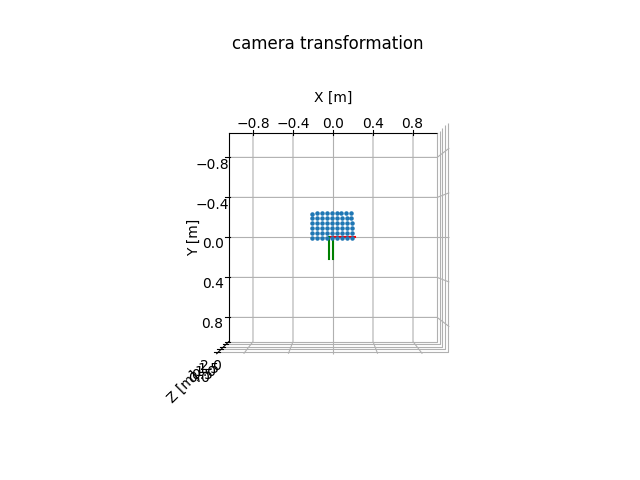

In [150]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [151]:
# Get Depth Object Points

depth_obj_pts = get_chess_obj_pts(chest_img, depth_img, chest_cam_camera_mtx, chest_cam_dist_coef)

(-0.2, 2.0)

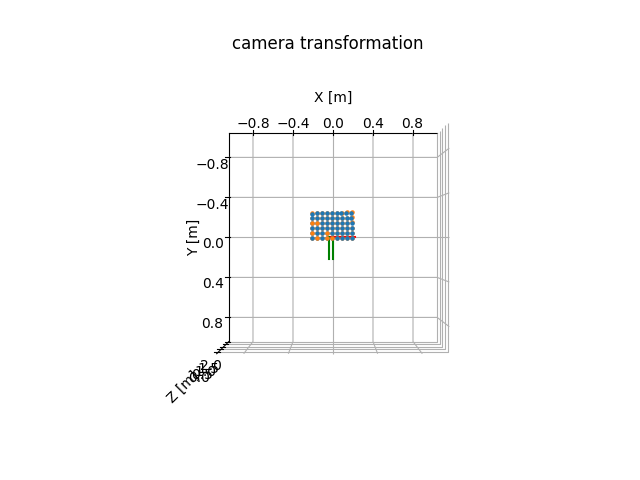

In [152]:
# Plotting the Depth Image Points

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot 3D Depth Chess Points
for x,y,z in depth_obj_pts:
    ax.scatter(x-0.0325, y, z-0.0042, color=colors[1], marker='.')  # The 3d depth camera is still chest rgb

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

Subtracted 32.5 mm in x for the color camera. Subtracted 11.5 mm in x, added 10 mm in y, and subtracted 4.2 mm in z for the depth camera. The y compensation accounts for the transformation from depth to eye camera

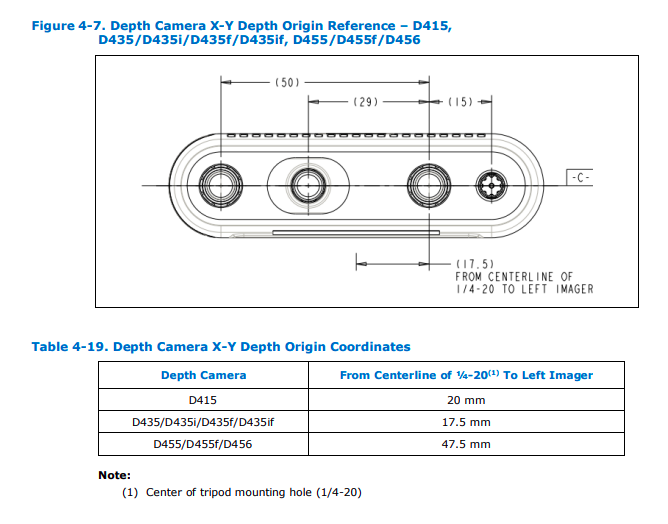

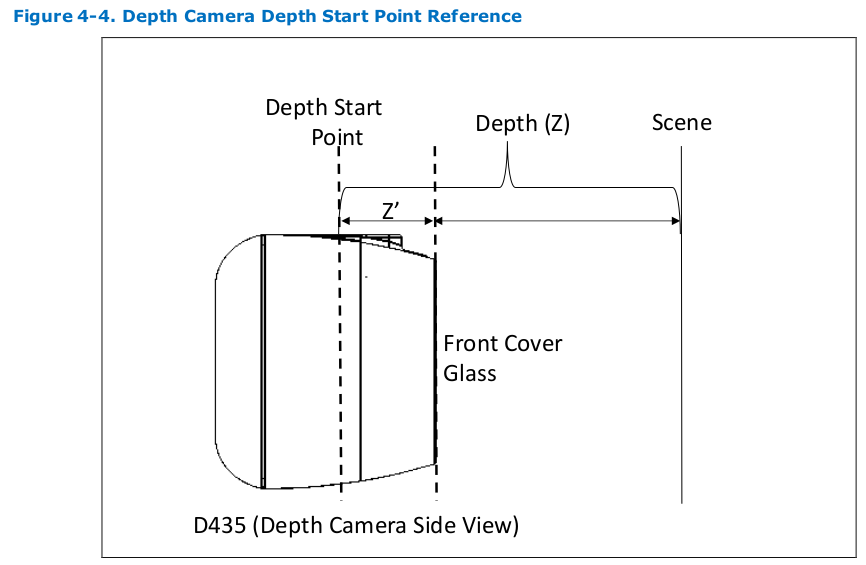
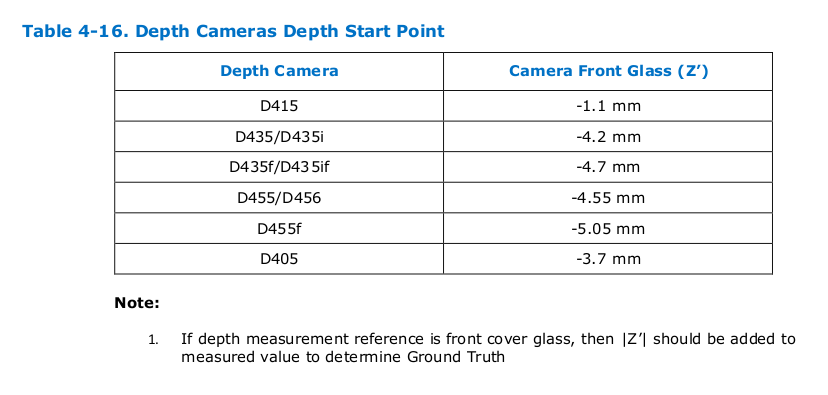

# Right Eye Transformation to Realsense Module Center

In [153]:
T_chest

array([[ 0.99940299, -0.01758478,  0.02973951,  0.13768625],
       [ 0.01735353,  0.99981728,  0.00801629,  0.22184111],
       [-0.02987505, -0.00749542,  0.99952554, -0.86118787],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [154]:
T_chest_cam_ctr

array([[ 1.    ,  0.    ,  0.    , -0.0325],
       [ 0.    ,  1.    ,  0.    ,  0.    ],
       [ 0.    ,  0.    ,  1.    ,  0.    ],
       [ 0.    ,  0.    ,  0.    ,  1.    ]])

In [155]:
# Compute the relative transformation 

P1_inv = np.linalg.inv(T_chest)
T_rel = np.matmul(P1_inv, T_right_list[0])
T_final = np.matmul(T_chest_cam_ctr, T_rel)

print(T_rel)
print(T_final)

[[ 0.97182078  0.04725624 -0.23093553  0.06422006]
 [-0.06051008  0.99688187 -0.05064642 -0.19170944]
 [ 0.22782209  0.06319317  0.97165     0.00769799]
 [ 0.          0.          0.          1.        ]]
[[ 0.97182078  0.04725624 -0.23093553  0.03172006]
 [-0.06051008  0.99688187 -0.05064642 -0.19170944]
 [ 0.22782209  0.06319317  0.97165     0.00769799]
 [ 0.          0.          0.          1.        ]]


(-0.2, 2.0)

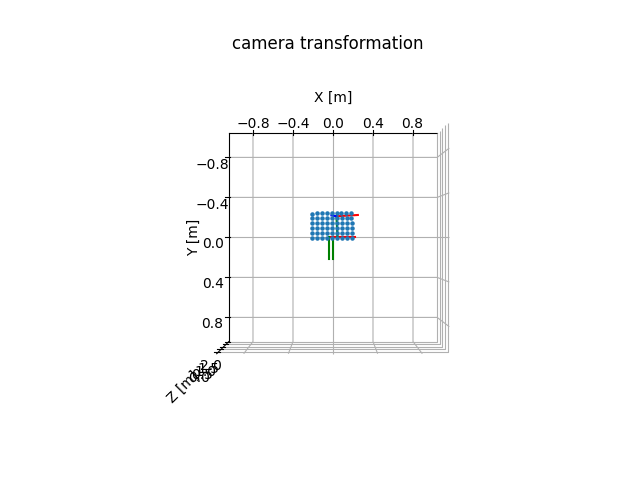

In [156]:
# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)
  
# Plot Right Eye
ax = pr.plot_basis(ax, T_final[:3,:3], T_final[:3,-1], s=0.2)


ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [157]:
pickle_df[:18]['theta_right_pan_cmd_tminus1']

0    -12
1     18
2    -11
3     18
4    -10
5     18
6     -9
7     18
8     -8
9     18
10    -7
11    18
12    -6
13    18
14    -5
15    18
16    -4
17    18
Name: theta_right_pan_cmd_tminus1, dtype: int64

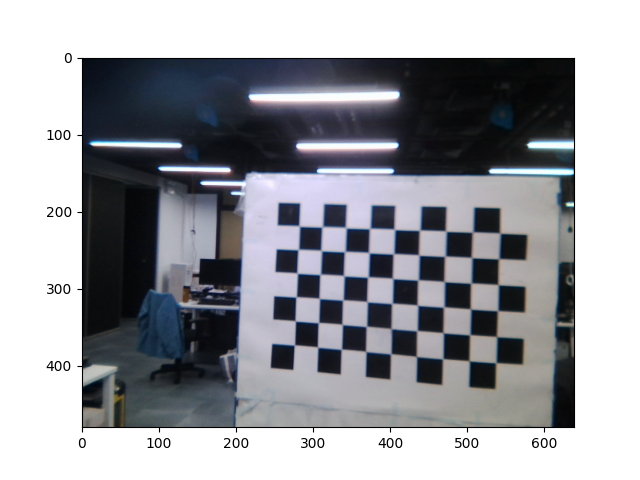

In [158]:
plt.figure()
plt.imshow(pickle_df['right_eye_img'][0])

In [159]:
filt_df[:18]['theta_right_pan_cmd_tminus1']

0    -12
1    -11
2    -10
3     -9
4     -8
5     -7
6     -6
7     -5
8     -4
9     -3
10    -2
11    -1
12     0
13   -12
14   -11
15   -10
16    -9
17    -8
Name: theta_right_pan_cmd_tminus1, dtype: int64

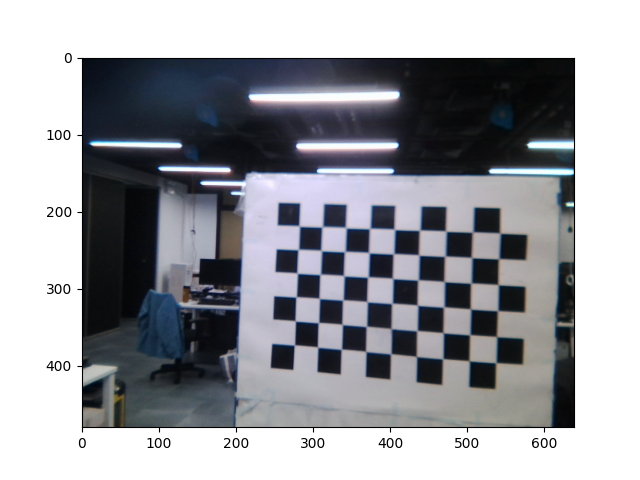

In [160]:
plt.figure()
plt.imshow(img_list[0])

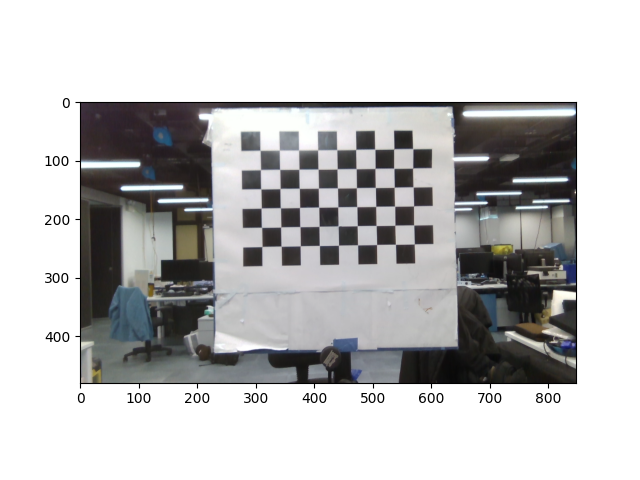

In [161]:
plt.figure()
plt.imshow(chest_img)

In [162]:
# Function Prototype:

def right_eye_to_origin(T_input):
    T_chest_inv = np.linalg.inv(T_chest)
    T_rel = np.matmul(T_chest_inv, T_input)
    T_final = np.matmul(T_chest_cam_ctr, T_rel)
    return T_final

In [163]:
# Final Right Eye List

T_right_final_list = []
for T_right in T_right_list:
    T_right_final_list.append(right_eye_to_origin(T_right))

(-0.2, 2.0)

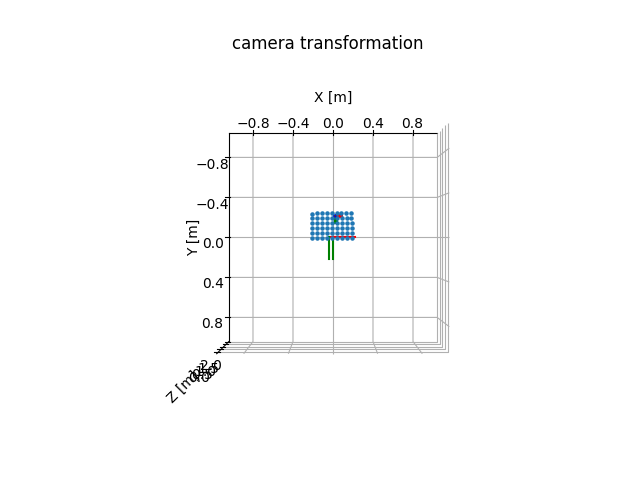

In [164]:
# Transformed Right Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Right Poses
for T in T_right_final_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=0.05)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

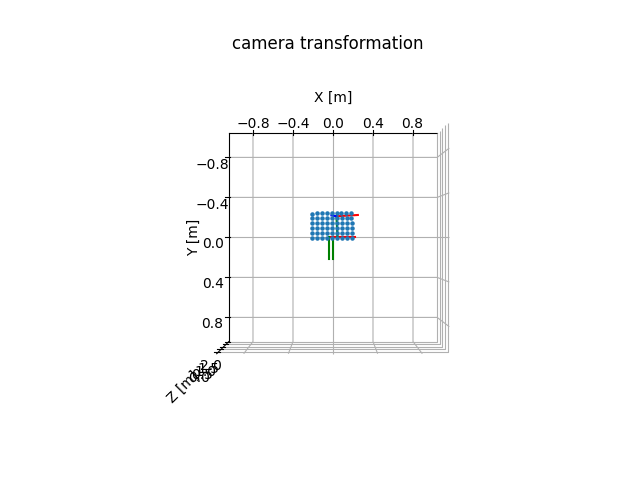

In [165]:
# Transformed Right Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Right Poses
for T in T_right_final_list[:1]:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=0.2)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

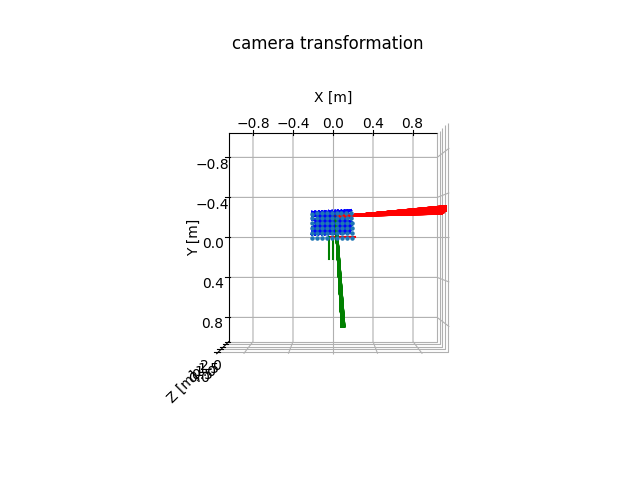

In [166]:
# Transformed Right Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Right Poses
for T in T_right_final_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

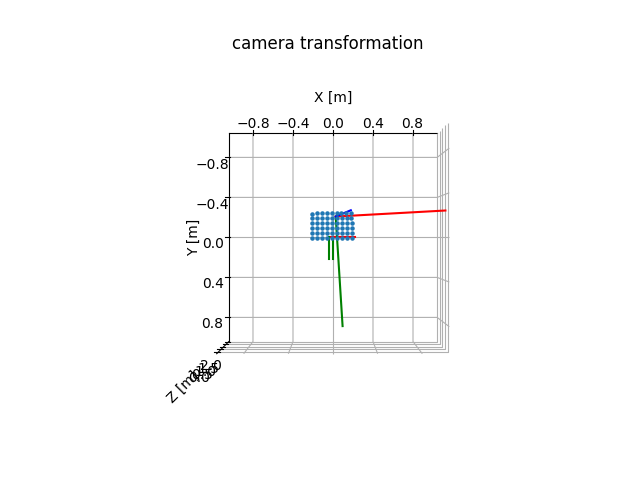

In [167]:
# Transformed Right Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Right Poses
for T in T_right_final_list[12:13]:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

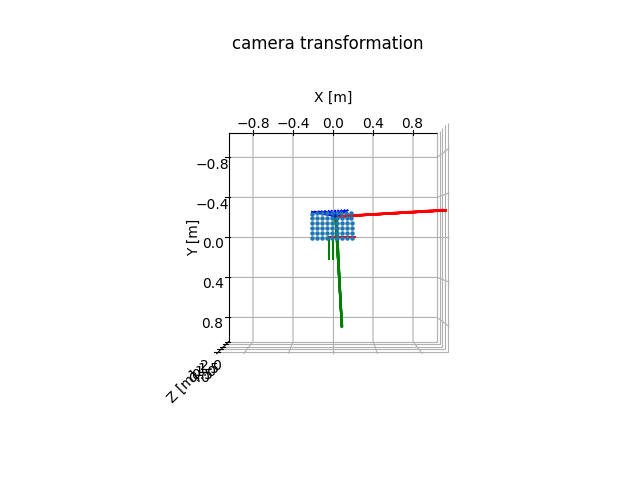

In [168]:
# Transformed Right Eye Camera

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Right Poses
for T in T_right_final_list[:12]:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

(-0.2, 2.0)

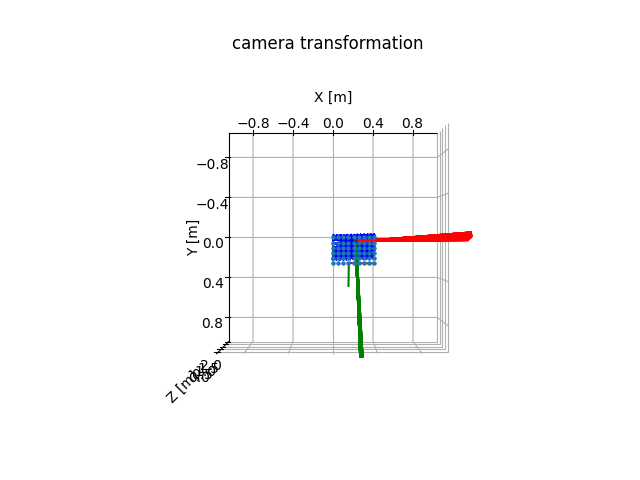

In [169]:
# Original Chessboard Origin Coordinate System

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot 3D Chess Points
for x,y,z in obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest[:3,:3], T_chest[:3,-1], s=0.2)
    
# Plot Right Poses
for T in T_right_list:
    ax = pr.plot_basis(ax, T[:3,:3], T[:3,-1], s=1.0)

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])

In [170]:
filt_df['T_right_eye'] = T_right_final_list

# Calculation of Roll, Pitch, Yaw

In [171]:
rmat = T_right_final_list[0][:3,:3]

In [172]:
angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
print(angles)

(3.721103233928638, -13.168882845446417, -3.5629019412508804)


In [173]:
angle_list = []
for i in range(14):
    rmat = T_right_final_list[i][:3,:3]
    angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
    angle_list.append(angles)
angle_arr = np.array(angle_list)

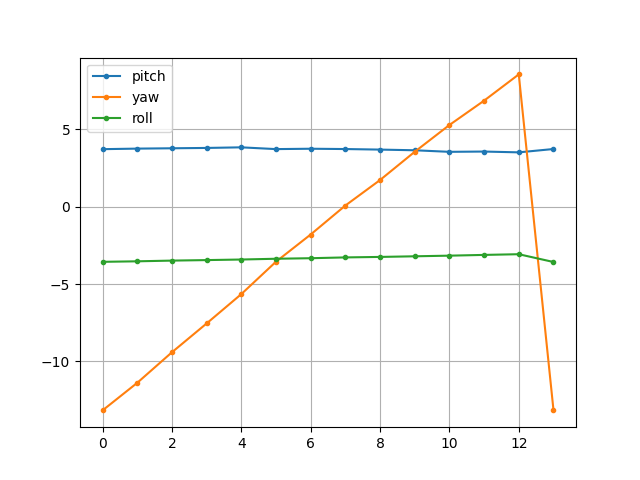

In [174]:
plt.figure()
plt.plot(angle_arr[:,0], marker='.')
plt.plot(angle_arr[:,1], marker='.')
plt.plot(angle_arr[:,2], marker='.')
plt.legend(['pitch', 'yaw', 'roll'])  # Rotation across z, y, x [but currently in opencv coordinates -> different]
plt.grid()

In [175]:
angle_list

[(3.721103233928638, -13.168882845446417, -3.5629019412508804),
 (3.7567948949329453, -11.386462838293635, -3.5296591833715905),
 (3.778469377485631, -9.41167818006614, -3.483713870817356),
 (3.80047953029016, -7.548350124240351, -3.4507523414865773),
 (3.8392811490167467, -5.651297413199601, -3.4135625234580687),
 (3.7250947199844413, -3.555872888906313, -3.364216921589727),
 (3.7488881334215423, -1.7972253144315493, -3.3292611363445803),
 (3.728898316477378, 0.07545078594848793, -3.277452979997136),
 (3.693394442168462, 1.724340607617568, -3.2462421070049072),
 (3.649761168711813, 3.5514603608474364, -3.2053827806135637),
 (3.548883932571822, 5.282757496915329, -3.163993136704231),
 (3.5670808392117612, 6.8576927599489945, -3.115494988352182),
 (3.514669473658431, 8.555116504421635, -3.07068147711584),
 (3.7309325998150964, -13.131489621253847, -3.573914888054371)]

## Filter

In [176]:
angle_list = []
df = filt_df[filt_df['theta_right_pan_cmd_tminus1']==0.0].reset_index()
for i in range(len(df)):
    rmat = df['T_right_eye'][i][:3,:3]
    angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
    angle_list.append(angles)
angle_arr = np.array(angle_list)

In [177]:
angle_arr

array([[ 3.51466947,  8.5551165 , -3.07068148],
       [ 3.54469949,  8.50147595, -3.06118687],
       [ 3.51692815,  8.52882905, -3.07134408],
       [ 3.50577051,  8.5626806 , -3.08071807],
       [ 3.54081128,  8.57719018, -3.07376221],
       [ 3.53286414,  8.57065775, -3.08006019],
       [ 3.51069223,  8.57406101, -3.08172325],
       [ 3.51817541,  8.64847392, -3.08773121],
       [ 3.50968822,  8.55935216, -3.09224919],
       [ 3.45653682,  8.60793106, -3.09020394],
       [ 1.34826926,  8.55410253, -3.53297841],
       [ 1.34583171,  8.57754791, -3.53458254],
       [ 1.37662611,  8.5242628 , -3.53368928],
       [ 1.36882578,  8.53300399, -3.53761811],
       [ 1.34677638,  8.61023735, -3.53077121],
       [ 1.35296625,  8.49194218, -3.54634025],
       [ 1.36937248,  8.5739656 , -3.5351684 ],
       [ 1.36191172,  8.60690567, -3.53665773],
       [ 1.37107435,  8.56956676, -3.53714594],
       [ 1.3751206 ,  8.56091234, -3.53448988],
       [-0.81988948,  8.51450546, -3.992

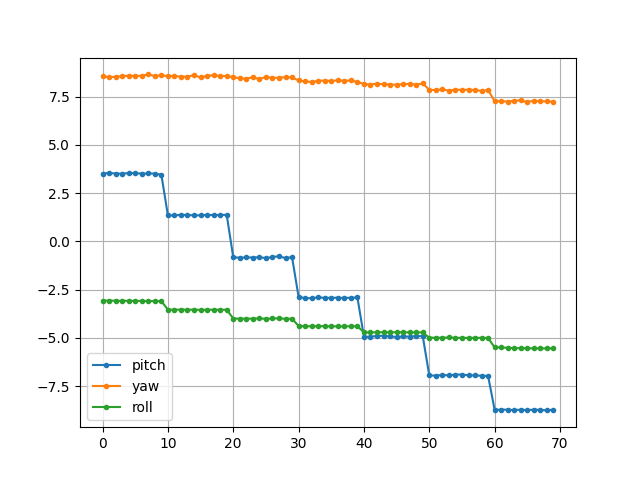

In [178]:
plt.figure()
plt.plot(angle_arr[:,0], marker='.')  # Right hand coordinate, clockwise is positive
plt.plot(angle_arr[:,1], marker='.')
plt.plot(angle_arr[:,2], marker='.')
plt.legend(['pitch', 'yaw', 'roll'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.grid()

## Scatter Plot All

In [179]:
pitch_list = []
yaw_list = []
roll_list = []
for i in range(len(filt_df)):
    rmat = filt_df['T_right_eye'][i][:3,:3]
    angles, mtxR, mtxQ, Qx, Qy, Qz = cv2.RQDecomp3x3(rmat)
    pitch_list.append(angles[0])
    yaw_list.append(angles[1])
    roll_list.append(angles[2])
filt_df['pitch'] = pitch_list
filt_df['yaw'] = yaw_list
filt_df['roll'] = roll_list

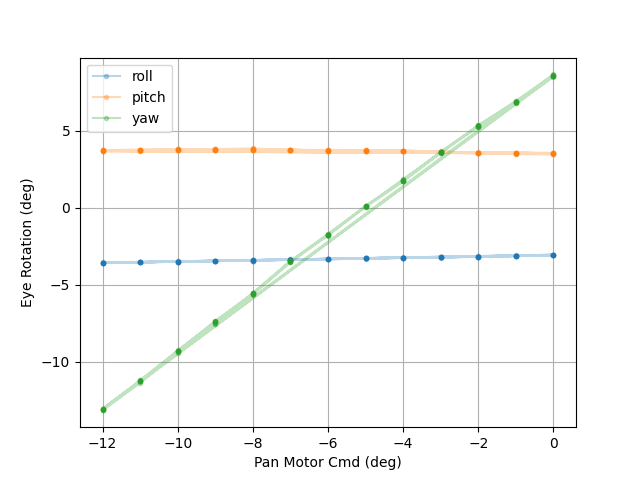

In [180]:
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==0.0].reset_index()
plt.figure()
plt.plot(df['theta_right_pan_cmd_tminus1'], df['roll'], alpha=0.3, marker='.')
plt.plot(df['theta_right_pan_cmd_tminus1'], df['pitch'], alpha=0.3, marker='.')
plt.plot(df['theta_right_pan_cmd_tminus1'], df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Pan Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

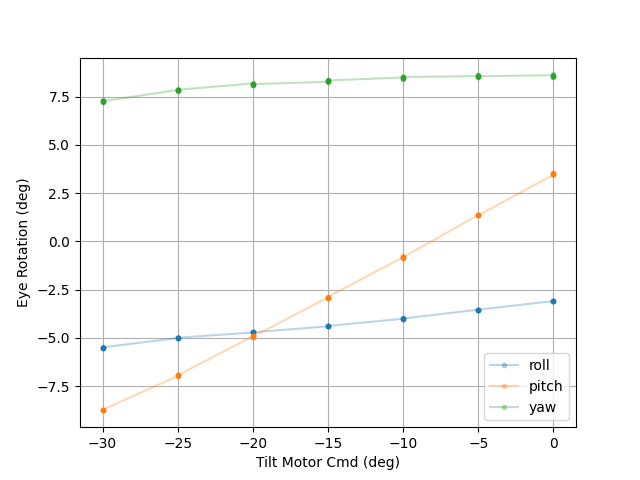

In [181]:
df = filt_df[filt_df['theta_right_pan_cmd_tminus1']==0.0].reset_index()
plt.figure()
plt.plot(df['theta_tilt_cmd_tminus1'], df['roll'], alpha=0.3, marker='.')
plt.plot(df['theta_tilt_cmd_tminus1'], df['pitch'], alpha=0.3, marker='.')
plt.plot(df['theta_tilt_cmd_tminus1'], df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

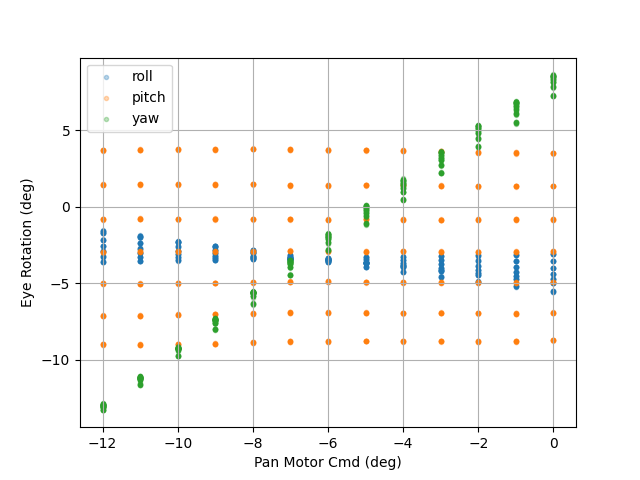

In [182]:
plt.figure()
plt.scatter(filt_df['theta_right_pan_cmd_tminus1'], filt_df['roll'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_right_pan_cmd_tminus1'], filt_df['pitch'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_right_pan_cmd_tminus1'], filt_df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Pan Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

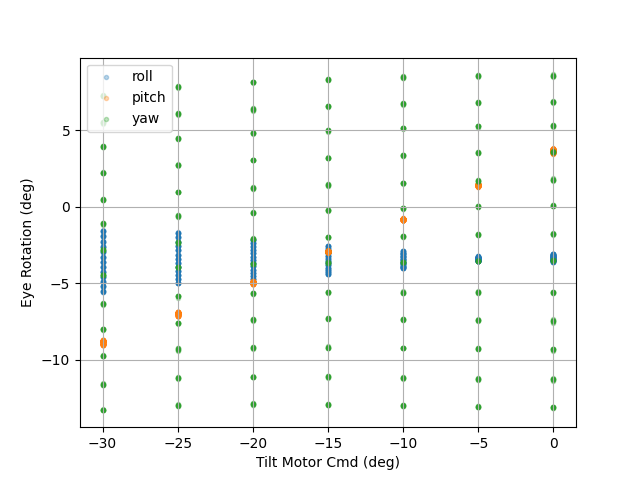

In [183]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['roll'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['pitch'], alpha=0.3, marker='.')
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['yaw'], alpha=0.3, marker='.')
plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('Eye Rotation (deg)')
plt.grid()

# Pan Slope Plot

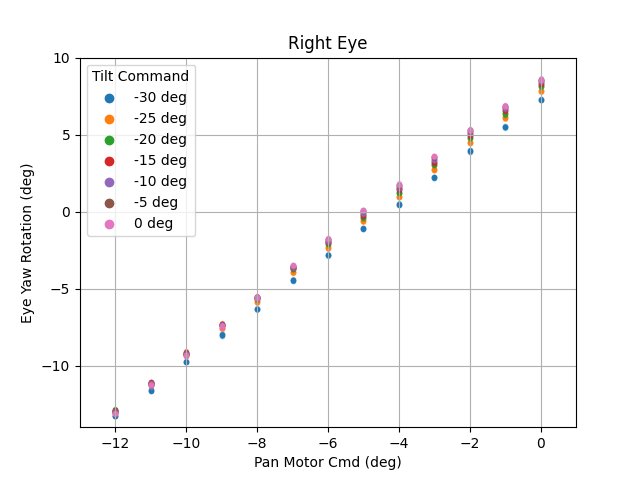

In [184]:
# Pan Slope

plt.figure()

tilt_cmd_list = list(range(-30, 1, 5))
for i in range(len(tilt_cmd_list)):
    plt.scatter(-100,-100, color=colors[i])

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    plt.scatter(df['theta_right_pan_cmd_tminus1'], df['yaw'], alpha=0.3, marker='.', color=colors[i])

# plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Pan Motor Cmd (deg)')
plt.ylabel('Eye Yaw Rotation (deg)')
plt.xlim([-13, 1])
plt.ylim([-14, 10])
plt.grid()
plt.title('Right Eye')
plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command')

## Slope Calculation

In [185]:
from sklearn.linear_model import LinearRegression

In [186]:
# Example
X = np.array([[1, 1], [1, 2], [2, 2], [2, 3]])
y = np.dot(X, np.array([1, 2])) + 3
reg = LinearRegression().fit(X, y)
print(reg.score(X, y))
print(reg.coef_)
print(reg.intercept_)
print(reg.predict(np.array([[3, 5]])))

1.0
[1. 2.]
3.0000000000000018
[16.]


In [187]:
score_list = []
coef_list = []
intercept_list = []
for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    X = df['theta_right_pan_cmd_tminus1'].values.reshape(-1,1)
    y = df['yaw'].values.reshape(-1,1)
    reg = LinearRegression().fit(X, y)
    score_list.append(reg.score(X, y))
    coef_list.append(reg.coef_.squeeze())
    intercept_list.append(reg.intercept_)    

In [188]:
coef_list

[array(1.70973367),
 array(1.72679791),
 array(1.74713917),
 array(1.76599627),
 array(1.79049822),
 array(1.80904556),
 array(1.81602689)]

In [189]:
intercept_list

[array([7.34076479]),
 array([7.92583513]),
 array([8.26380559]),
 array([8.48403028]),
 array([8.68619412]),
 array([8.85575595]),
 array([8.90711418])]

In [190]:
tilt_cmd_list

[-30, -25, -20, -15, -10, -5, 0]

Text(0, 0.5, 'm_rpan (yaw/cmd)')

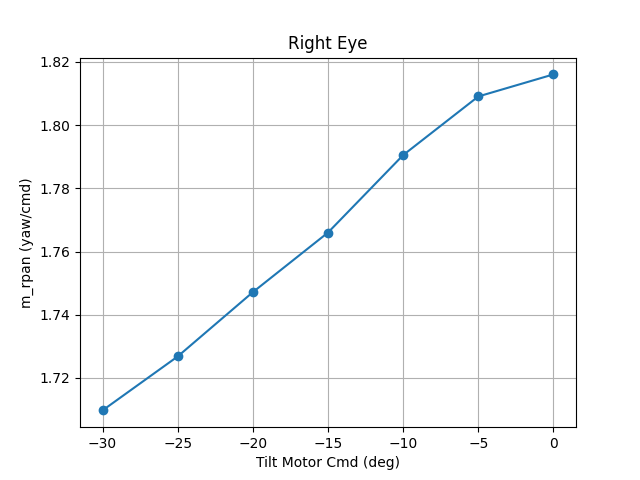

In [191]:
plt.figure()
plt.plot(tilt_cmd_list, coef_list, marker='o')
plt.title('Right Eye')
plt.grid()
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('m_rpan (yaw/cmd)')

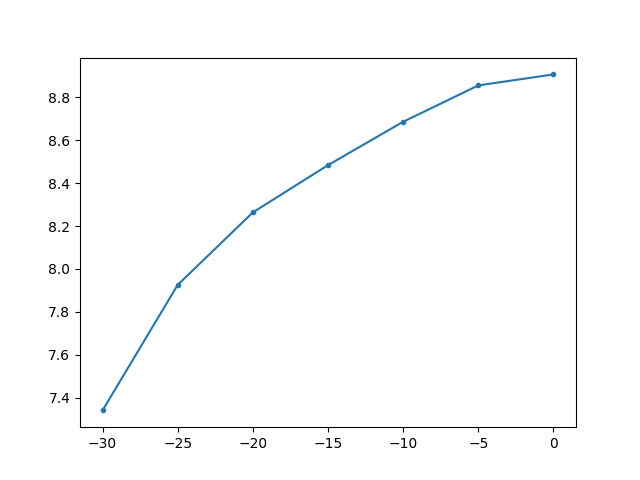

In [192]:
plt.figure()
plt.plot(tilt_cmd_list, intercept_list, marker='.')

# Tilt Slope Plot

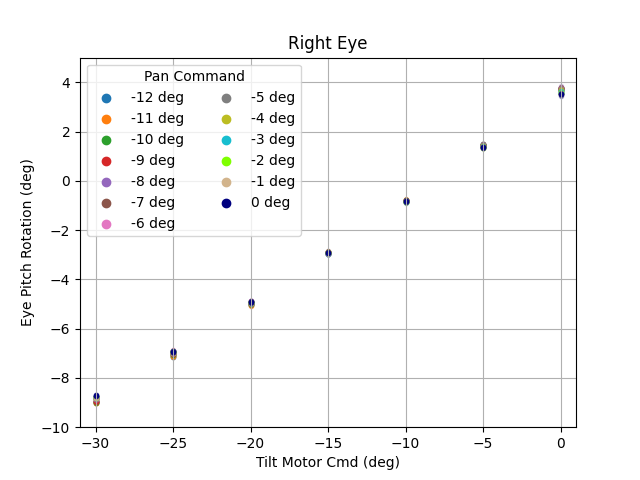

In [193]:
# Tilt Slope

plt.figure()

right_pan_cmd_list = list(range(-12, 1))
for i in range(len(right_pan_cmd_list)):
    plt.scatter(-100,-100, color=colors[i])

for i in range(len(right_pan_cmd_list)):
    df = filt_df[filt_df['theta_right_pan_cmd_tminus1']==right_pan_cmd_list[i]].reset_index()
    plt.scatter(df['theta_tilt_cmd_tminus1'], df['pitch'], alpha=0.3, marker='.', color=colors[i])
    
# plt.legend(['roll', 'pitch', 'yaw'])  # Rotation across z, y, x [but currently in opencv coordinates]
plt.xlabel('Tilt Motor Cmd (deg)')
plt.ylabel('Eye Pitch Rotation (deg)')
plt.xlim([-31, 1])
plt.ylim([-10, 5])
plt.title('Right Eye')
plt.legend(['-12 deg', '-11 deg', '-10 deg', '-9 deg', '-8 deg', '-7 deg', '-6 deg',
           '-5 deg', '-4 deg', '-3 deg', '-2 deg', '-1 deg', '0 deg'], title='Pan Command', ncol=2)
plt.grid()

## Slope Calculation

In [194]:
score_list = []
coef_list = []
intercept_list = []
for i in range(len(right_pan_cmd_list)):
    df = filt_df[filt_df['theta_right_pan_cmd_tminus1']==right_pan_cmd_list[i]].reset_index()
    X = df['theta_tilt_cmd_tminus1'].values.reshape(-1,1)
    y = df['pitch'].values.reshape(-1,1)
    reg = LinearRegression().fit(X, y)
    score_list.append(reg.score(X, y))
    coef_list.append(reg.coef_.squeeze())
    intercept_list.append(reg.intercept_)    

In [195]:
coef_list

[array(0.42419384),
 array(0.42565225),
 array(0.42456451),
 array(0.42293525),
 array(0.42091384),
 array(0.41683634),
 array(0.4155182),
 array(0.41611106),
 array(0.41567786),
 array(0.41368764),
 array(0.41239856),
 array(0.41245336),
 array(0.40995002)]

In [196]:
intercept_list

[array([3.53875152]),
 array([3.57332105]),
 array([3.58199985]),
 array([3.56360883]),
 array([3.56063491]),
 array([3.51270413]),
 array([3.48167722]),
 array([3.49356098]),
 array([3.4733282]),
 array([3.42329551]),
 array([3.39124544]),
 array([3.38640043]),
 array([3.37237935])]

In [197]:
right_pan_cmd_list

[-12, -11, -10, -9, -8, -7, -6, -5, -4, -3, -2, -1, 0]

(0.0, 1.0)

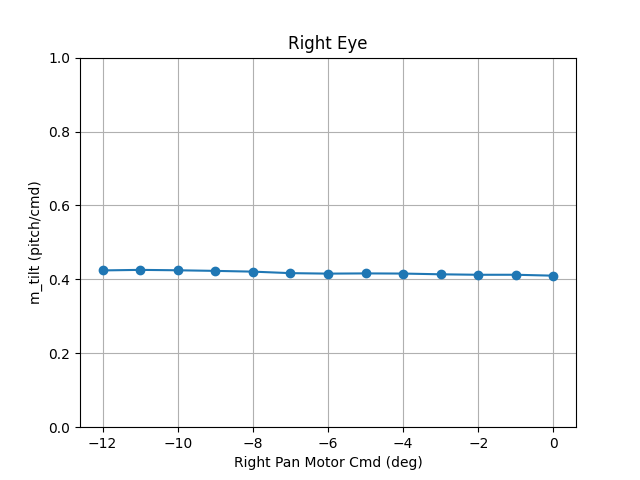

In [198]:
plt.figure()
plt.plot(right_pan_cmd_list, coef_list, marker='o')
plt.title('Right Eye')
plt.grid()
plt.xlabel('Right Pan Motor Cmd (deg)')
plt.ylabel('m_tilt (pitch/cmd)')
plt.ylim([0,1])

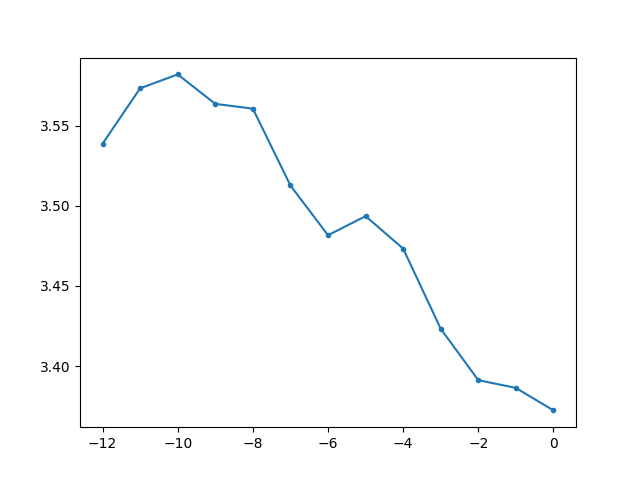

In [199]:
plt.figure()
plt.plot(right_pan_cmd_list, intercept_list, marker='.')

# Translation

In [200]:
t_x_list = []
t_y_list = []
t_z_list = []
for i in range(len(filt_df)):
    tvec = filt_df['T_right_eye'][i][:3,-1]
    t_x_list.append(tvec[0])
    t_y_list.append(tvec[1])
    t_z_list.append(tvec[2])
filt_df['t_x_list'] = t_x_list
filt_df['t_y_list'] = t_y_list
filt_df['t_z_list'] = t_z_list

In [201]:
df[['theta_right_pan', 't_x_list']][:18]

,theta_right_pan,t_x_list
0,0.351562,-0.037945
1,0.351562,-0.037455
2,0.263672,-0.037661
3,0.351562,-0.037535
4,0.351562,-0.037733
5,0.351562,-0.037484
6,0.351562,-0.037941
7,0.351562,-0.037657
8,0.351562,-0.037642
9,0.351562,-0.037979


Text(0.5, 1.0, 'Right Eye')

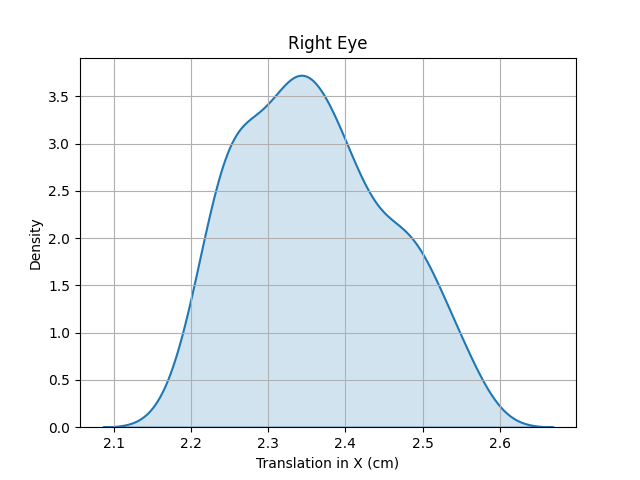

In [202]:
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==-20].reset_index()
# Showing the whole plot
plt.figure()
sns.kdeplot(100*df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in X (cm)')
plt.title('Right Eye')

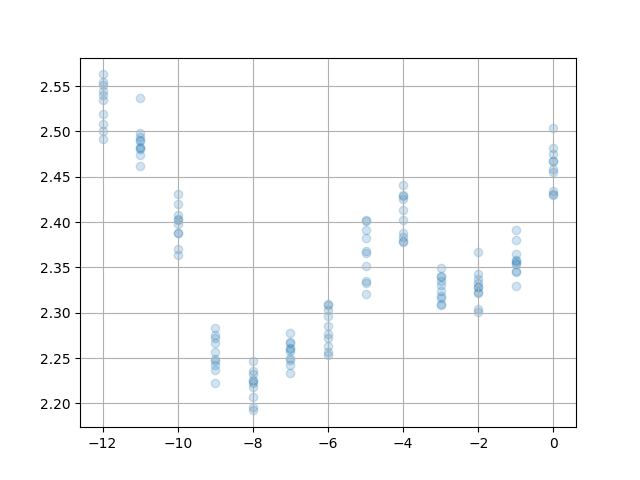

In [203]:
plt.figure()
plt.scatter(df['theta_right_pan_cmd_tminus1'], 100*df['t_x_list'], alpha=0.2)
plt.grid()

(-0.1, 0.1)

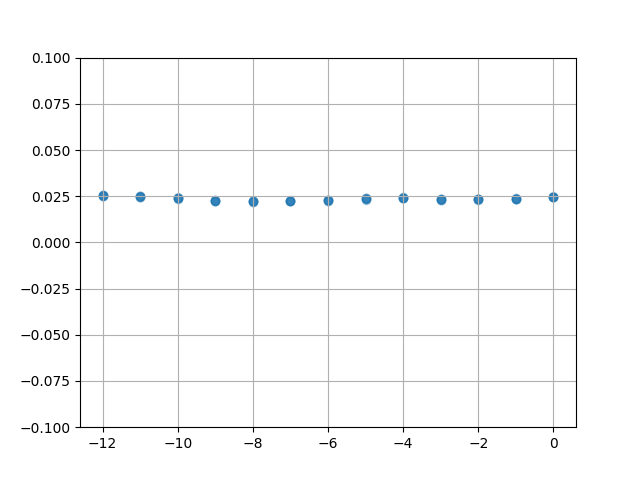

In [204]:
plt.figure()
plt.scatter(df['theta_right_pan_cmd_tminus1'], df['t_x_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1,0.1])

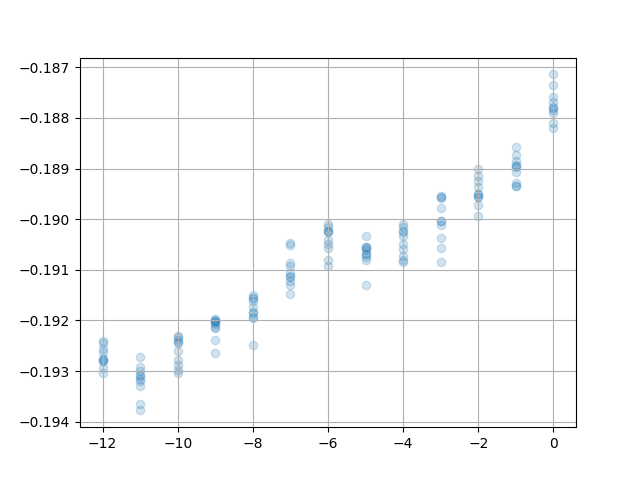

In [205]:
plt.figure()
plt.scatter(df['theta_right_pan_cmd_tminus1'], df['t_y_list'], alpha=0.2)
plt.grid()

(-0.3, -0.1)

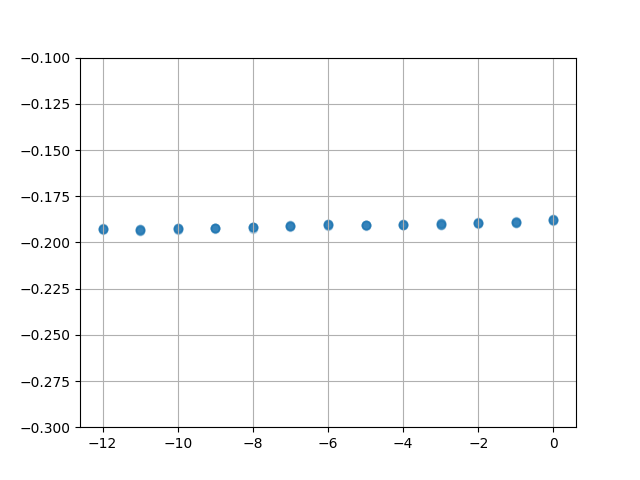

In [206]:
plt.figure()
plt.scatter(df['theta_right_pan_cmd_tminus1'], df['t_y_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.3,-0.1])

(-0.1, 0.1)

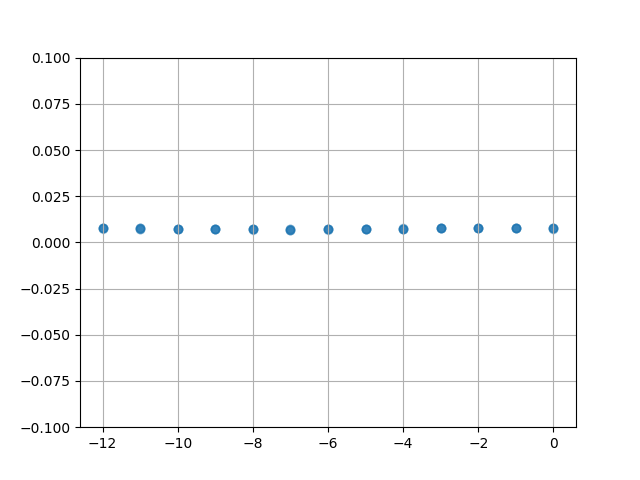

In [207]:
plt.figure()
plt.scatter(df['theta_right_pan_cmd_tminus1'], df['t_z_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1, 0.1])

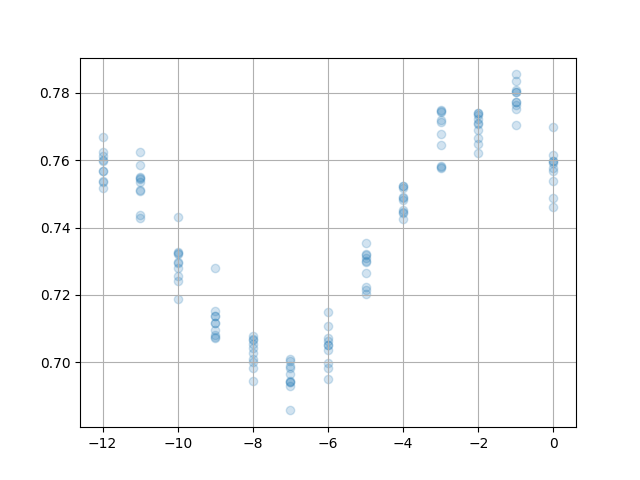

In [208]:
plt.figure()
plt.scatter(df['theta_right_pan_cmd_tminus1'], 100*df['t_z_list'], alpha=0.2)
plt.grid()

## Pan Translation

(-0.1, 0.1)

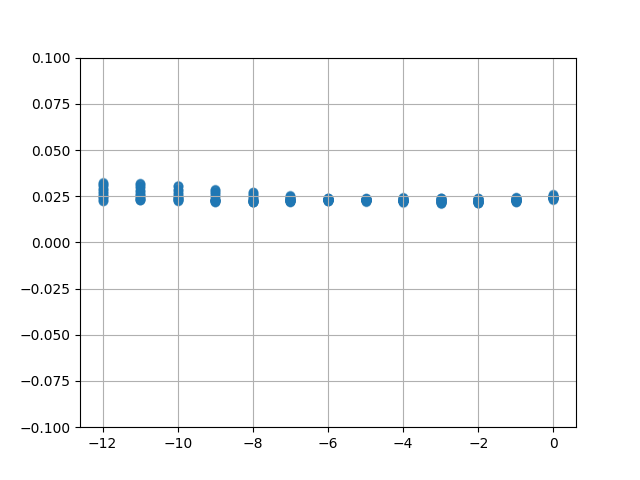

In [209]:
plt.figure()
plt.scatter(filt_df['theta_right_pan_cmd_tminus1'], filt_df['t_x_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1,0.1])

(-0.25, -0.15)

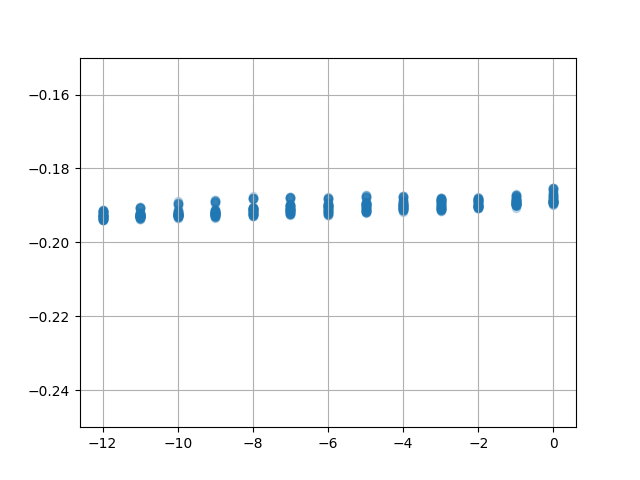

In [210]:
plt.figure()
plt.scatter(filt_df['theta_right_pan_cmd_tminus1'], filt_df['t_y_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.25,-0.15])

(-0.1, 0.1)

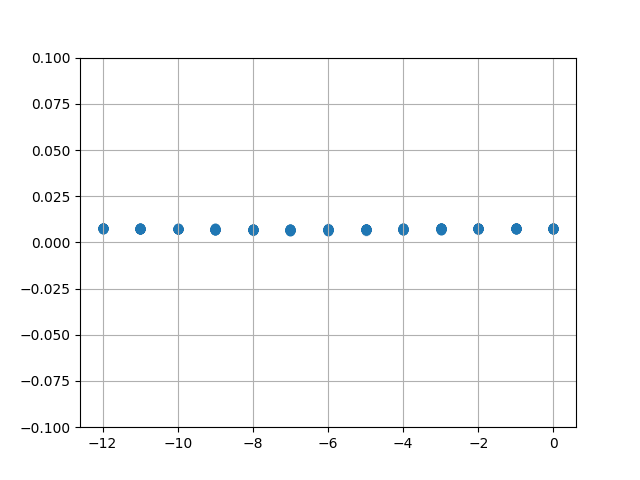

In [211]:
plt.figure()
plt.scatter(filt_df['theta_right_pan_cmd_tminus1'], filt_df['t_z_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1, 0.1])

Text(0.5, 1.0, 'Right Eye')

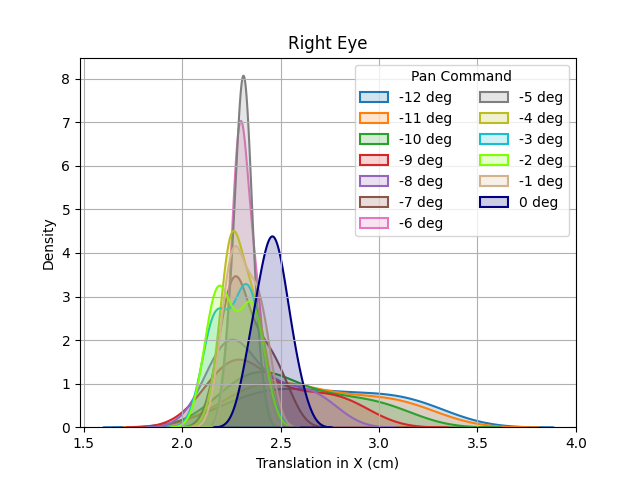

In [212]:
# Showing the whole plot
plt.figure()

for i in range(len(right_pan_cmd_list)):
    df = filt_df[filt_df['theta_right_pan_cmd_tminus1']==right_pan_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.5, color=colors[i])

plt.legend(['-12 deg', '-11 deg', '-10 deg', '-9 deg', '-8 deg', '-7 deg', '-6 deg',
           '-5 deg', '-4 deg', '-3 deg', '-2 deg', '-1 deg', '0 deg'], title='Pan Command', ncol=2)
plt.grid()
plt.xlabel('Translation in X (cm)')
plt.title('Right Eye')

Text(0.5, 1.0, 'Left Eye')

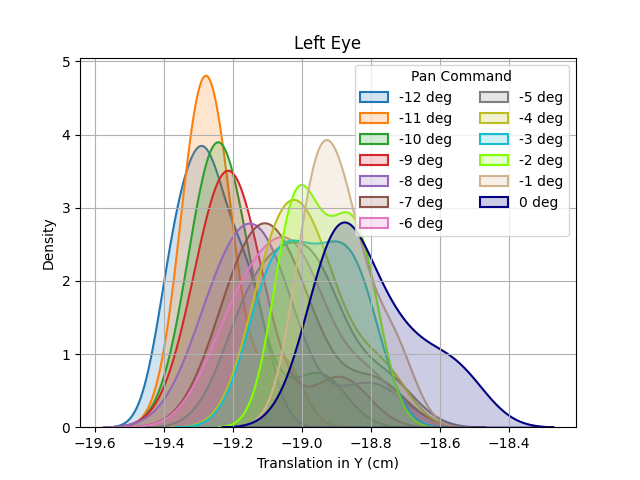

In [213]:
# Showing the whole plot
plt.figure()

for i in range(len(right_pan_cmd_list)):
    df = filt_df[filt_df['theta_right_pan_cmd_tminus1']==right_pan_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_y_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.5, color=colors[i])

plt.legend(['-12 deg', '-11 deg', '-10 deg', '-9 deg', '-8 deg', '-7 deg', '-6 deg',
           '-5 deg', '-4 deg', '-3 deg', '-2 deg', '-1 deg', '0 deg'], title='Pan Command', ncol=2)
plt.grid()
plt.xlabel('Translation in Y (cm)')
plt.title('Left Eye')

Text(0.5, 1.0, 'Right Eye')

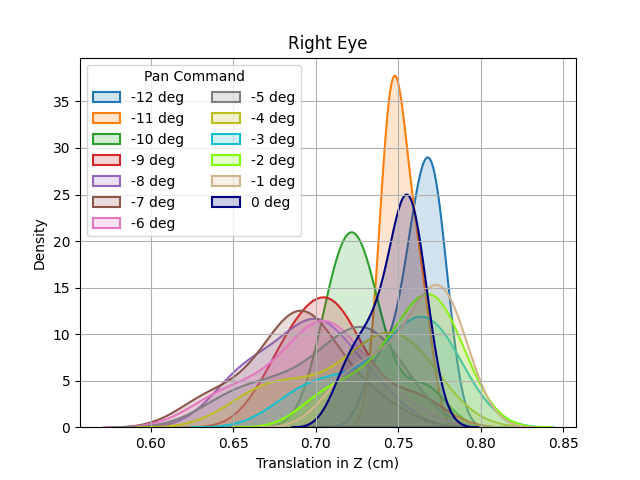

In [214]:
# Showing the whole plot
plt.figure()

for i in range(len(right_pan_cmd_list)):
    df = filt_df[filt_df['theta_right_pan_cmd_tminus1']==right_pan_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_z_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.5, color=colors[i])

plt.legend(['-12 deg', '-11 deg', '-10 deg', '-9 deg', '-8 deg', '-7 deg', '-6 deg',
           '-5 deg', '-4 deg', '-3 deg', '-2 deg', '-1 deg', '0 deg'], title='Pan Command', ncol=2, loc='upper left')
plt.grid()
plt.xlabel('Translation in Z (cm)')
plt.title('Right Eye')

Text(0.5, 1.0, 'Right Eye')

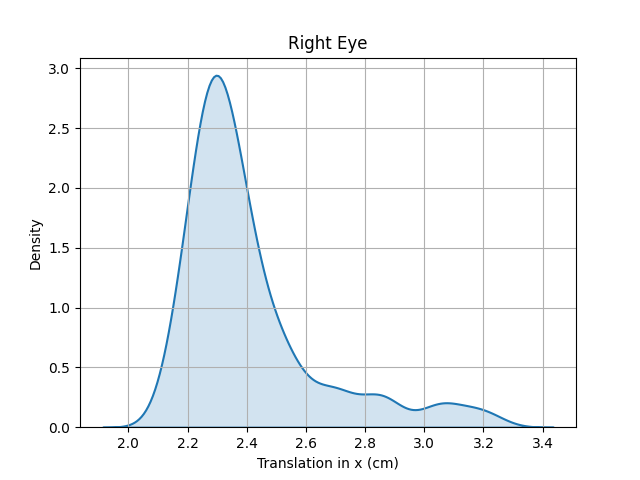

In [215]:
# Showing the whole plot
plt.figure()
sns.kdeplot(100*filt_df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in x (cm)')
plt.title('Right Eye')

Text(0.5, 1.0, 'Right Eye')

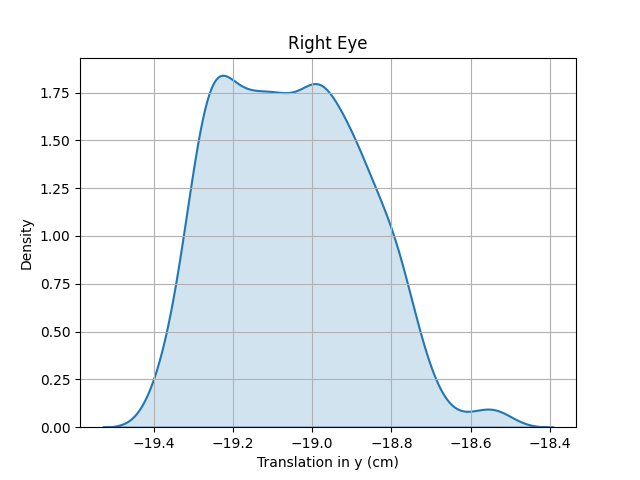

In [216]:
# Showing the whole plot
plt.figure()
sns.kdeplot(100*filt_df['t_y_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in y (cm)')
plt.title('Right Eye')

Text(0.5, 1.0, 'Right Eye')

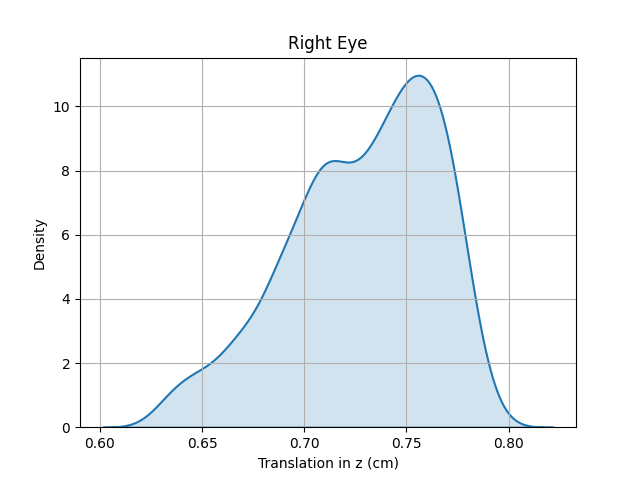

In [217]:
# Showing the whole plot
plt.figure()
sns.kdeplot(100*filt_df['t_z_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1)
plt.grid()
plt.xlabel('Translation in z (cm)')
plt.title('Right Eye')

## Tilt Translation

In [218]:
tilt_cmd_list

[-30, -25, -20, -15, -10, -5, 0]

Text(0.5, 1.0, 'Right Eye')

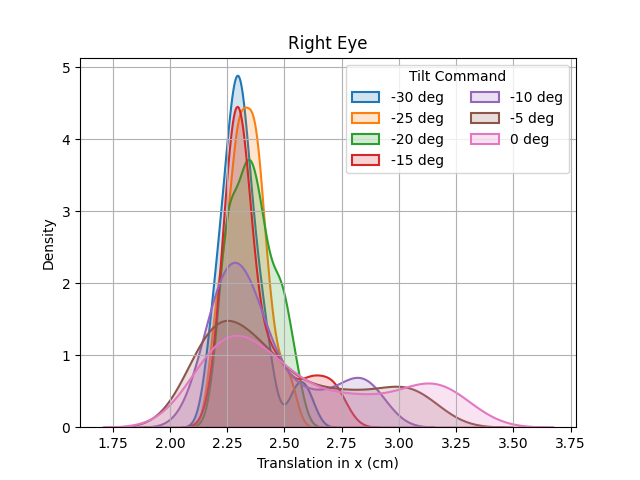

In [219]:
# Showing the whole plot
plt.figure()

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_x_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.0, color=colors[i])

plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command', ncol=2)
plt.grid()
plt.xlabel('Translation in x (cm)')
plt.title('Right Eye')

Text(0.5, 1.0, 'Right Eye')

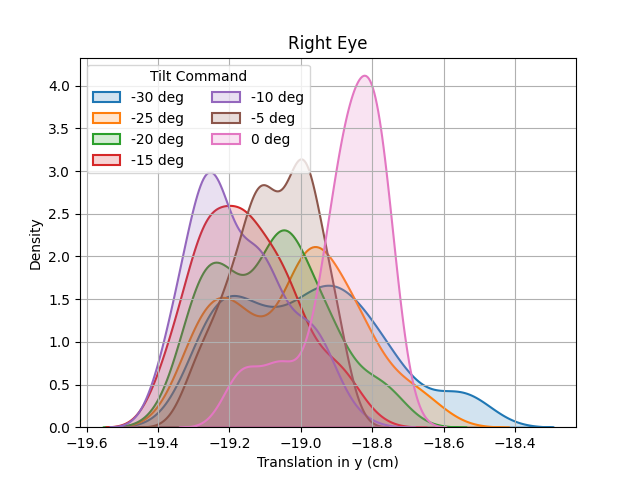

In [220]:
# Showing the whole plot
plt.figure()

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_y_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.0, color=colors[i])

plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command', ncol=2, loc='upper left')
plt.grid()
plt.xlabel('Translation in y (cm)')
plt.title('Right Eye')

Text(0.5, 1.0, 'Right Eye')

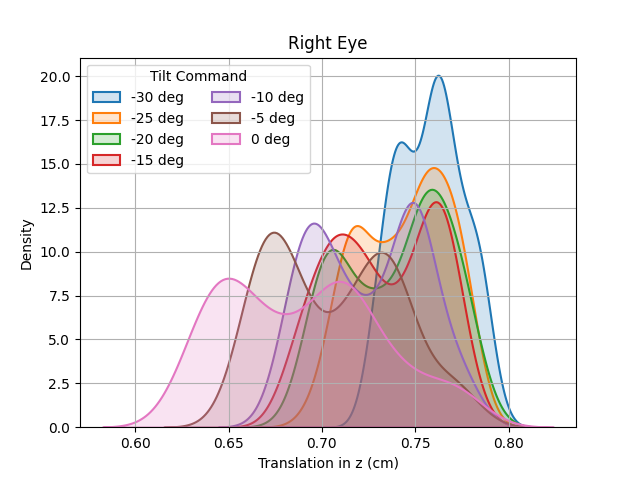

In [221]:
# Showing the whole plot
plt.figure()

for i in range(len(tilt_cmd_list)):
    df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[i]].reset_index()
    sns.kdeplot(100*df['t_z_list'], fill=True,alpha=.2, linewidth=1.5, bw_adjust=1.0, color=colors[i])

plt.legend(['-30 deg', '-25 deg', '-20 deg', '-15 deg', '-10 deg', '-5 deg', '0 deg'], title='Tilt Command', ncol=2, loc="upper left")
plt.grid()
plt.xlabel('Translation in z (cm)')
plt.title('Right Eye')

(-0.1, 0.1)

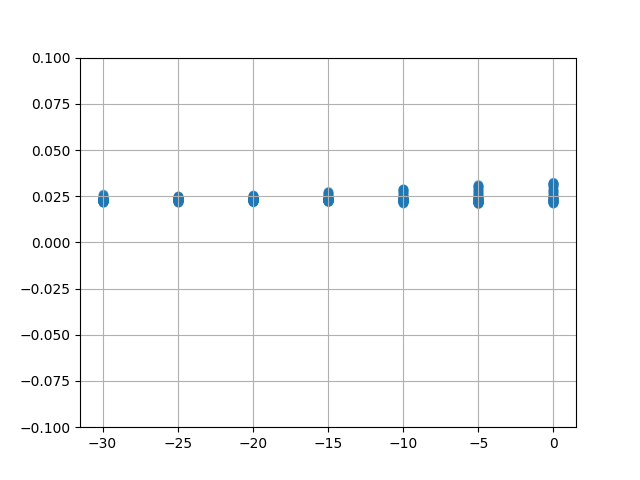

In [222]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['t_x_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1,0.1])

(-0.3, -0.1)

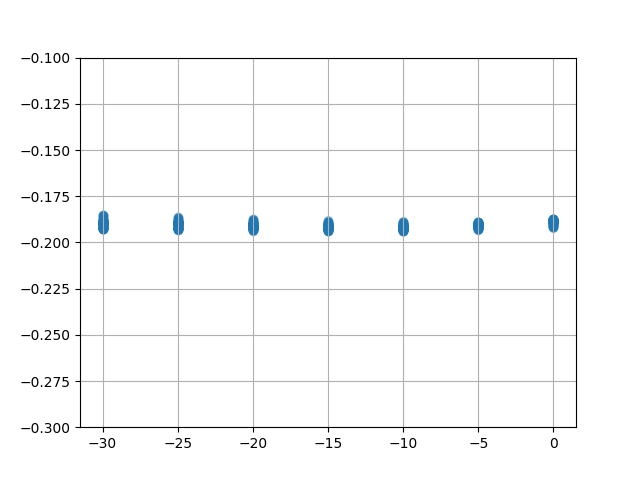

In [223]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['t_y_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.3,-0.1])

(-0.1, 0.1)

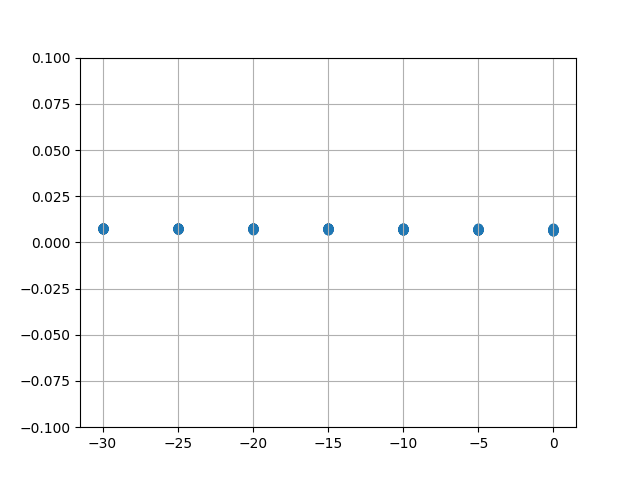

In [224]:
plt.figure()
plt.scatter(filt_df['theta_tilt_cmd_tminus1'], filt_df['t_z_list'], alpha=0.2)
plt.grid()
plt.ylim([-0.1, 0.1])

### Comparison

Text(0.5, 1.0, 'Right Eye')

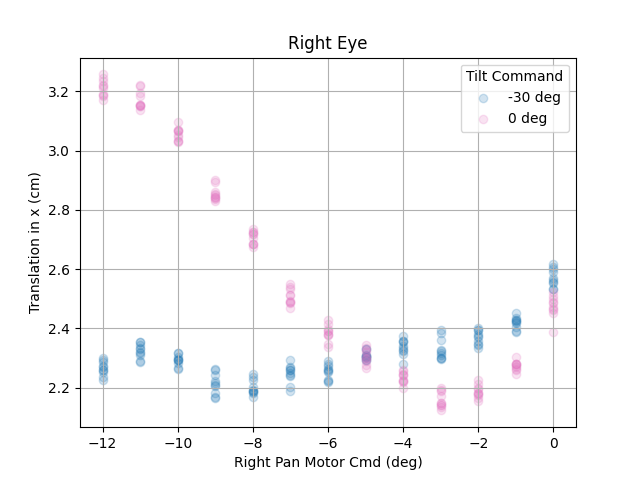

In [225]:
plt.figure()
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[0]].reset_index()
plt.scatter(df['theta_right_pan_cmd_tminus1'], 100*df['t_x_list'], alpha=0.2, color=colors[0])
df = filt_df[filt_df['theta_tilt_cmd_tminus1']==tilt_cmd_list[-1]].reset_index()
plt.scatter(df['theta_right_pan_cmd_tminus1'], 100*df['t_x_list'], alpha=0.2, color=colors[6])
plt.grid()
plt.legend(['-30 deg', '0 deg'], title='Tilt Command', loc="upper right")
plt.xlabel('Right Pan Motor Cmd (deg)')
plt.ylabel('Translation in x (cm)')
plt.title('Right Eye')

# Average Tilt Slope

In [226]:
np.mean(coef_list)

0.41776097899910586

In [227]:
(0.41776097899910586 + 0.4152537078639283)/2

0.4165073434315171

# Final Right Pose

In [228]:
right_df = filt_df[(filt_df['theta_tilt_cmd_tminus1']==0) 
                  & (filt_df['theta_right_pan_cmd_tminus1']==0)].reset_index()
right_zero_T = np.mean(right_df['T_right_eye'])
right_zero_T

array([[ 0.98741058,  0.06273284,  0.14520491,  0.0247449 ],
       [-0.05311269,  0.99618712, -0.06921057, -0.18887733],
       [-0.14899302,  0.06062696,  0.98697763,  0.00720258],
       [ 0.        ,  0.        ,  0.        ,  1.        ]])

In [229]:
np.mean(right_df['roll'])

-3.0789660503183

In [230]:
np.mean(right_df['pitch'])

3.5150835721551466

In [231]:
np.mean(right_df['yaw'])

8.56857681961835

# Final Plot

(-0.2, 2.0)

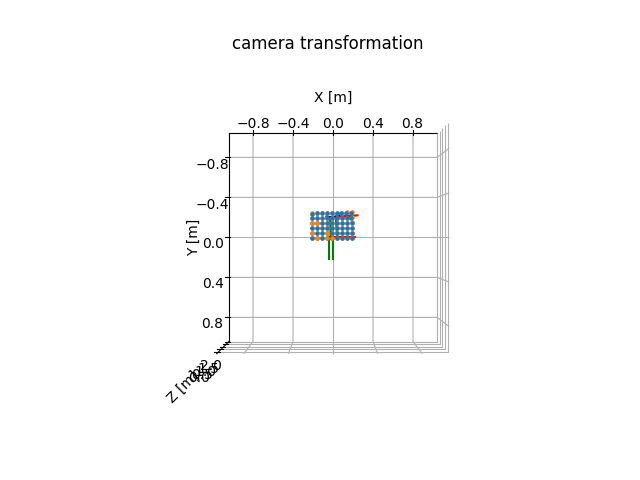

In [232]:
# Plotting the Depth Image Points

# Plot 3D Axes

plt.figure()
ax = make_3d_axis(1, 111, unit="m")

# Plot Origin
ax = pr.plot_basis(ax, s=0.2)

# Plot Chest Cam
ax = pr.plot_basis(ax, T_chest_cam_ctr[:3,:3], T_chest_cam_ctr[:3,-1], s=0.2)

# Plot Left Eye
ax = pr.plot_basis(ax, left_zero_T [:3,:3], left_zero_T [:3,-1], s=0.2)

# Plot Right Eye
ax = pr.plot_basis(ax, right_zero_T [:3,:3], right_zero_T [:3,-1], s=0.2)

# Plot 3D Chess Points
for x,y,z in final_obj_pts:
    ax.scatter(x, y, z, color=colors[0], marker='.')

# Plot 3D Depth Chess Points
for x,y,z in depth_obj_pts:
    ax.scatter(x-0.0325, y, z-0.0042, color=colors[1], marker='.')  # The 3d depth camera is still chest rgb

ax.view_init(elev=-90, azim=-90)
ax.set_title("camera transformation")

ax.set_zlim([-0.2, 2.0])